In [2]:
import os
import sys
import json
from torch.utils.tensorboard import SummaryWriter
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, datasets
from tqdm import tqdm

import torch.nn as nn
import torch

import matplotlib.pyplot as plt
import numpy as np

In [4]:
# Colab
# train_dir = r'/content/drive/MyDrive/cars_tanks/train'
# test_dir = r'/content/drive/MyDrive/cars_tanks/test'
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, in_channel, out_channel, stride=1, downsample=None, **kwargs):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=in_channel, out_channels=out_channel,
                               kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channel)
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv2d(in_channels=out_channel, out_channels=out_channel,
                               kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channel)
        self.downsample = downsample

    def forward(self, x):
        identity = x
        if self.downsample is not None:
            identity = self.downsample(x)

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        out += identity
        out = self.relu(out)

        return out

In [4]:
class Bottleneck(nn.Module):

    expansion = 4

    def __init__(self, in_channel, out_channel, stride=1, downsample=None,
                 groups=1, width_per_group=64):
        super(Bottleneck, self).__init__()

        width = int(out_channel * (width_per_group / 64.)) * groups

        self.conv1 = nn.Conv2d(in_channels=in_channel, out_channels=width,
                               kernel_size=1, stride=1, bias=False)  # squeeze channels
        self.bn1 = nn.BatchNorm2d(width)
        # -----------------------------------------
        self.conv2 = nn.Conv2d(in_channels=width, out_channels=width, groups=groups,
                               kernel_size=3, stride=stride, bias=False, padding=1)
        self.bn2 = nn.BatchNorm2d(width)
        # -----------------------------------------
        self.conv3 = nn.Conv2d(in_channels=width, out_channels=out_channel*self.expansion,
                               kernel_size=1, stride=1, bias=False)  # unsqueeze channels
        self.bn3 = nn.BatchNorm2d(out_channel*self.expansion)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample

    def forward(self, x):
        identity = x
        if self.downsample is not None:
            identity = self.downsample(x)

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        out += identity
        out = self.relu(out)

        return out

In [5]:
# CBAM Attention
class CBAMLayer(nn.Module):
    def __init__(self, channel, reduction=16, spatial_kernel=7):
        super(CBAMLayer, self).__init__()

        # channel attention Compress H, W to 1
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.avg_pool = nn.AdaptiveAvgPool2d(1)

        # shared MLP
        self.mlp = nn.Sequential(
            # Conv2d is more convienient the Linear
            # nn.Linear(channel, channel // reduction, bias=False)
            nn.Conv2d(channel, channel // reduction, 1, bias=False),
            # inplace=True  Direct replacement to save memory
            nn.ReLU(inplace=True),
            # nn.Linear(channel // reduction, channel,bias=False)
            nn.Conv2d(channel // reduction, channel, 1, bias=False)
        )

        # spatial attention
        self.conv = nn.Conv2d(2, 1, kernel_size=spatial_kernel,
                              padding=spatial_kernel // 2, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        max_out = self.mlp(self.max_pool(x))
        avg_out = self.mlp(self.avg_pool(x))
        channel_out = self.sigmoid(max_out + avg_out)
        x = channel_out * x

        max_out, _ = torch.max(x, dim=1, keepdim=True)
        avg_out = torch.mean(x, dim=1, keepdim=True)
        spatial_out = self.sigmoid(self.conv(torch.cat([max_out, avg_out], dim=1)))
        x = spatial_out * x
        return x

In [6]:
class tankCarCls(nn.Module):

    def __init__(self,
                 block,
                 blocks_num,
                 num_classes=1000,
                 include_top=True,
                 groups=1,
                 width_per_group=64):
        super(tankCarCls, self).__init__()
        self.include_top = include_top
        self.in_channel = 64

        self.groups = groups
        self.width_per_group = width_per_group

        self.conv1 = nn.Conv2d(3, self.in_channel, kernel_size=7, stride=2,
                               padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(self.in_channel)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(block, 64, blocks_num[0])
        self.layer2 = self._make_layer(block, 128, blocks_num[1], stride=2)
        self.layer3 = self._make_layer(block, 256, blocks_num[2], stride=2)
        self.layer4 = self._make_layer(block, 512, blocks_num[3], stride=2)
        if self.include_top:
            self.avgpool = nn.AdaptiveAvgPool2d((1, 1))  # output size = (1, 1)
            self.fc = nn.Linear(512 * block.expansion, num_classes)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

        self.channelAttention = CBAMLayer(64)

    def _make_layer(self, block, channel, block_num, stride=1):
        downsample = None
        if stride != 1 or self.in_channel != channel * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.in_channel, channel * block.expansion, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(channel * block.expansion))

        layers = []
        layers.append(block(self.in_channel,
                            channel,
                            downsample=downsample,
                            stride=stride,
                            groups=self.groups,
                            width_per_group=self.width_per_group))
        self.in_channel = channel * block.expansion

        for _ in range(1, block_num):
            layers.append(block(self.in_channel,
                                channel,
                                groups=self.groups,
                                width_per_group=self.width_per_group))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.channelAttention(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        if self.include_top:
            x = self.avgpool(x)
            x = torch.flatten(x, 1)
            x = self.fc(x)
        return x

In [7]:
def tankCarCls_v0(num_classes=2, include_top=True):
    return tankCarCls(Bottleneck, [3, 4, 6, 3], num_classes=num_classes, include_top=include_top)

In [13]:
def main():
    import os
    os.environ['CUDA_LAUNCH_BLOCKING'] = '1'  # Always reporting inconsistent shape errors

    device = torch.device("cuda:0")
    #device = torch.device("cpu")
    print("using {} device.".format(device))

    data_transform = {
        "train": transforms.Compose([transforms.RandomResizedCrop(224),
                                     transforms.RandomHorizontalFlip(),
                                     transforms.ToTensor(),
                                     transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])]),
        "val": transforms.Compose([transforms.Resize(256),
                                   transforms.CenterCrop(224),
                                   transforms.ToTensor(),
                                   transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])}

    data_root = os.path.abspath(os.path.join(os.getcwd(), "../.."))  # get data root path
    train_dataset = datasets.ImageFolder(root=os.path.join("cars_tanks/train"),
                                         transform=data_transform["train"])
    train_num = len(train_dataset)


    flower_list = train_dataset.class_to_idx
    cla_dict = dict((val, key) for key, val in flower_list.items())
    # write dict into json file
    json_str = json.dumps(cla_dict, indent=2)
    with open('class_indices.json', 'w') as json_file:
        json_file.write(json_str)

    batch_size = 4
    nw = 0  # number of workers
    print('Using {} dataloader workers every process'.format(nw))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                                               batch_size=batch_size, shuffle=True,
                                               num_workers=nw)

    validate_dataset = datasets.ImageFolder(root=os.path.join("cars_tanks/train"),
                                            transform=data_transform["val"])
    val_num = len(validate_dataset)
    validate_loader = torch.utils.data.DataLoader(validate_dataset,
                                                  batch_size=batch_size, shuffle=False,
                                                  num_workers=nw)

    print("using {} images for training, {} images for validation.".format(train_num,
                                                                           val_num))

    net = tankCarCls_v0()

    # change fc layer structure
    in_channel = net.fc.in_features
    net.fc = nn.Linear(in_channel, 2)
    net.to(device)

    # define loss function
    loss_function = nn.CrossEntropyLoss()

    # construct an optimizer
    params = [p for p in net.parameters() if p.requires_grad]
    optimizer = optim.Adam(params, lr=0.0001)

    epochs = 70
    best_acc = 0.0
    save_path = './tankCarCls_v1.pth'
    train_steps = len(train_loader)
    torch.cuda.empty_cache()
    writer = SummaryWriter("logs")

      #   writer.add_scalar("Accuracy-epoch", val_accurate, epoch+1)
      #   writer.add_scalar("loss-epoch", running_loss, epoch+1)
      #   writer.add_scalar("Precision-epoch", Precision, epoch+1)
      #   writer.add_scalar("Recall-epoch", Recall, epoch+1)
      #   writer.add_scalar("Precision-Recall", Precision, Recall)
      #   writer.add_scalar("F1-epoch", F1, epoch + 1)
      #   writer.add_scalar("Sensitivity-epoch", Sensitivity, epoch + 1)
      #   writer.add_scalar("Specificity-epoch", Specificity, epoch + 1)
      #   writer.add_scalar("Sensitivity-Specificity", Sensitivity, Specificity)
    AccuracyL = []
    lossL = []
    PrecisionL = []
    RecallL = []
    F1L = []
    SensitivityL = []
    SpecificityL = []
    ThreatL = []
    x = []
    for epoch in range(epochs):
        # train
        net.train()
        running_loss = 0.0
        train_bar = tqdm(train_loader, file=sys.stdout)
        for step, data in enumerate(train_bar):
            images, labels = data
            optimizer.zero_grad()
            logits = net(images.to(device))
            loss = loss_function(logits, labels.to(device))
            loss.backward()
            optimizer.step()

            # print statistics
            running_loss += loss.item()

            train_bar.desc = "train epoch[{}/{}] loss:{:.3f}".format(epoch + 1,
                                                                     epochs,
                                                                     loss)

        # validate
        net.eval()
        acc = 0.0  # accumulate accurate number / epoch
        TP = 0.0
        FP = 0.0
        FN = 0.0
        TN = 0.0

        with torch.no_grad():
            val_bar = tqdm(validate_loader, file=sys.stdout)
            for val_data in val_bar:
                val_images, val_labels = val_data
                outputs = net(val_images.to(device))
                # loss = loss_function(outputs, test_labels)
                predict_y = torch.max(outputs, dim=1)[1]


                acc += torch.eq(predict_y, val_labels.to(device)).sum().item()


                TP += (torch.eq(predict_y, val_labels.to(device)) & torch.eq(predict_y, 0)).sum().item()

                # 10
                FP += (torch.eq(predict_y, 1) & torch.eq(val_labels.to(device), 0)).sum().item()
                # 01
                FN += (torch.eq(predict_y, 0) & torch.eq(val_labels.to(device), 1)).sum().item()
                # 11
                TN += (torch.eq(predict_y, 1) & torch.eq(val_labels.to(device), 1)).sum().item()

                val_bar.desc = "valid epoch[{}/{}]".format(epoch + 1,
                                                           epochs)

        val_accurate = acc / val_num  #（TP+TN）/（TP+FP+TN+FN）
        # Precision=TP/（TP+FP）
        Precision = TP /(TP + FP)
        Recall = TP / (TP + FN)
        # Precision-recall
        # Confusion matrix
        F1 = 2 * (Precision * Recall) / (Precision + Recall)
        Sensitivity = TP / (TP + FN)
        Specificity = TN / (TN + FP)
        Threat = TP / (TP + FN + FP)
        
        print('[epoch %d] loss: %.3f  accuracy: %.3f  Precision: %.3f  Recall: %.3f  F1: %3f  Sensitivity: %.3f  Specificity: %.3f  Threat: %.3f'   %
              (epoch + 1, running_loss / train_steps, val_accurate,Precision,Recall, F1, Sensitivity, Specificity, Threat))

        writer.add_scalar("Accuracy-epoch", val_accurate, epoch+1)
        writer.add_scalar("loss-epoch", running_loss, epoch+1)
        writer.add_scalar("Precision-epoch", Precision, epoch+1)
        writer.add_scalar("Recall-epoch", Recall, epoch+1)
        writer.add_scalar("Precision-Recall", Precision, Recall)
        writer.add_scalar("F1-epoch", F1, epoch + 1)
        writer.add_scalar("Sensitivity-epoch", Sensitivity, epoch + 1)
        writer.add_scalar("Specificity-epoch", Specificity, epoch + 1)
        writer.add_scalar("Sensitivity-Specificity", Sensitivity, Specificity)
        writer.add_scalar("Threat-epoch", Threat, epoch + 1)
        
        AccuracyL.append(val_accurate)
        x.append(epoch)
        lossL.append(running_loss)
        PrecisionL.append(Precision)
        RecallL.append(Recall)
        F1L.append(F1)
        SensitivityL.append(Sensitivity)
        SpecificityL.append(Specificity)
        ThreatL.append(Threat)
#        import matplotlib.pyplot as plt

#        import numpy as np

        # AccuracyL = []
        y=AccuracyL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("Accuracy")
        plt.title("Accuracy-epoch")
        plt.show()

        # lossL = []
        y=lossL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("loss")
        plt.title("loss-epoch")
        plt.show()
        # PrecisionL = []
        y=PrecisionL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("Precision")
        plt.title("Precision-epoch")
        plt.show()
        # RecallL = []
        y=RecallL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("Recall")
        plt.title("Recall-epoch")
        # F1L = []
        y=F1L
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("F1")
        plt.title("F1-epoch")
        # SensitivityL = []
        y=SensitivityL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("Sensitivity")
        plt.title("Sensitivity-epoch")
        # SpecificityL = []
        y=SpecificityL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("Specificity")
        plt.title("Specificity-epoch")
        # ThreatL = []
        y=ThreatL
        plt.figure(figsize=(3,3))
        plt.plot(x,y)
        plt.xlabel("epoch")
        plt.ylabel("Threat")
        plt.title("Threat-epoch")
        
        # precision-recall = []
        y1=RecallL
        y2=PrecisionL
        plt.figure(figsize=(3,3))
        plt.plot(y2,y1)
        plt.xlabel("recall")
        plt.ylabel("precision")
        plt.title("precision-recall")
        
        # Sensitivity-Specificity = []
        y1=SpecificityL
        y2=SensitivityL
        plt.figure(figsize=(3,3))
        plt.plot(y1,y2)
        plt.xlabel("SpecificityL")
        plt.ylabel("SensitivityL")
        plt.title("Sensitivity-Specificity")

        if val_accurate > best_acc:
            best_acc = val_accurate
            torch.save(net.state_dict(), save_path)
    writer.close()
    print('Finished Training')

using cuda:0 device.
Using 0 dataloader workers every process
using 1303 images for training, 1303 images for validation.
valid epoch[1/70]: 100%|██████████| 326/326 [00:06<00:00, 49.51it/s]
[epoch 1] loss: 0.674  accuracy: 0.779  Precision: 0.790  Recall: 0.813  F1: 0.801379  Sensitivity: 0.813  Specificity: 0.738  Threat: 0.669


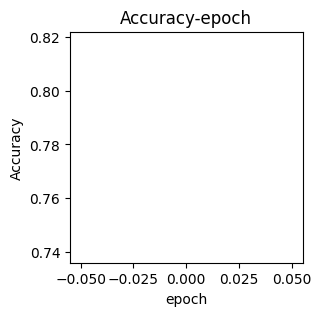

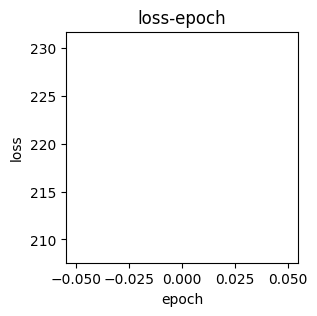

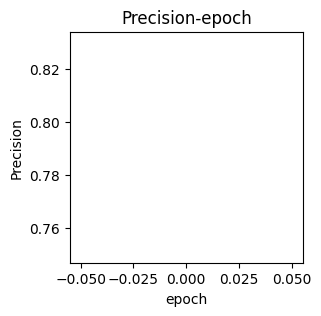

valid epoch[2/70]: 100%|██████████| 326/326 [00:06<00:00, 50.97it/s]
[epoch 2] loss: 0.604  accuracy: 0.729  Precision: 0.611  Recall: 0.870  F1: 0.717826  Sensitivity: 0.870  Specificity: 0.637  Threat: 0.560


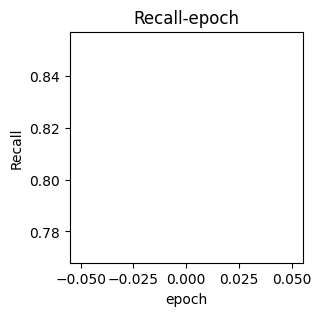

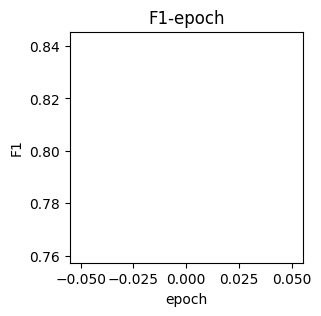

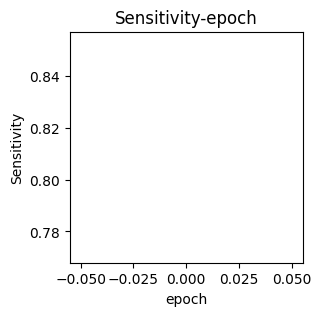

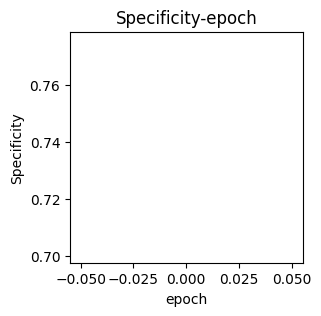

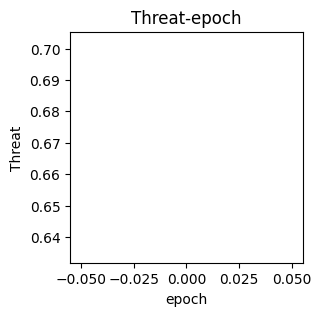

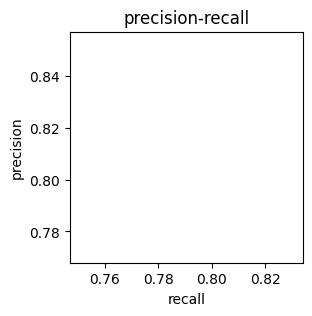

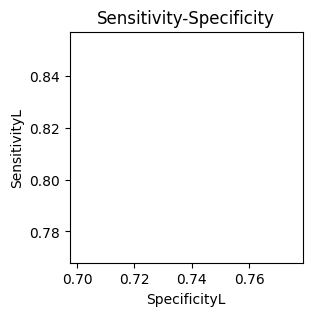

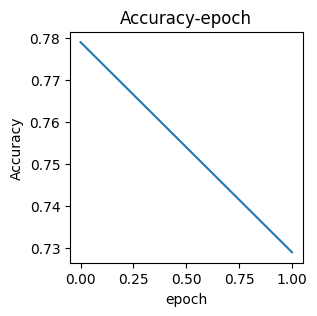

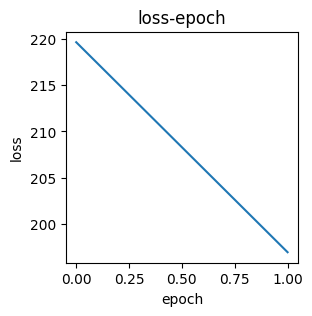

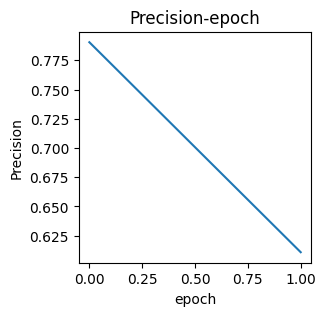

valid epoch[3/70]: 100%|██████████| 326/326 [00:06<00:00, 50.95it/s]
[epoch 3] loss: 0.575  accuracy: 0.760  Precision: 0.777  Recall: 0.793  F1: 0.784880  Sensitivity: 0.793  Specificity: 0.719  Threat: 0.646


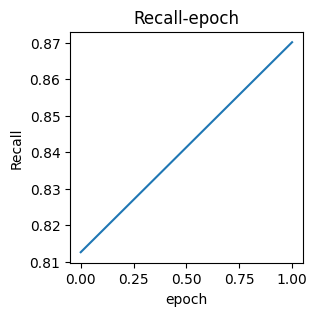

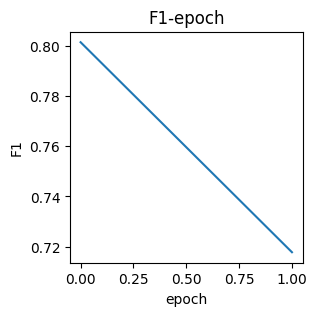

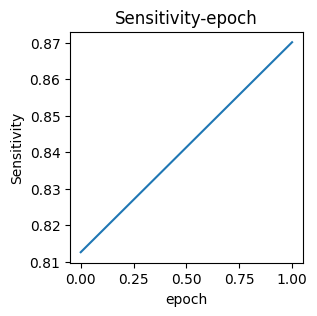

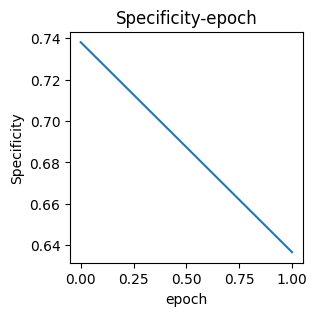

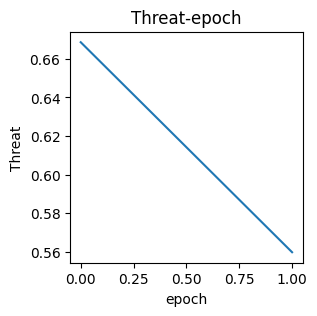

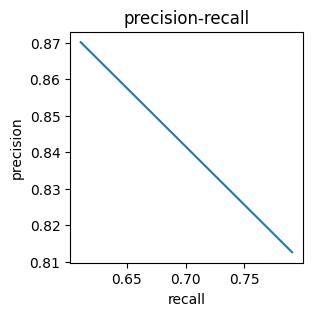

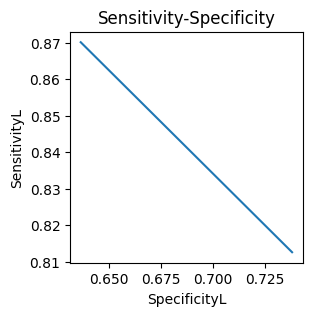

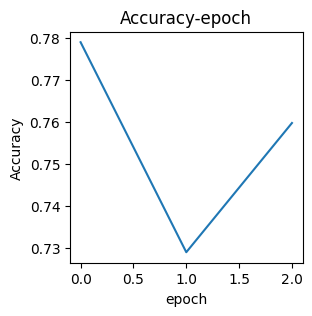

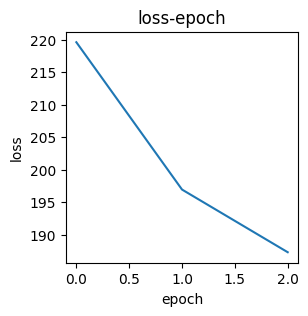

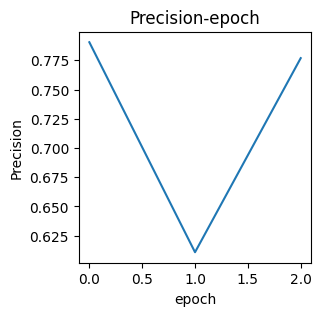

valid epoch[4/70]: 100%|██████████| 326/326 [00:06<00:00, 48.37it/s]
[epoch 4] loss: 0.569  accuracy: 0.763  Precision: 0.665  Recall: 0.886  F1: 0.759907  Sensitivity: 0.886  Specificity: 0.672  Threat: 0.613


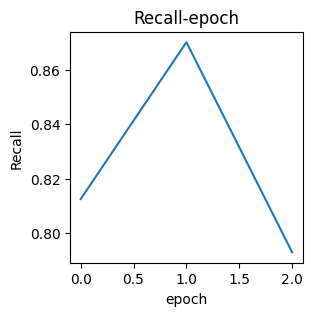

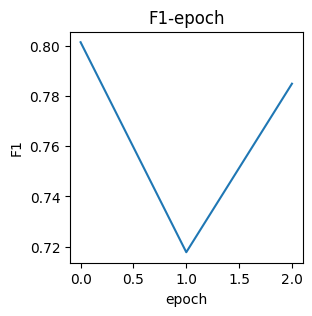

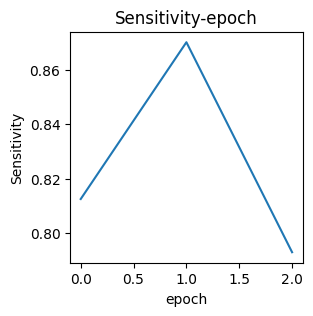

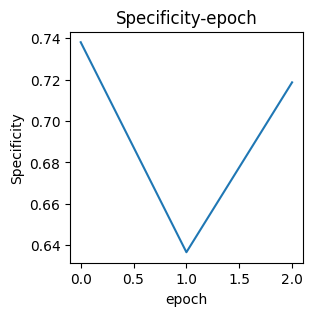

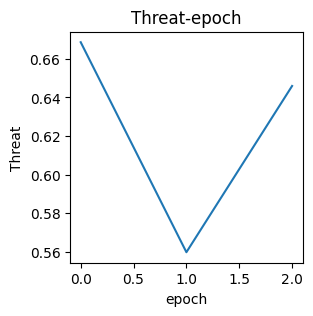

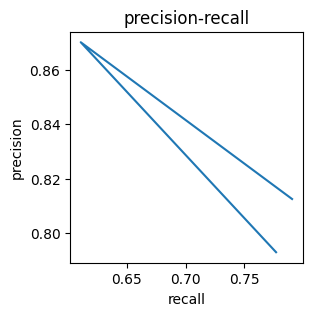

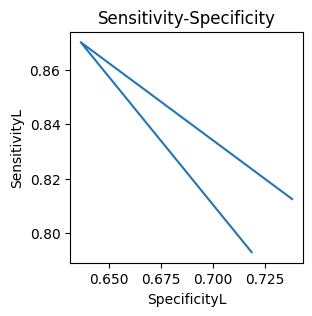

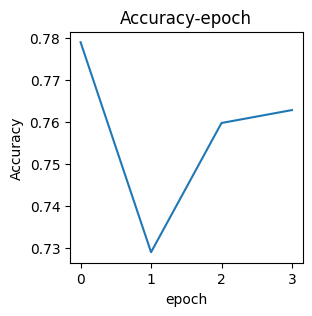

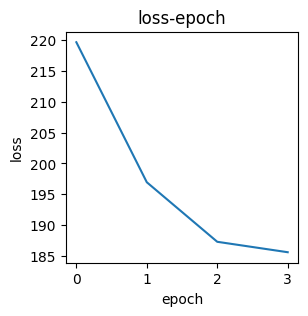

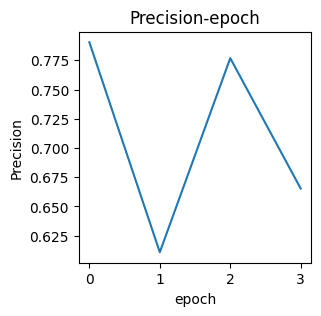

valid epoch[5/70]: 100%|██████████| 326/326 [00:06<00:00, 51.05it/s]
[epoch 5] loss: 0.535  accuracy: 0.790  Precision: 0.750  Recall: 0.860  F1: 0.800872  Sensitivity: 0.860  Specificity: 0.722  Threat: 0.668


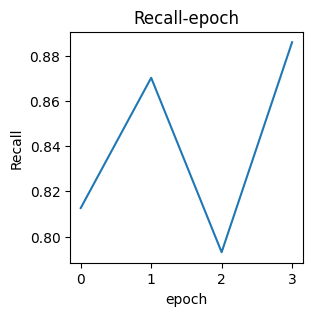

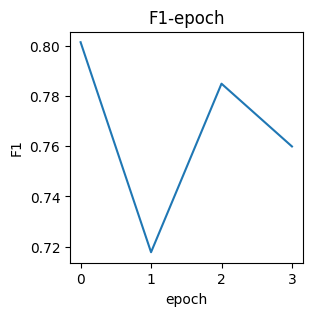

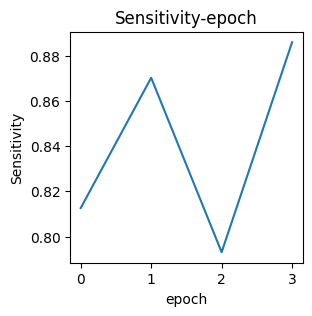

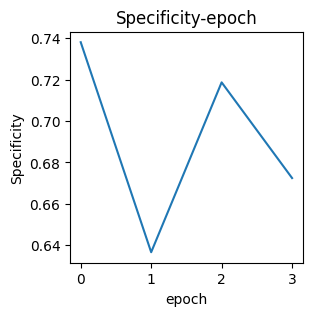

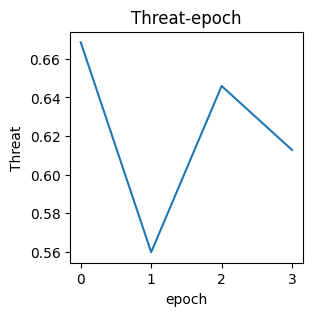

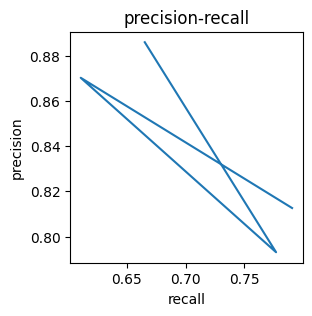

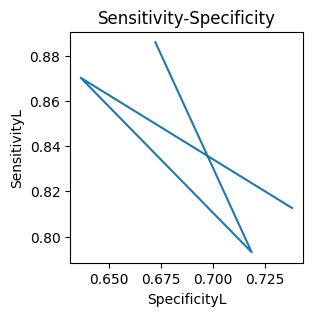

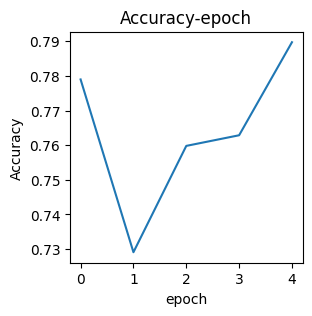

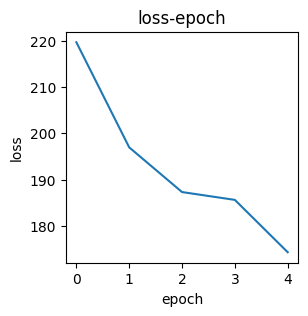

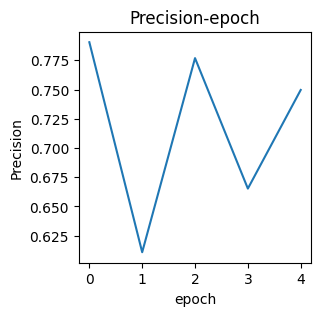

valid epoch[6/70]: 100%|██████████| 326/326 [00:06<00:00, 50.82it/s]
[epoch 6] loss: 0.555  accuracy: 0.824  Precision: 0.814  Recall: 0.867  F1: 0.839298  Sensitivity: 0.867  Specificity: 0.777  Threat: 0.723


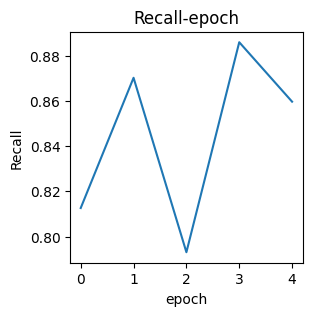

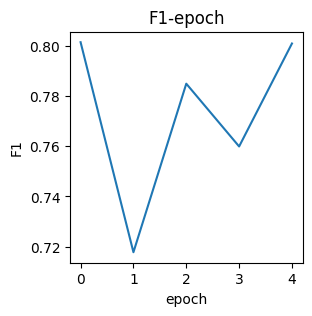

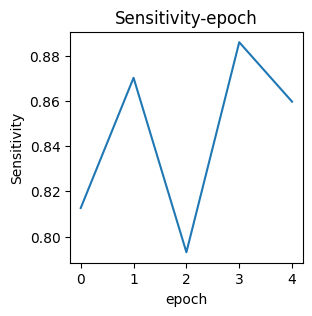

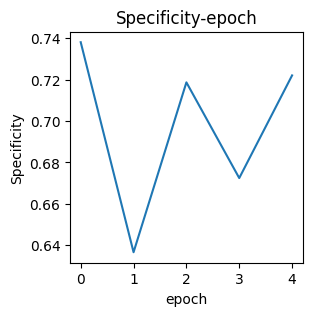

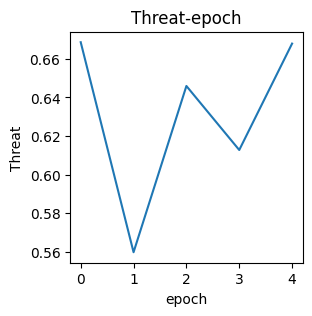

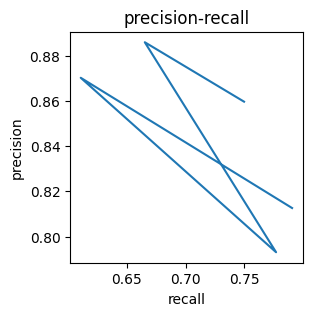

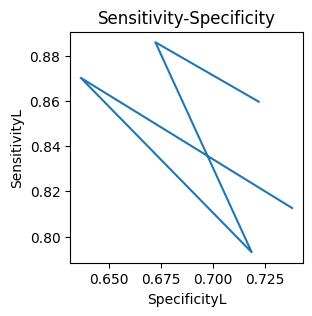

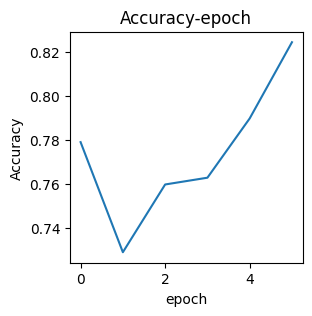

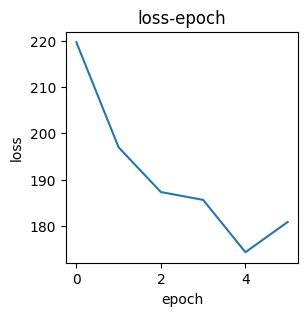

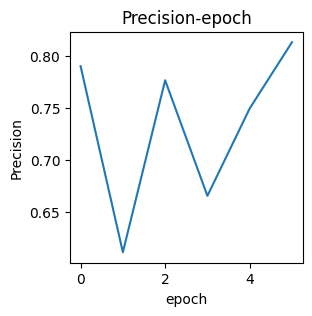

valid epoch[7/70]: 100%|██████████| 326/326 [00:06<00:00, 49.15it/s]
[epoch 7] loss: 0.507  accuracy: 0.788  Precision: 0.728  Recall: 0.876  F1: 0.794948  Sensitivity: 0.876  Specificity: 0.711  Threat: 0.660


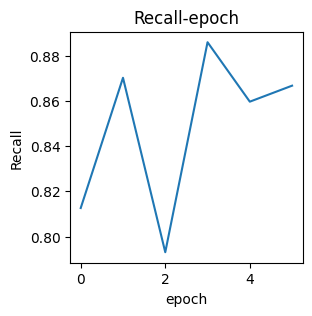

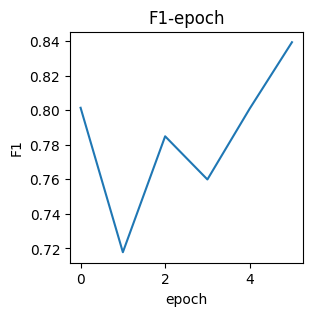

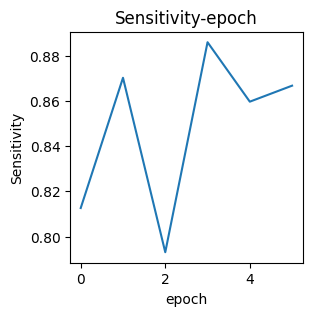

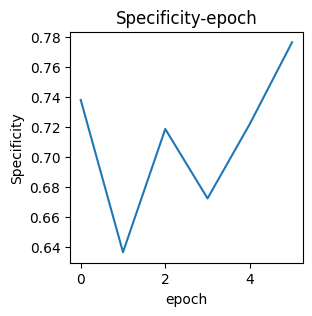

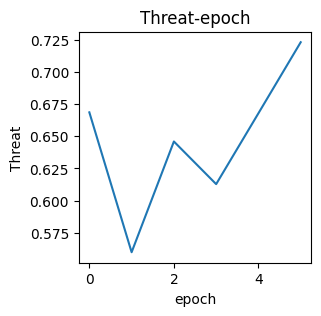

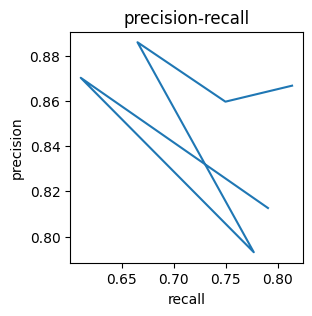

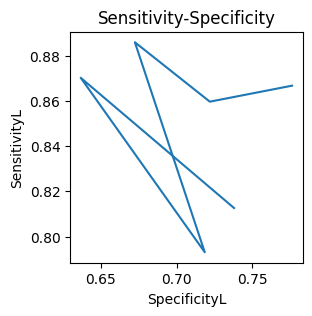

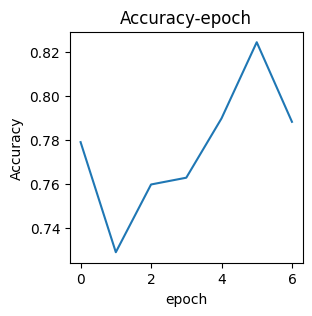

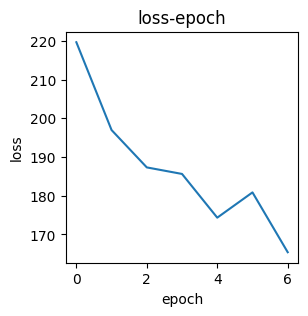

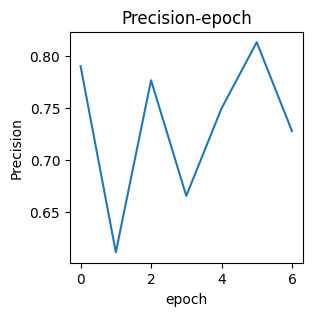

valid epoch[8/70]: 100%|██████████| 326/326 [00:06<00:00, 51.93it/s]
[epoch 8] loss: 0.503  accuracy: 0.783  Precision: 0.682  Recall: 0.911  F1: 0.779767  Sensitivity: 0.911  Specificity: 0.689  Threat: 0.639


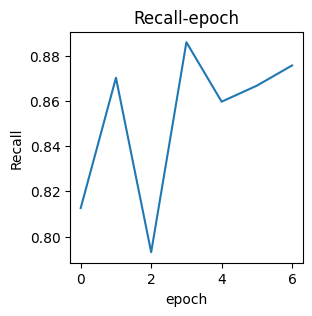

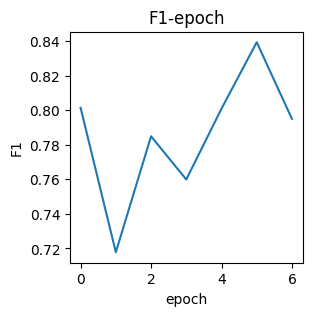

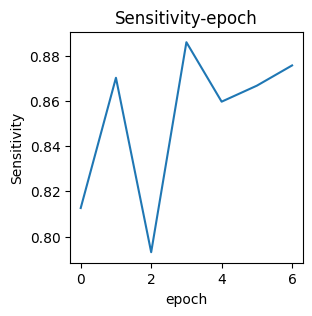

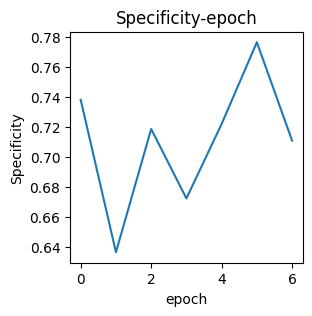

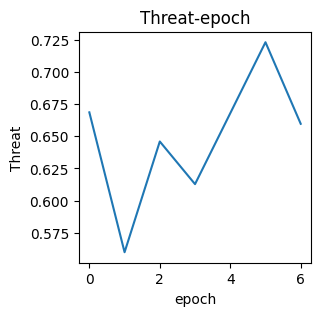

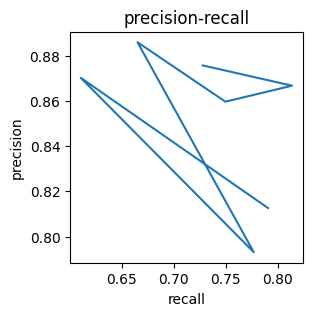

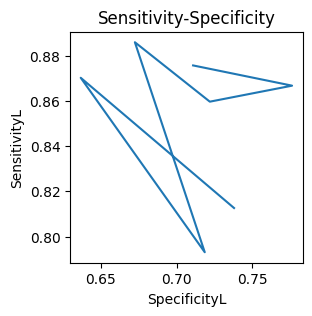

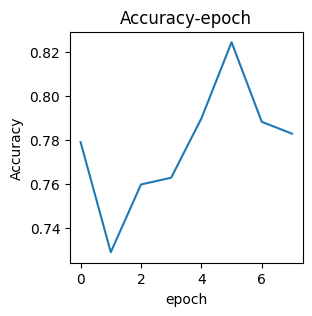

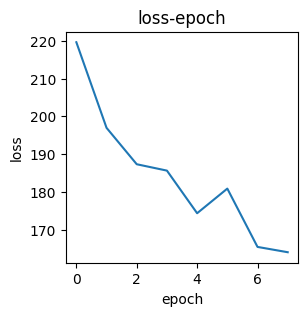

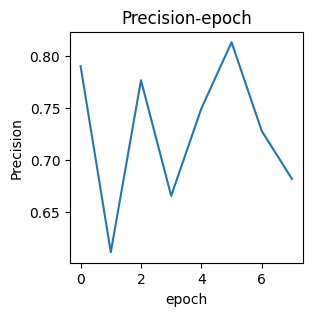

valid epoch[9/70]: 100%|██████████| 326/326 [00:06<00:00, 49.36it/s]
[epoch 9] loss: 0.501  accuracy: 0.832  Precision: 0.878  Recall: 0.833  F1: 0.854871  Sensitivity: 0.833  Specificity: 0.830  Threat: 0.747


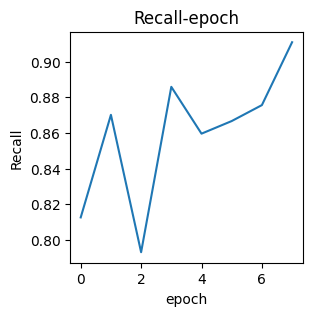

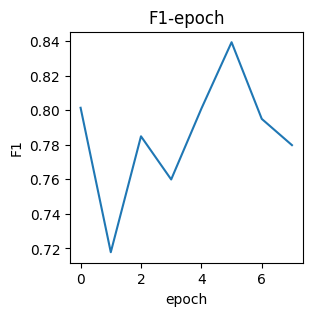

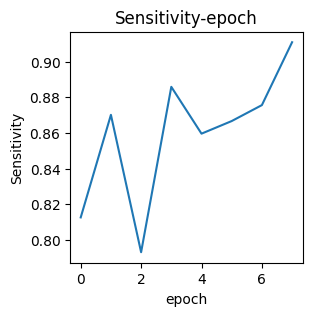

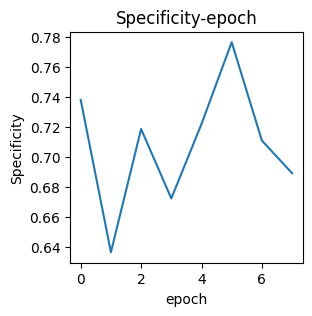

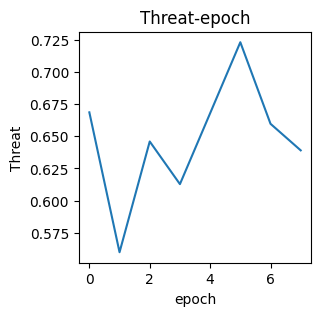

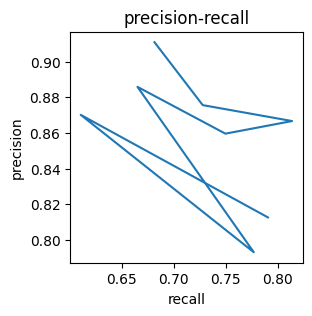

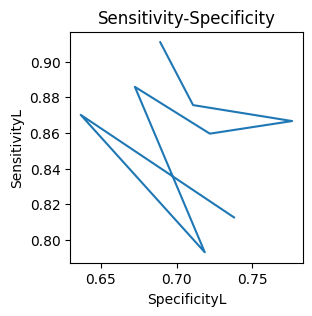

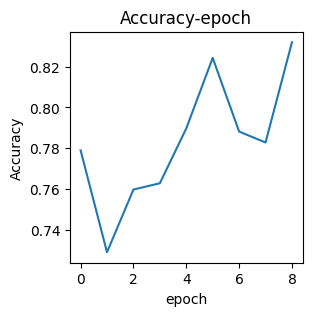

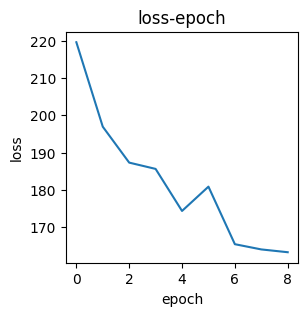

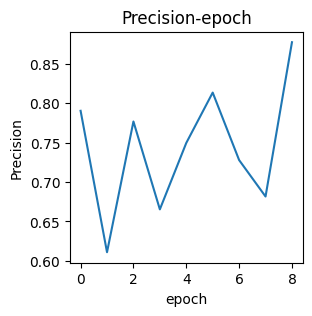

valid epoch[10/70]: 100%|██████████| 326/326 [00:06<00:00, 49.60it/s]
[epoch 10] loss: 0.515  accuracy: 0.822  Precision: 0.976  Recall: 0.770  F1: 0.860744  Sensitivity: 0.770  Specificity: 0.952  Threat: 0.756


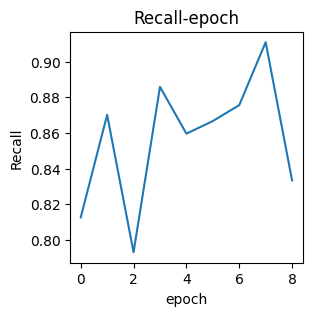

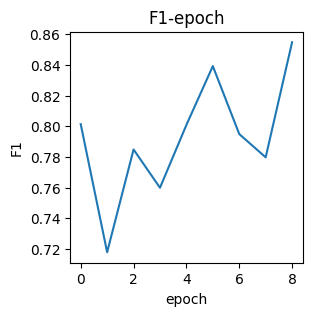

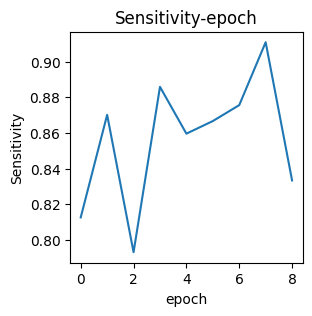

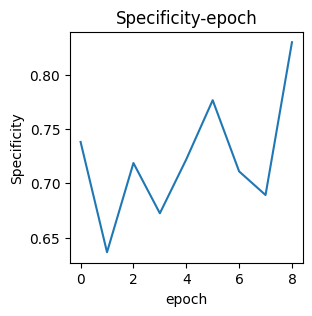

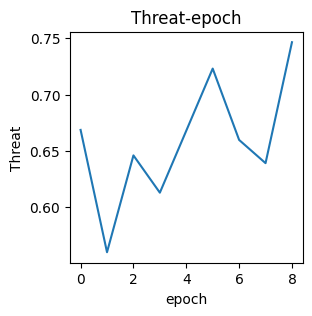

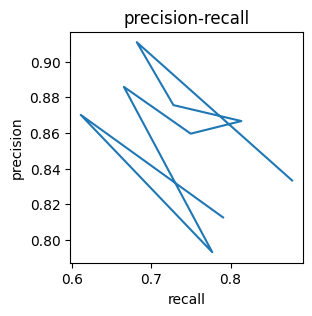

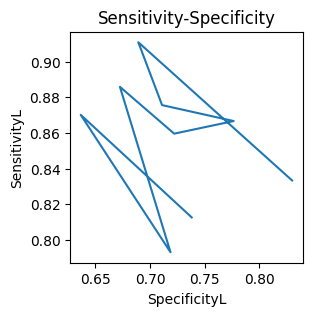

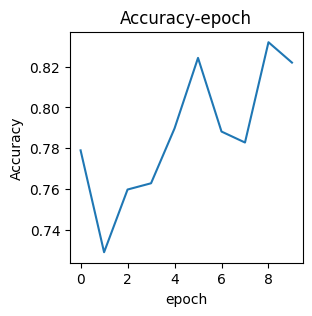

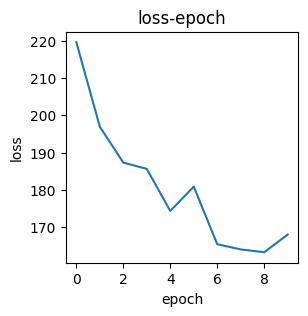

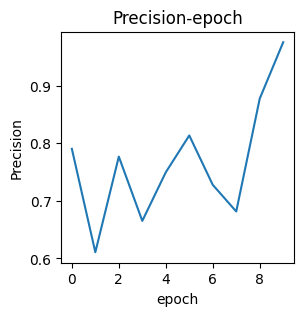

valid epoch[11/70]: 100%|██████████| 326/326 [00:06<00:00, 51.50it/s]
[epoch 11] loss: 0.460  accuracy: 0.804  Precision: 0.981  Recall: 0.749  F1: 0.849234  Sensitivity: 0.749  Specificity: 0.959  Threat: 0.738


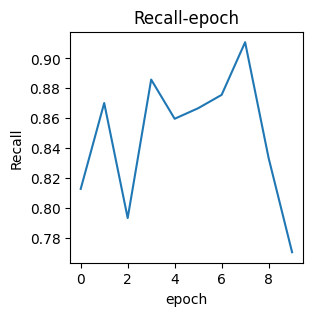

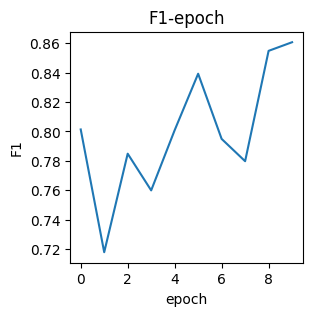

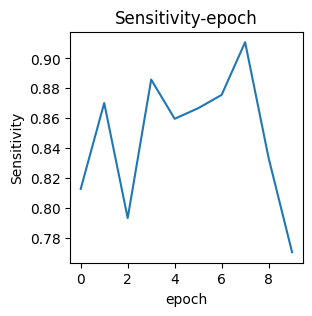

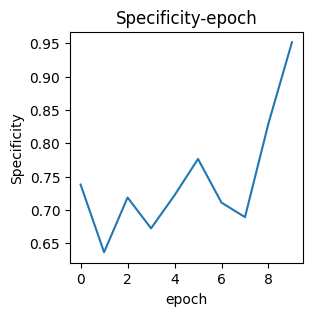

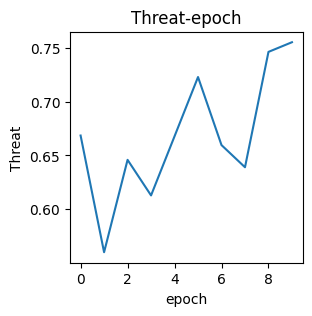

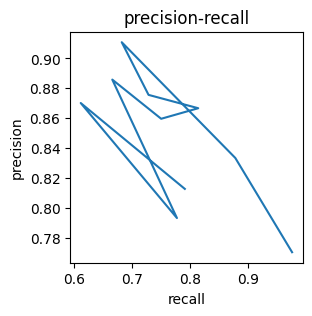

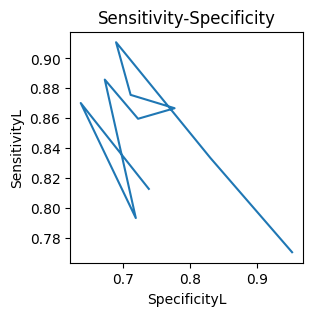

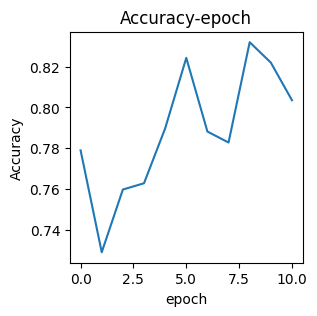

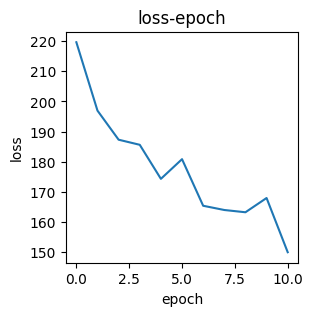

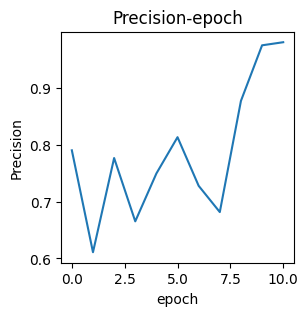

valid epoch[12/70]: 100%|██████████| 326/326 [00:06<00:00, 50.17it/s]
[epoch 12] loss: 0.495  accuracy: 0.810  Precision: 0.824  Recall: 0.836  F1: 0.830137  Sensitivity: 0.836  Specificity: 0.777  Threat: 0.710


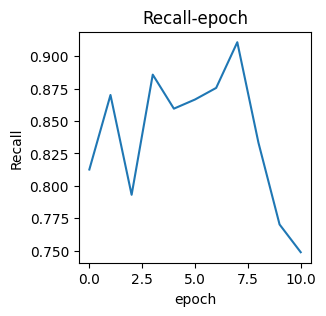

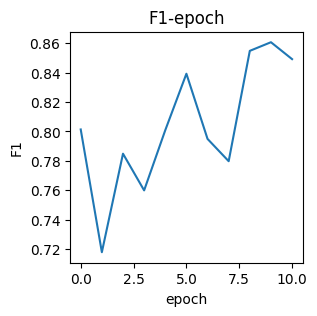

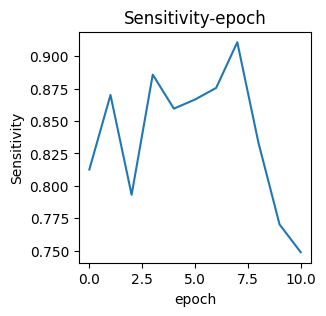

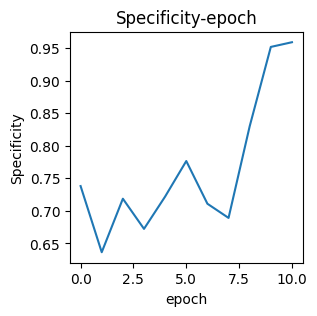

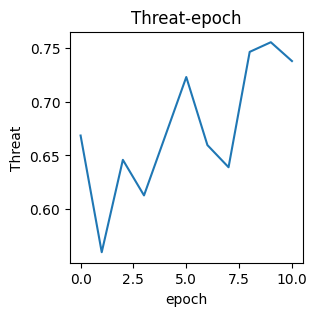

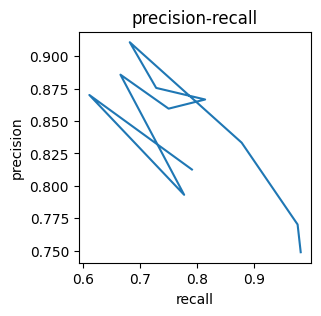

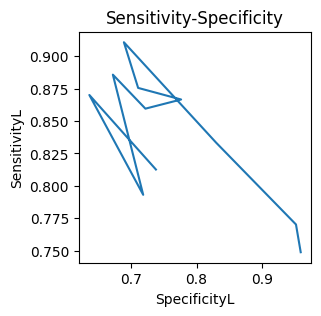

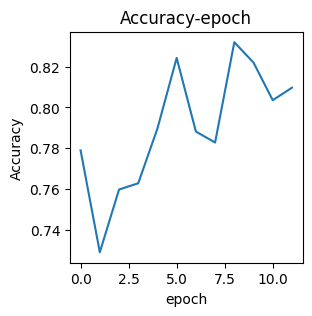

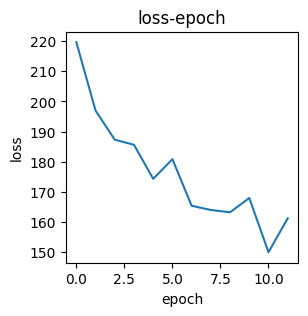

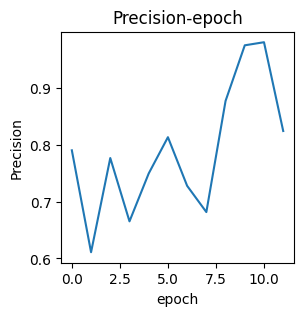

valid epoch[13/70]: 100%|██████████| 326/326 [00:06<00:00, 50.65it/s]
[epoch 13] loss: 0.468  accuracy: 0.845  Precision: 0.969  Recall: 0.799  F1: 0.875769  Sensitivity: 0.799  Specificity: 0.944  Threat: 0.779


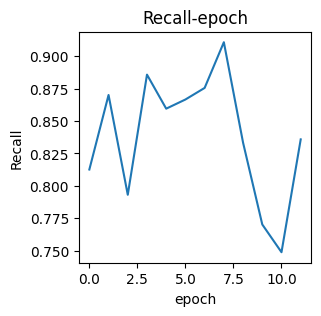

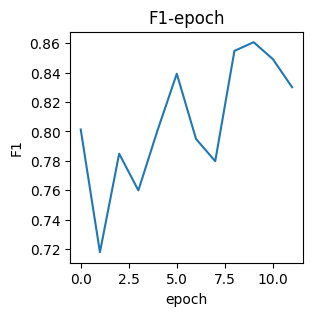

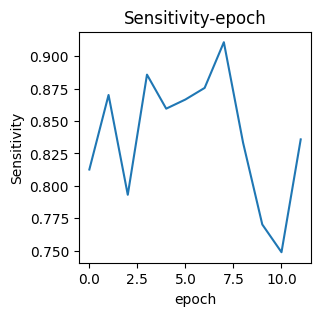

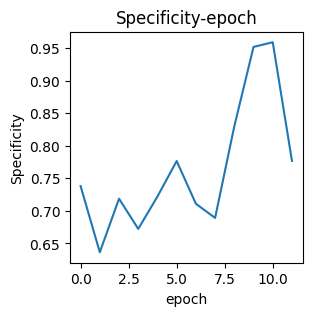

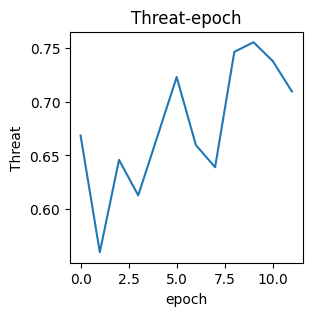

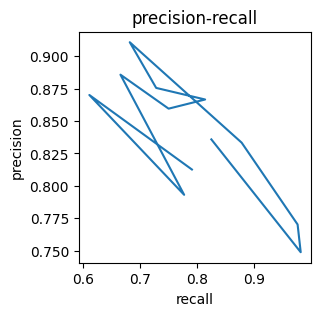

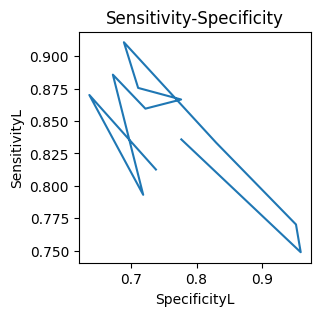

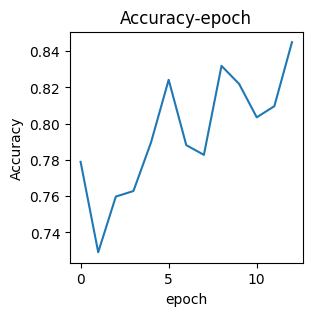

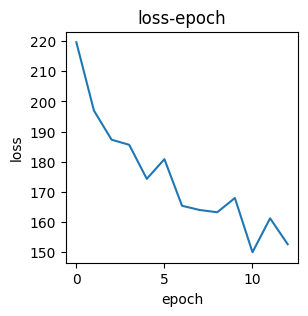

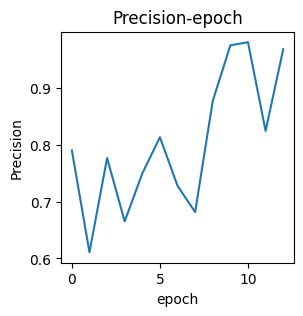

valid epoch[14/70]: 100%|██████████| 326/326 [00:06<00:00, 50.38it/s]
[epoch 14] loss: 0.439  accuracy: 0.827  Precision: 0.834  Recall: 0.855  F1: 0.844353  Sensitivity: 0.855  Specificity: 0.792  Threat: 0.731


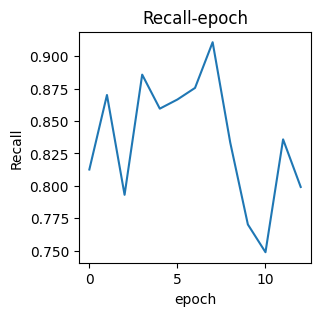

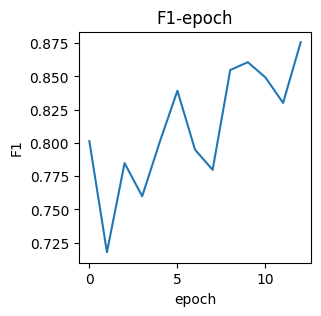

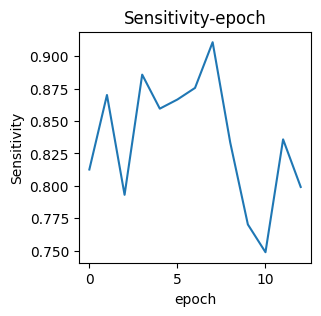

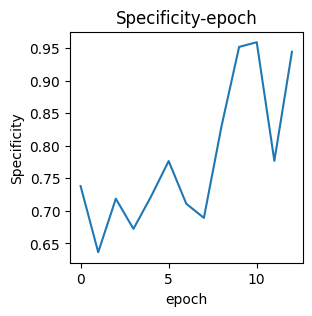

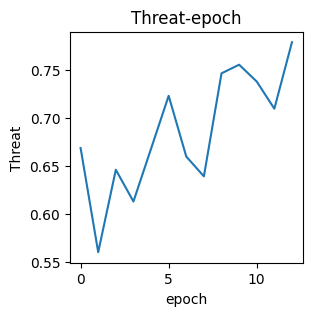

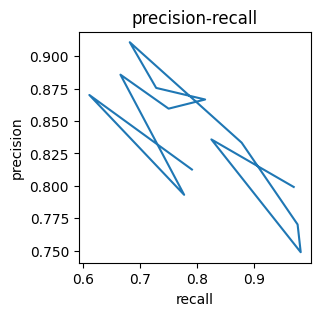

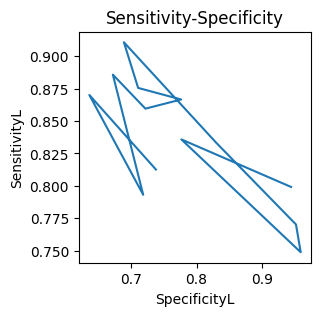

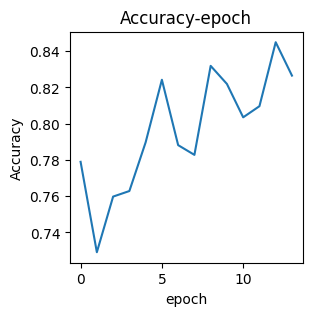

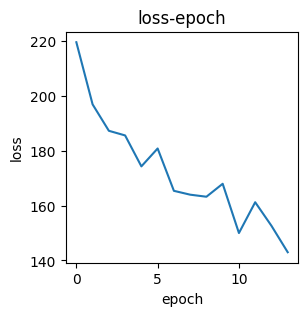

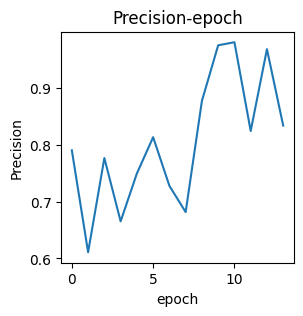

valid epoch[15/70]: 100%|██████████| 326/326 [00:06<00:00, 50.84it/s]
[epoch 15] loss: 0.445  accuracy: 0.821  Precision: 0.971  Recall: 0.771  F1: 0.859723  Sensitivity: 0.771  Specificity: 0.944  Threat: 0.754


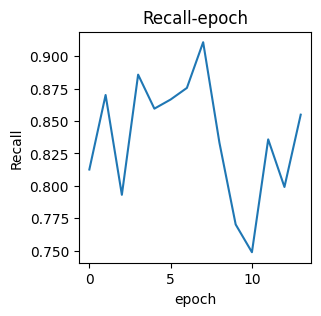

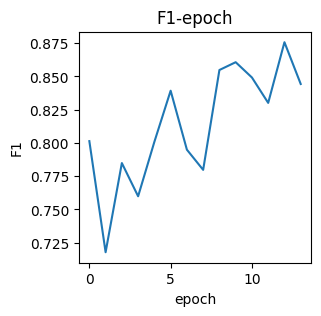

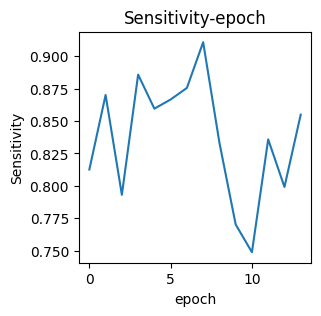

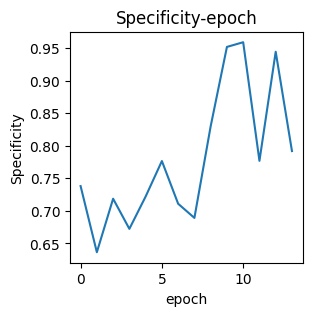

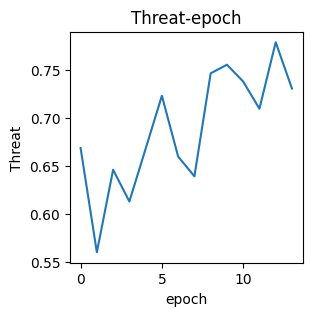

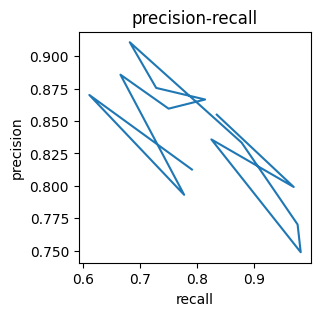

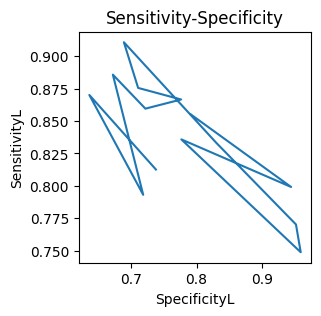

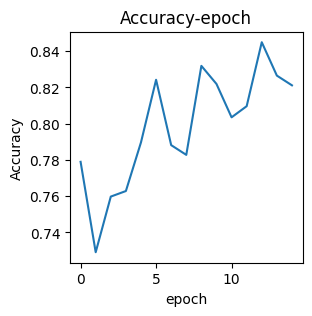

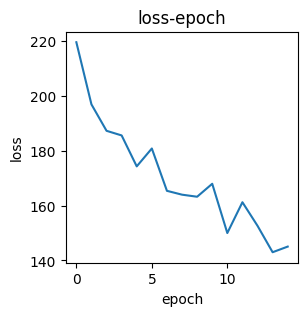

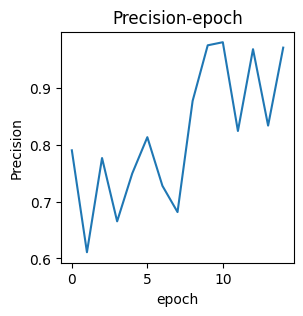

valid epoch[16/70]: 100%|██████████| 326/326 [00:06<00:00, 50.51it/s]
[epoch 16] loss: 0.448  accuracy: 0.870  Precision: 0.962  Recall: 0.833  F1: 0.892677  Sensitivity: 0.833  Specificity: 0.938  Threat: 0.806


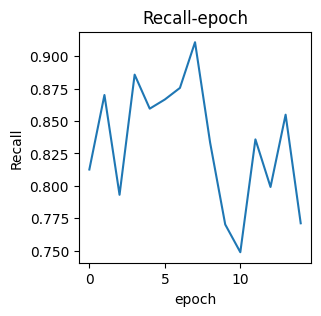

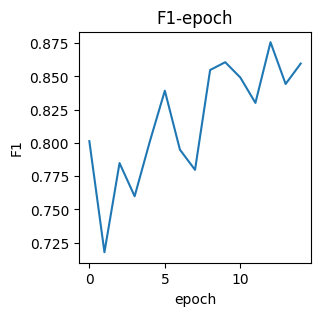

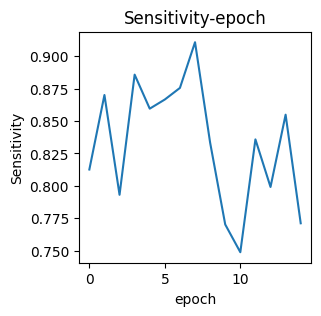

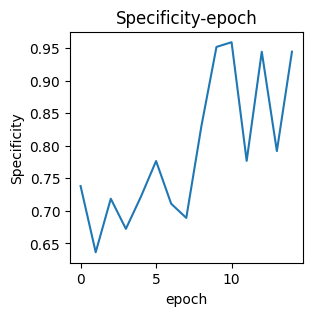

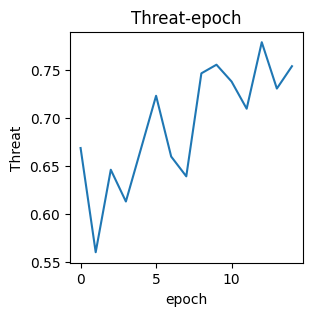

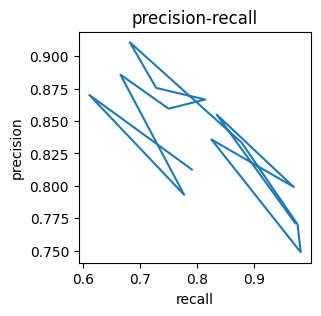

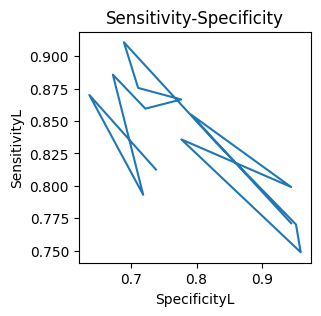

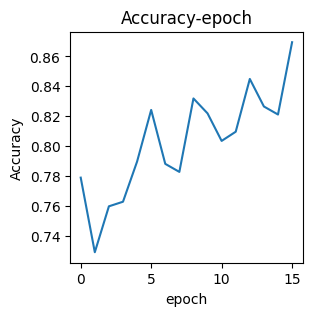

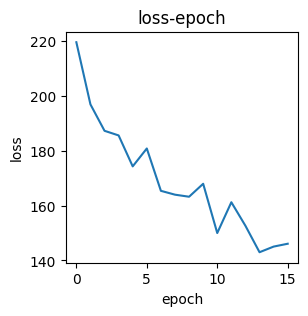

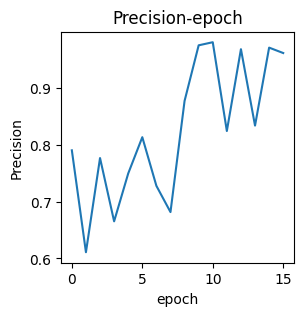

valid epoch[17/70]: 100%|██████████| 326/326 [00:06<00:00, 50.01it/s]
[epoch 17] loss: 0.432  accuracy: 0.889  Precision: 0.944  Recall: 0.870  F1: 0.905414  Sensitivity: 0.870  Specificity: 0.919  Threat: 0.827


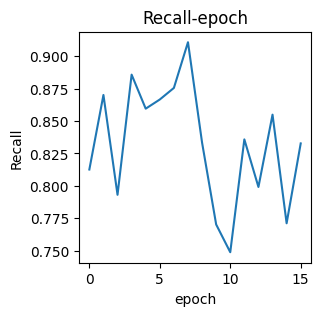

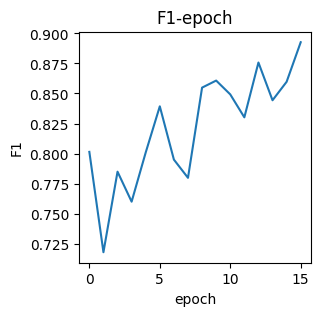

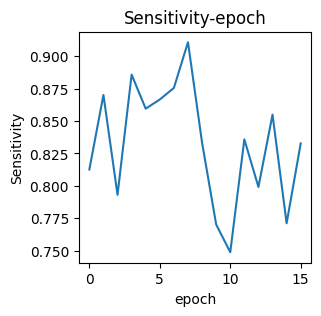

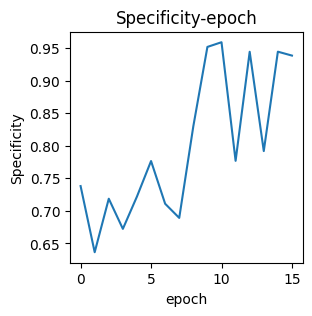

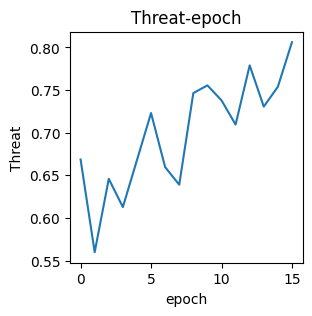

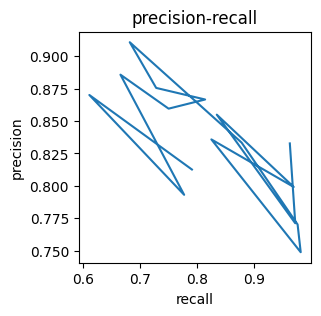

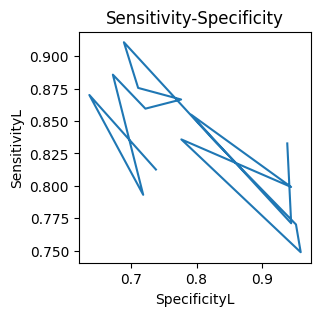

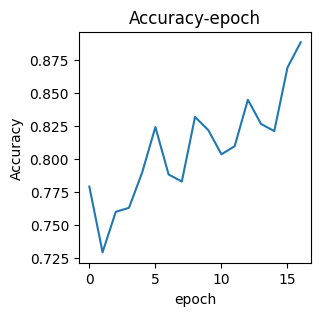

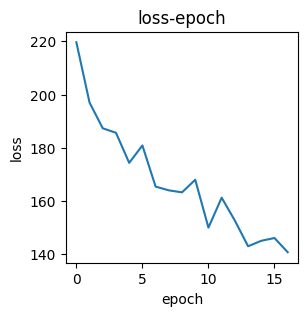

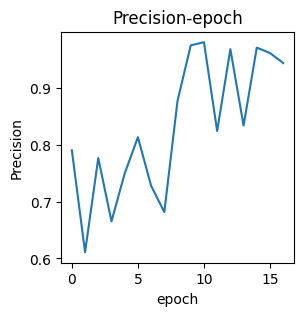

valid epoch[18/70]: 100%|██████████| 326/326 [00:06<00:00, 50.01it/s]
[epoch 18] loss: 0.412  accuracy: 0.885  Precision: 0.963  Recall: 0.852  F1: 0.904215  Sensitivity: 0.852  Specificity: 0.943  Threat: 0.825


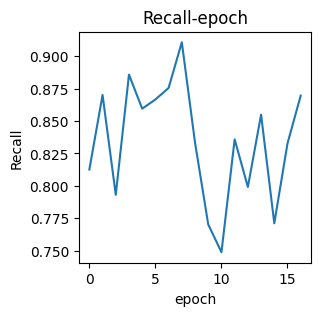

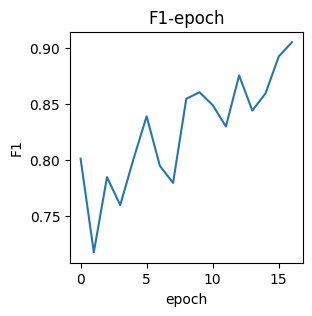

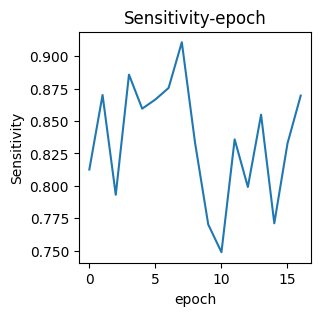

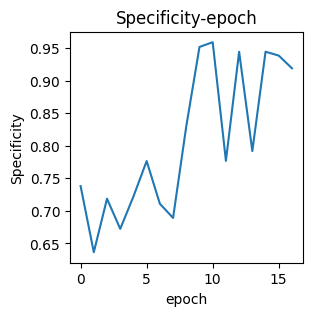

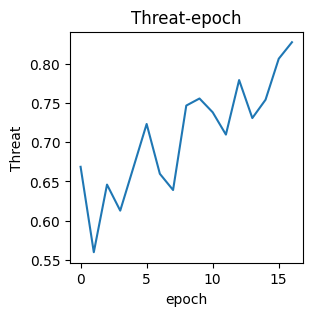

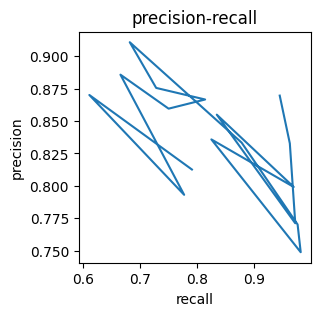

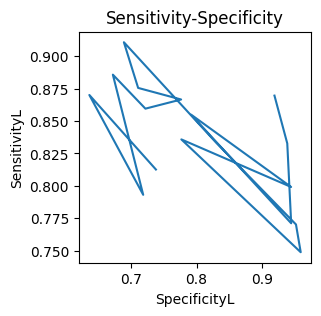

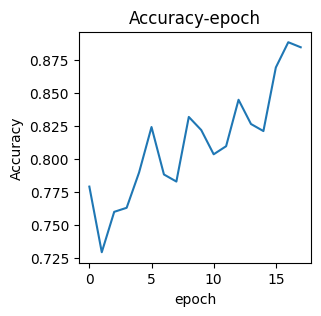

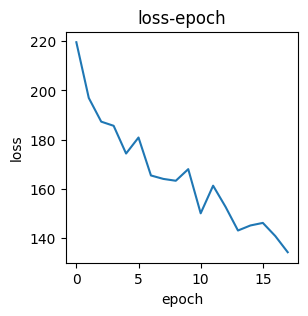

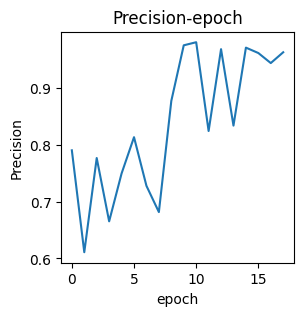

valid epoch[19/70]: 100%|██████████| 326/326 [00:06<00:00, 49.76it/s]
[epoch 19] loss: 0.413  accuracy: 0.866  Precision: 0.985  Recall: 0.815  F1: 0.892175  Sensitivity: 0.815  Specificity: 0.973  Threat: 0.805


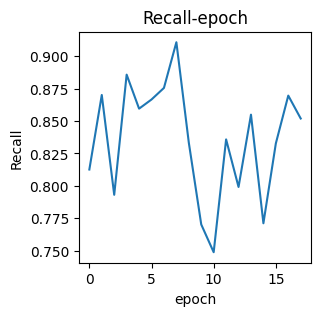

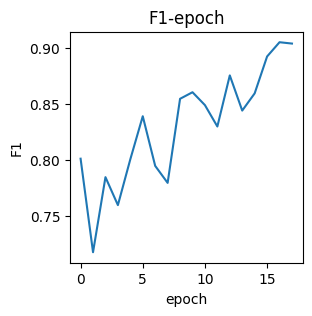

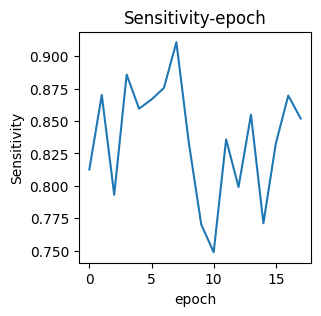

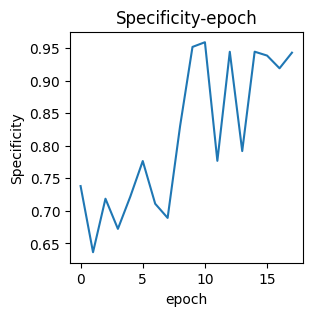

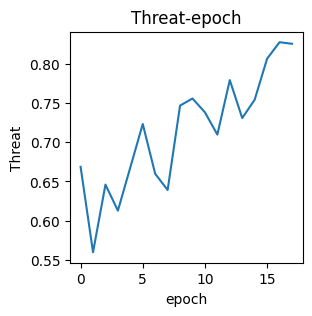

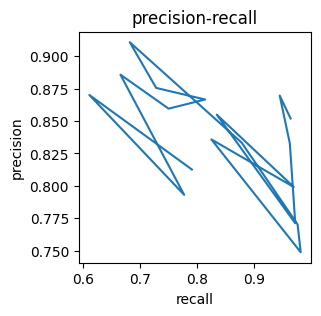

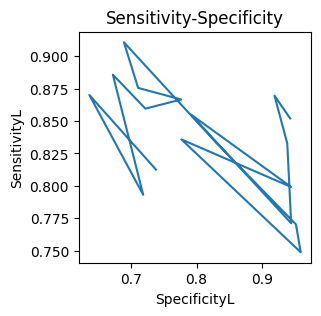

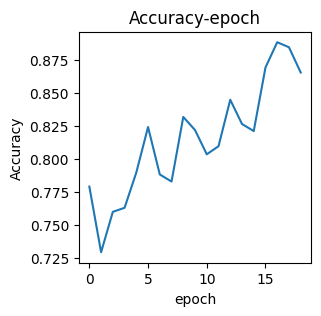

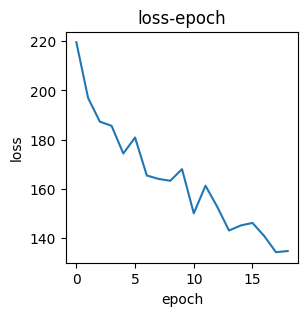

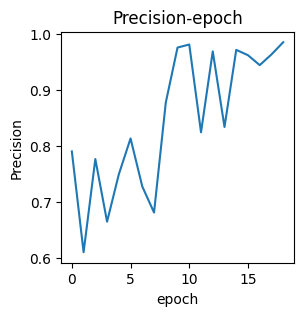

valid epoch[20/70]: 100%|██████████| 326/326 [00:06<00:00, 50.59it/s]
[epoch 20] loss: 0.428  accuracy: 0.846  Precision: 0.976  Recall: 0.797  F1: 0.877064  Sensitivity: 0.797  Specificity: 0.955  Threat: 0.781


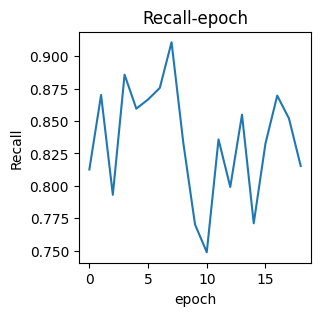

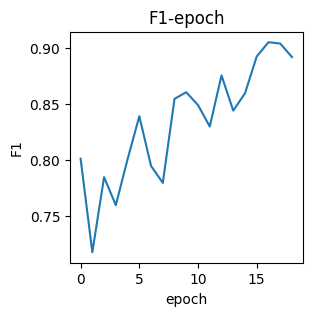

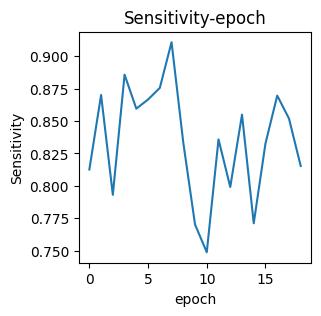

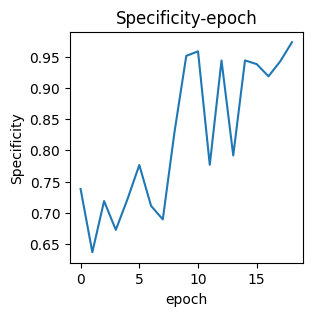

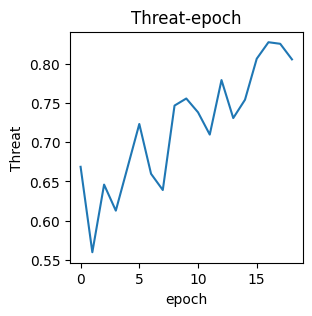

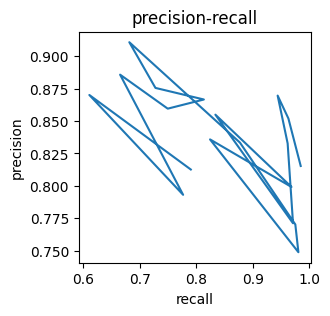

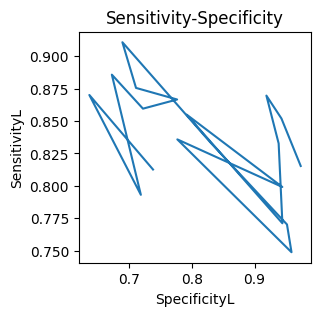

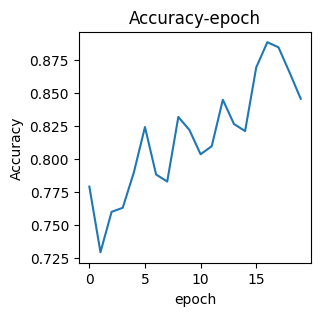

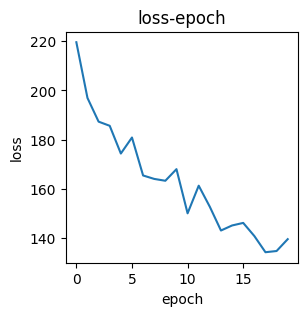

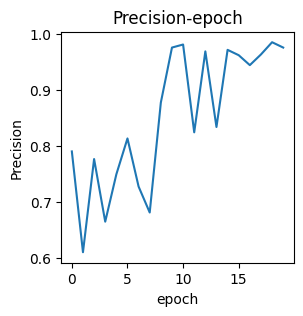

valid epoch[21/70]: 100%|██████████| 326/326 [00:06<00:00, 51.21it/s]
[epoch 21] loss: 0.414  accuracy: 0.893  Precision: 0.901  Recall: 0.908  F1: 0.904372  Sensitivity: 0.908  Specificity: 0.873  Threat: 0.825


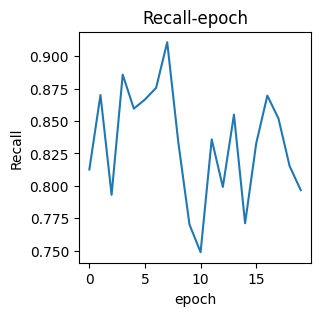

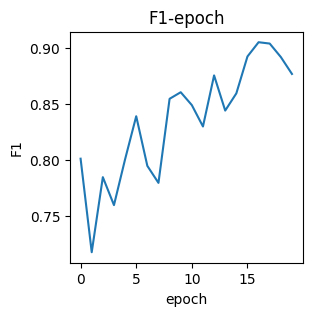

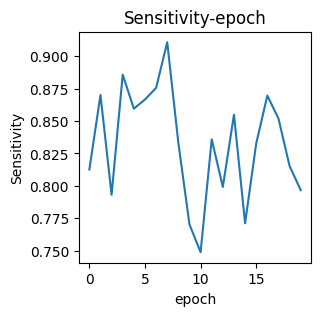

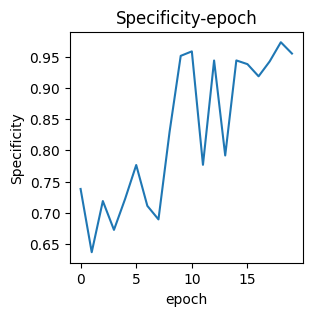

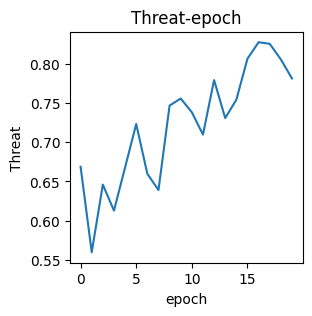

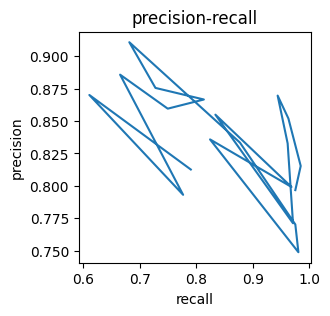

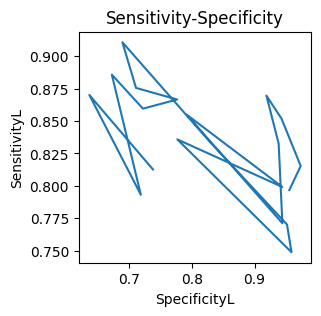

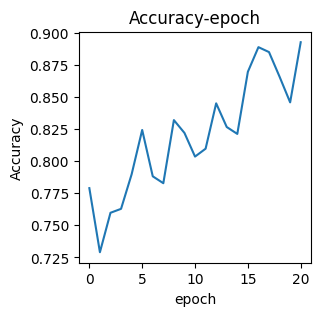

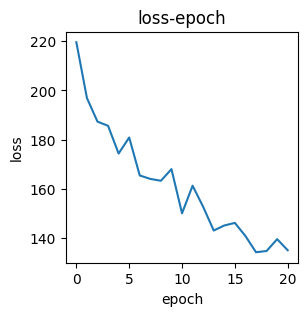

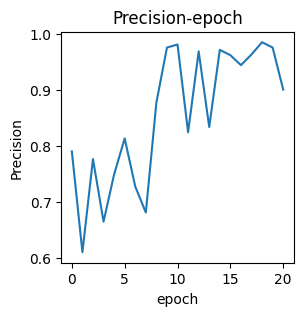

valid epoch[22/70]: 100%|██████████| 326/326 [00:06<00:00, 50.31it/s]
[epoch 22] loss: 0.379  accuracy: 0.856  Precision: 0.973  Recall: 0.811  F1: 0.884354  Sensitivity: 0.811  Specificity: 0.952  Threat: 0.793


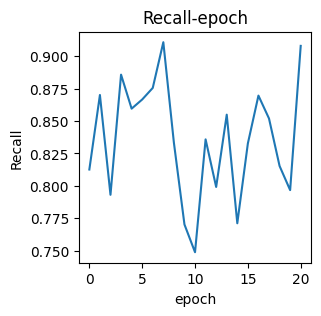

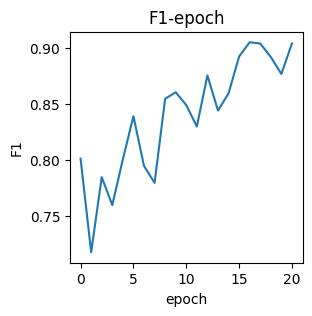

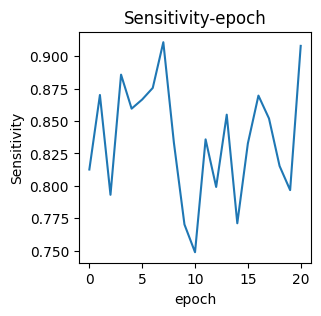

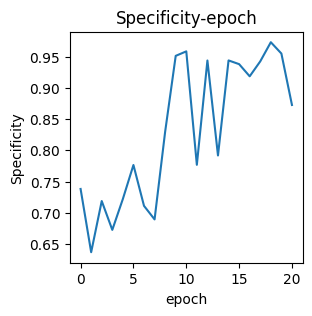

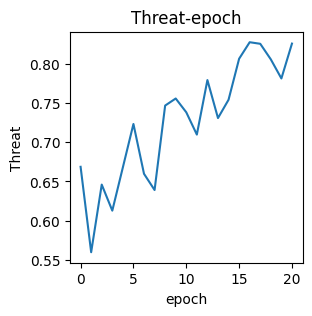

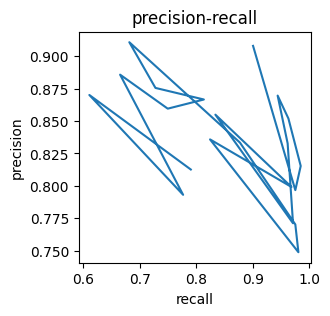

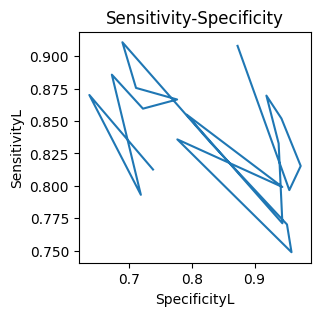

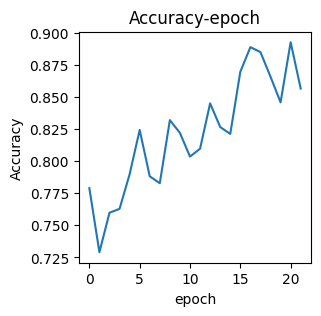

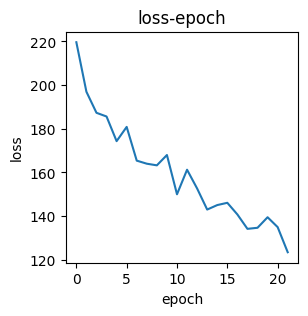

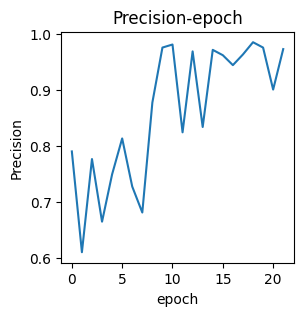

valid epoch[23/70]: 100%|██████████| 326/326 [00:06<00:00, 49.99it/s]
[epoch 23] loss: 0.398  accuracy: 0.850  Precision: 0.974  Recall: 0.802  F1: 0.879607  Sensitivity: 0.802  Specificity: 0.954  Threat: 0.785


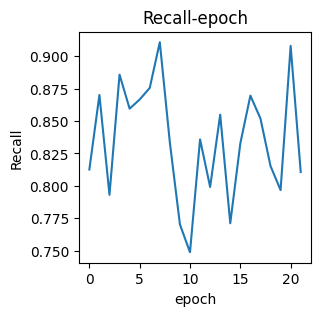

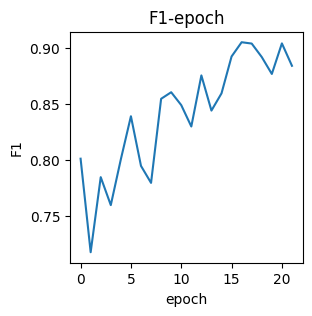

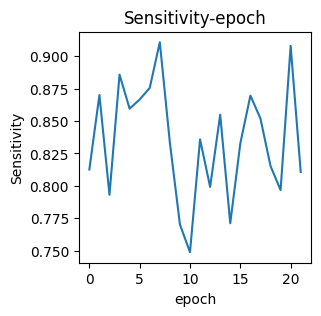

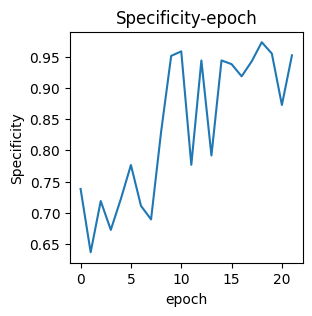

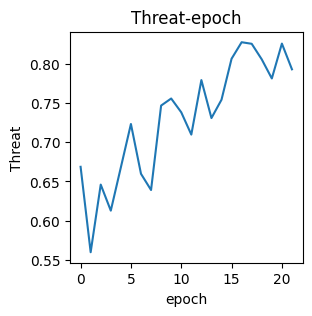

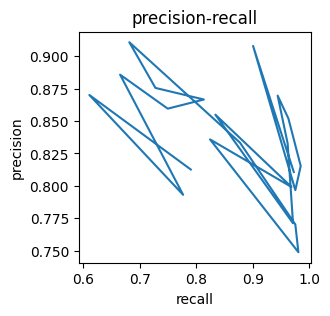

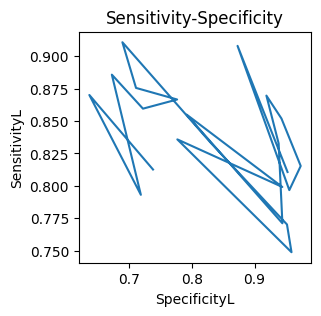

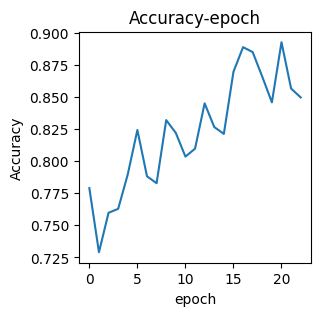

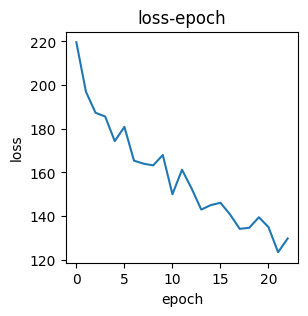

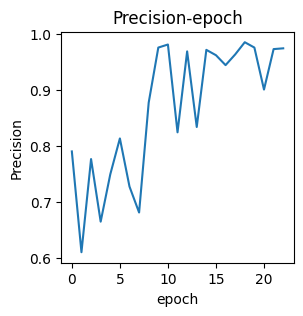

valid epoch[24/70]: 100%|██████████| 326/326 [00:06<00:00, 50.29it/s]
[epoch 24] loss: 0.423  accuracy: 0.876  Precision: 0.980  Recall: 0.831  F1: 0.899438  Sensitivity: 0.831  Specificity: 0.966  Threat: 0.817


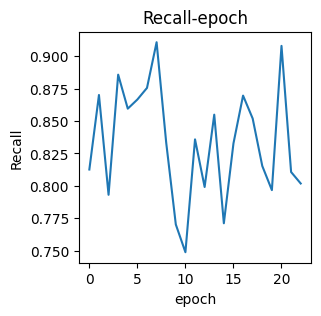

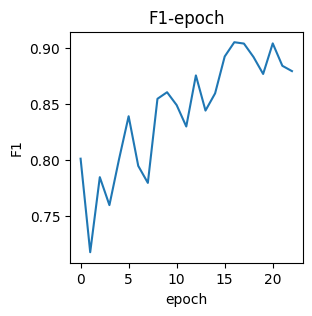

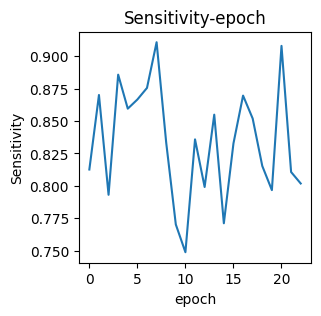

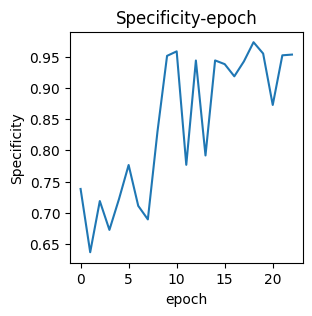

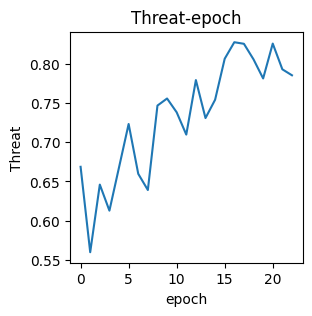

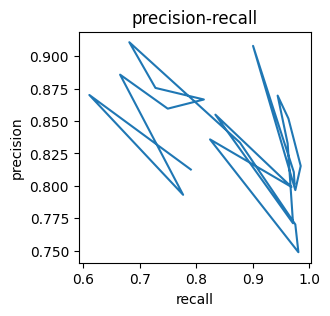

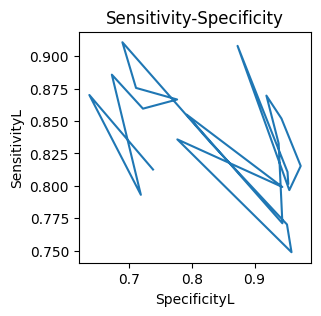

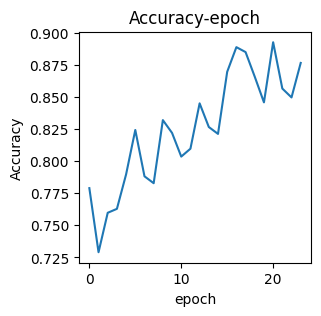

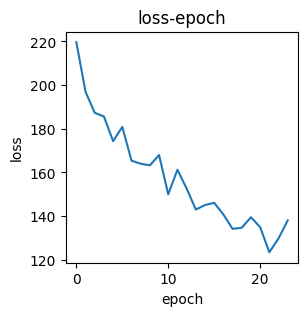

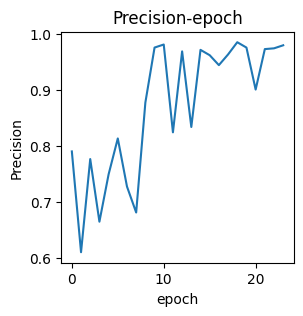

valid epoch[25/70]: 100%|██████████| 326/326 [00:06<00:00, 51.32it/s]
[epoch 25] loss: 0.377  accuracy: 0.847  Precision: 0.985  Recall: 0.793  F1: 0.878641  Sensitivity: 0.793  Specificity: 0.972  Threat: 0.784


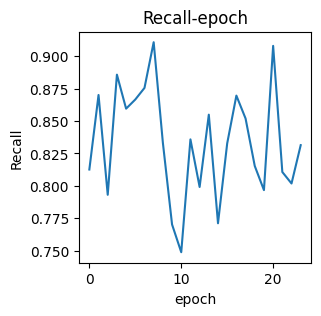

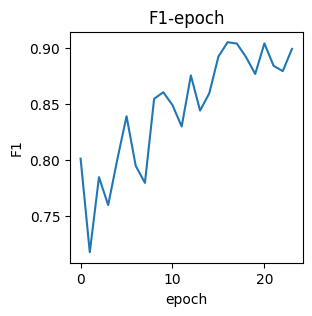

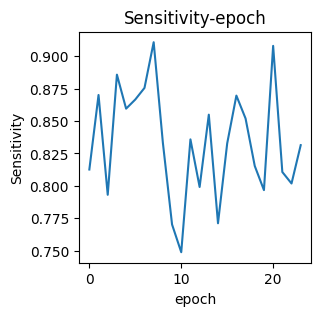

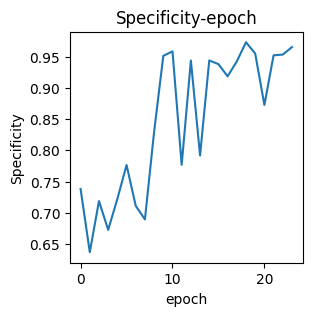

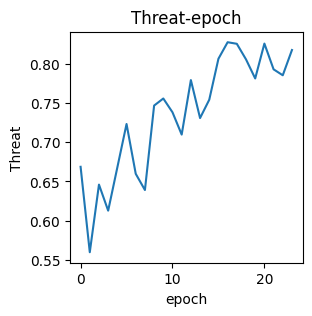

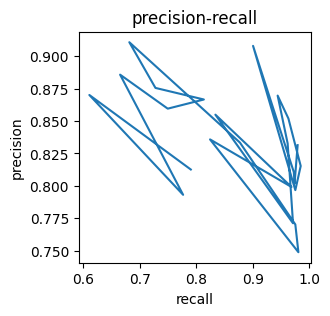

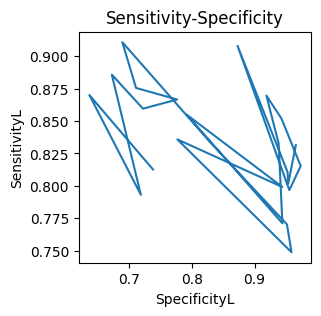

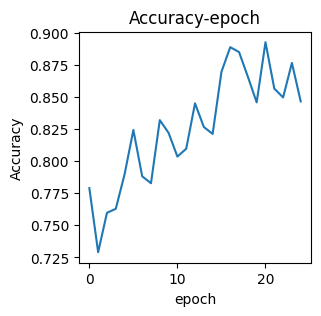

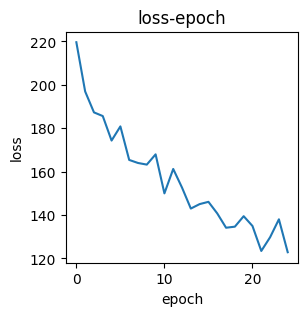

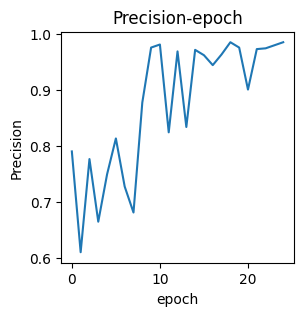

valid epoch[26/70]: 100%|██████████| 326/326 [00:06<00:00, 49.63it/s]
[epoch 26] loss: 0.371  accuracy: 0.894  Precision: 0.933  Recall: 0.885  F1: 0.908609  Sensitivity: 0.885  Specificity: 0.907  Threat: 0.833


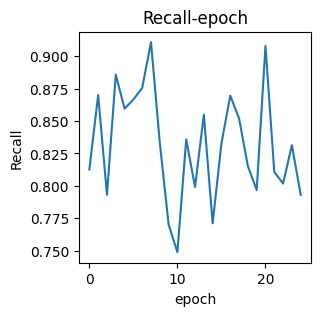

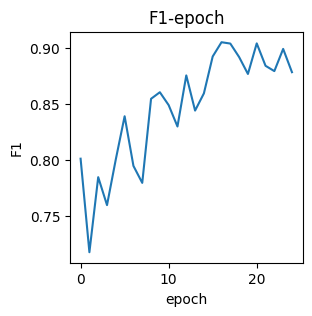

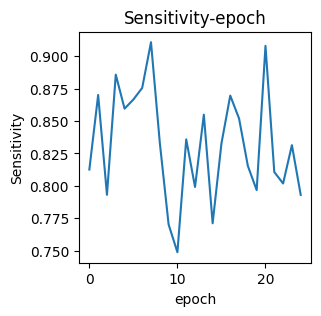

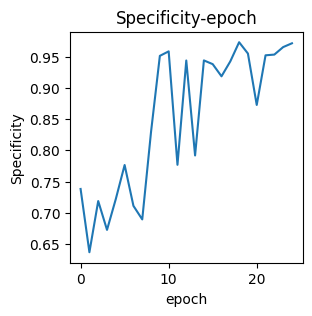

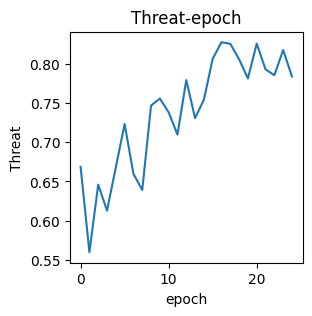

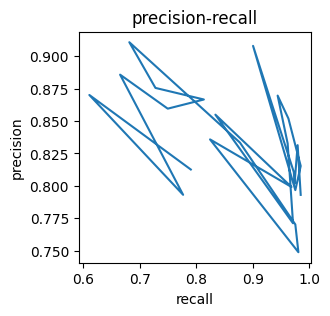

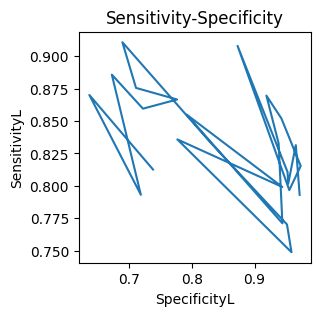

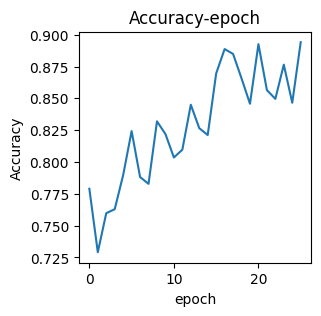

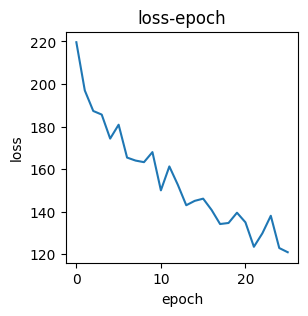

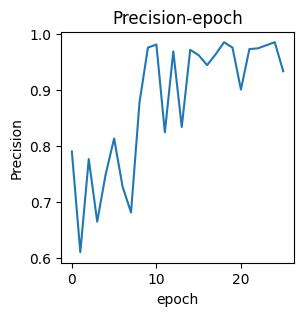

valid epoch[27/70]: 100%|██████████| 326/326 [00:06<00:00, 49.25it/s]
[epoch 27] loss: 0.368  accuracy: 0.869  Precision: 0.980  Recall: 0.822  F1: 0.893855  Sensitivity: 0.822  Specificity: 0.965  Threat: 0.808


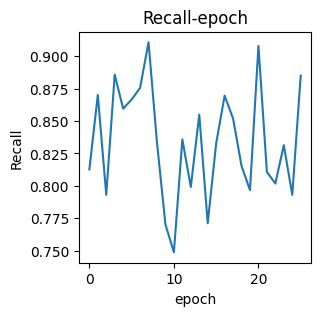

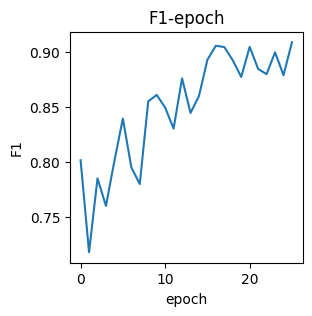

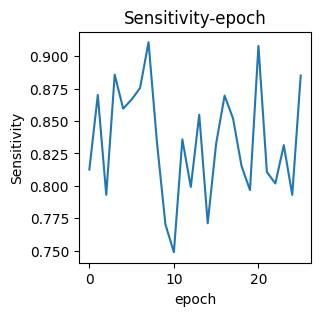

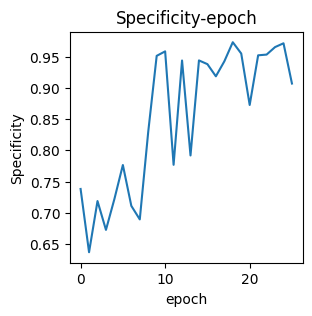

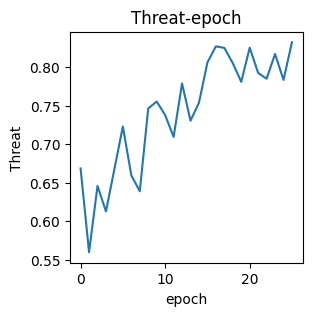

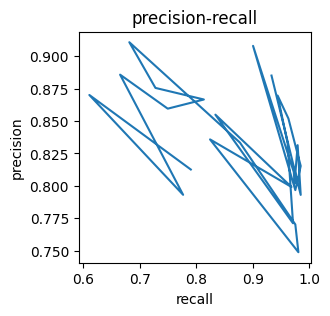

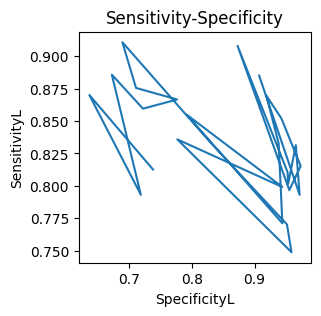

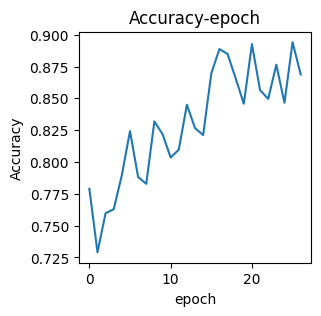

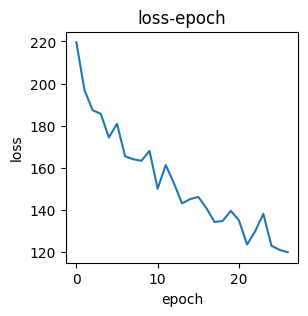

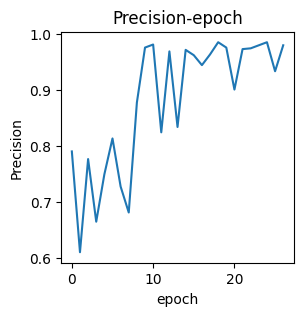

valid epoch[28/70]: 100%|██████████| 326/326 [00:06<00:00, 50.67it/s]
[epoch 28] loss: 0.362  accuracy: 0.767  Precision: 0.996  Recall: 0.709  F1: 0.828523  Sensitivity: 0.709  Specificity: 0.989  Threat: 0.707


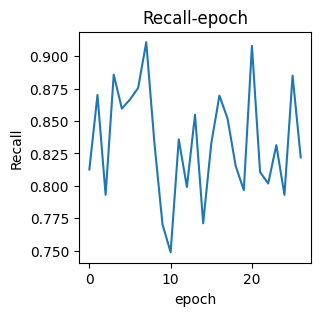

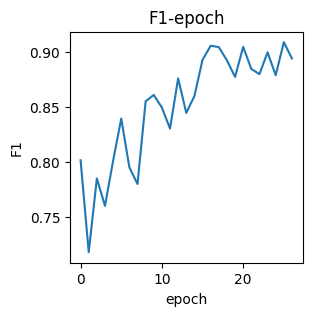

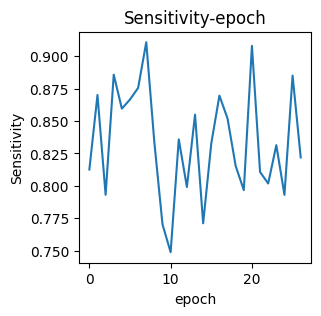

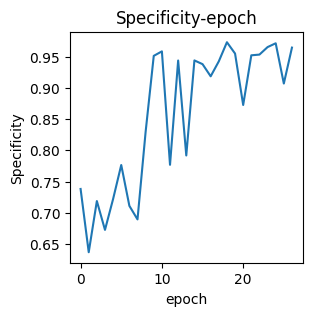

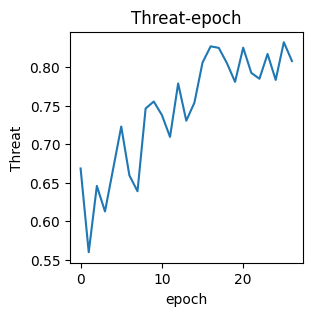

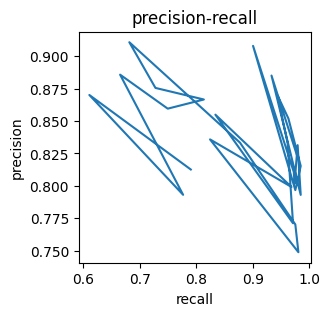

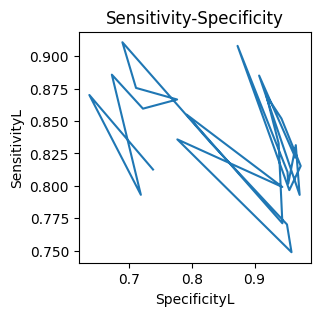

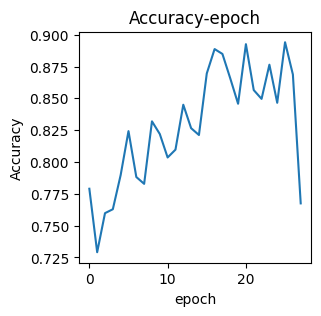

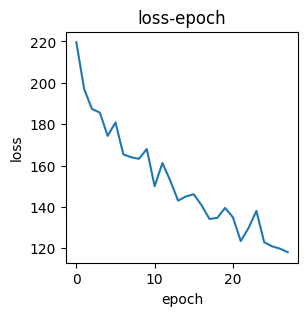

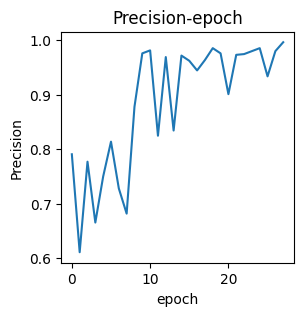

valid epoch[29/70]: 100%|██████████| 326/326 [00:06<00:00, 52.11it/s]
[epoch 29] loss: 0.353  accuracy: 0.938  Precision: 0.940  Recall: 0.949  F1: 0.944634  Sensitivity: 0.949  Specificity: 0.923  Threat: 0.895


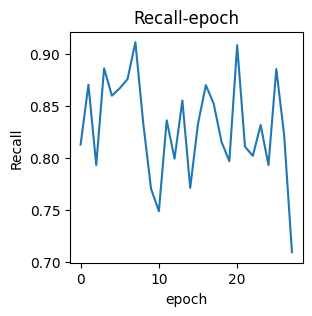

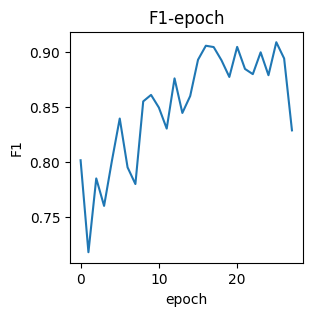

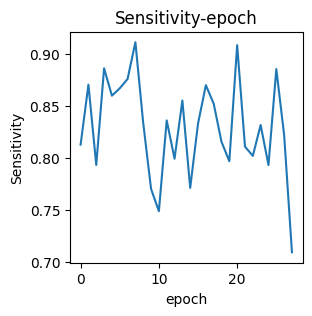

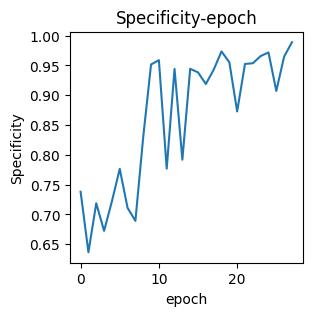

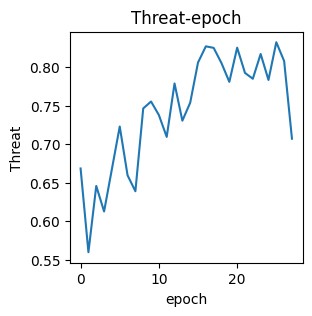

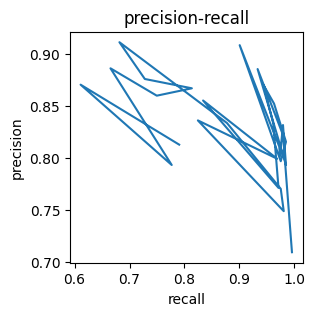

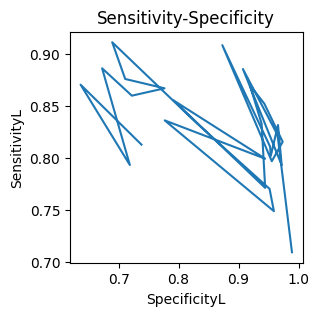

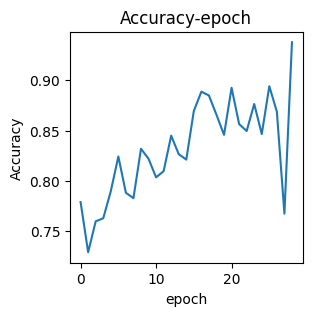

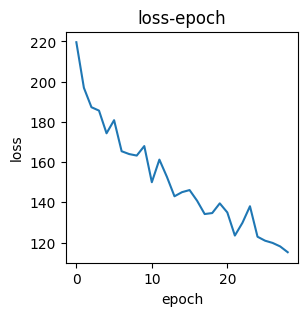

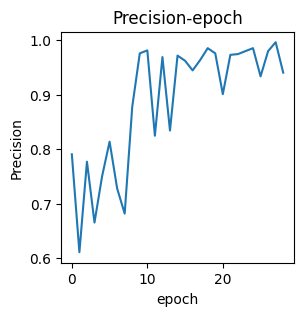

valid epoch[30/70]: 100%|██████████| 326/326 [00:06<00:00, 51.34it/s]
[epoch 30] loss: 0.367  accuracy: 0.914  Precision: 0.922  Recall: 0.925  F1: 0.923706  Sensitivity: 0.925  Specificity: 0.900  Threat: 0.858


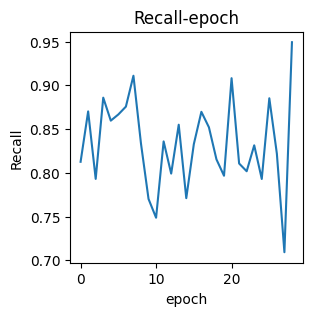

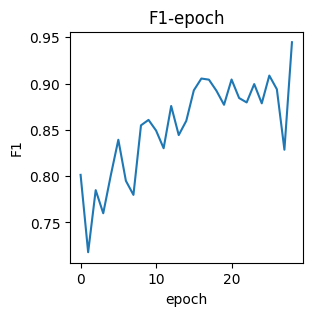

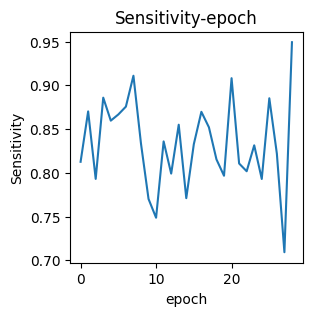

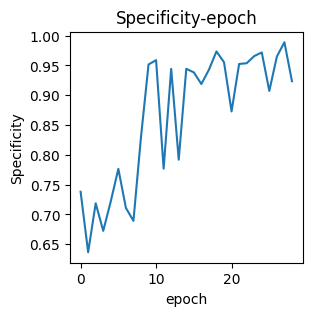

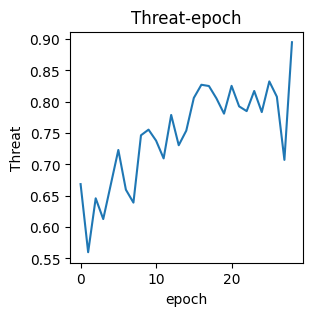

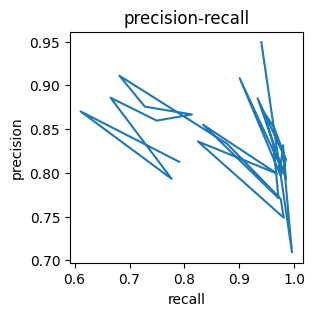

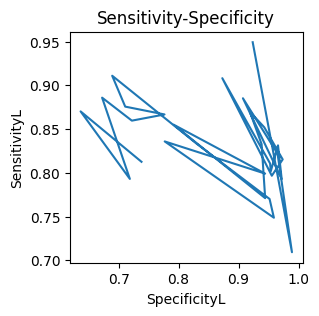

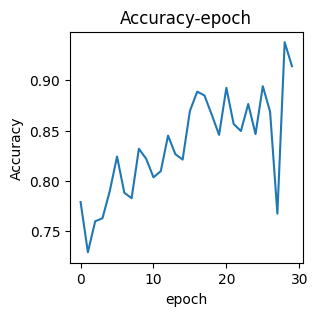

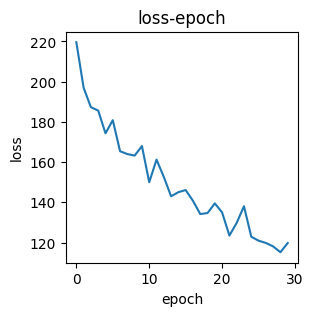

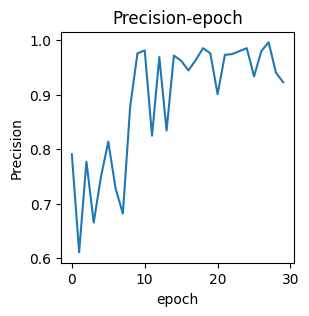

valid epoch[31/70]: 100%|██████████| 326/326 [00:06<00:00, 48.73it/s]
[epoch 31] loss: 0.321  accuracy: 0.882  Precision: 0.816  Recall: 0.969  F1: 0.886263  Sensitivity: 0.969  Specificity: 0.803  Threat: 0.796


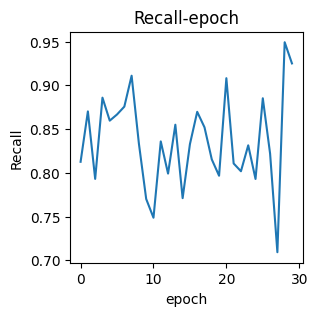

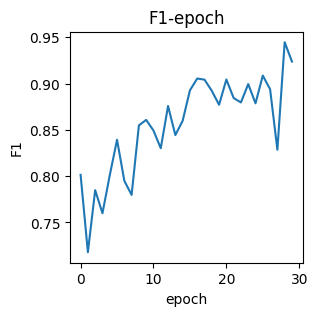

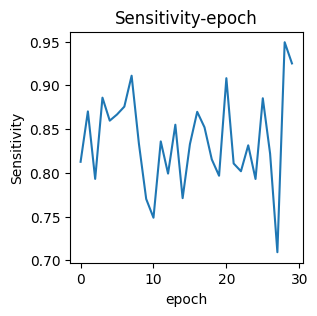

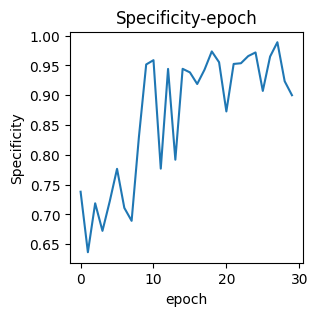

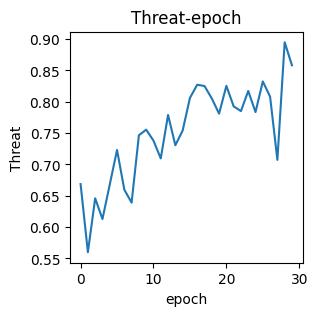

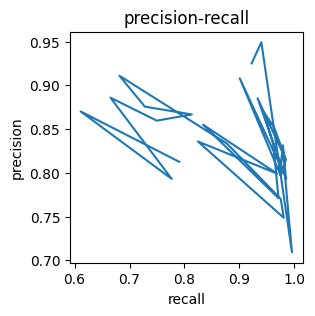

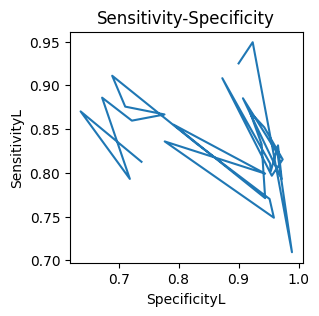

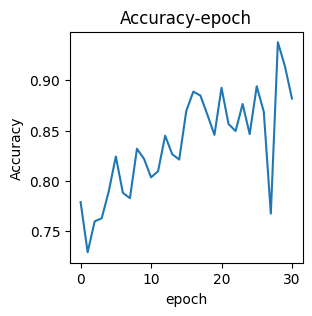

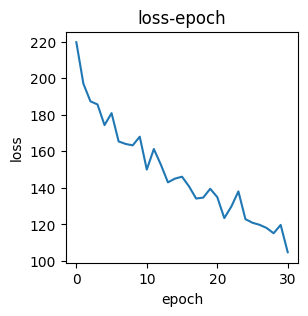

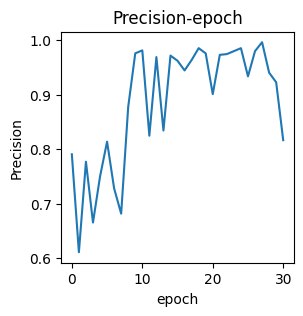

valid epoch[32/70]: 100%|██████████| 326/326 [00:06<00:00, 50.61it/s]
[epoch 32] loss: 0.374  accuracy: 0.935  Precision: 0.939  Recall: 0.945  F1: 0.941980  Sensitivity: 0.945  Specificity: 0.921  Threat: 0.890


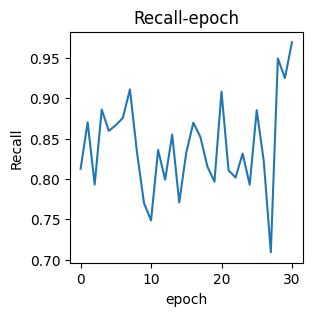

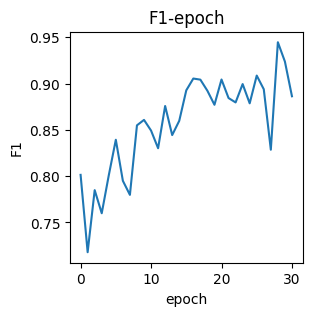

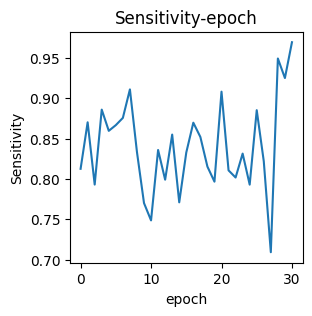

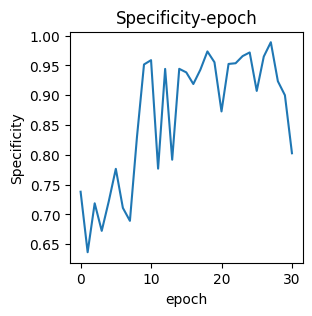

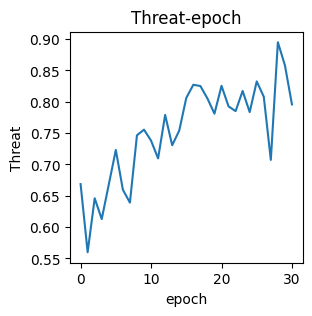

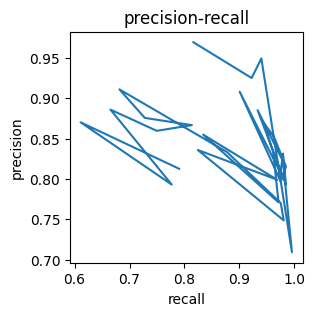

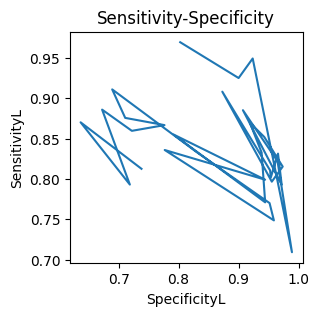

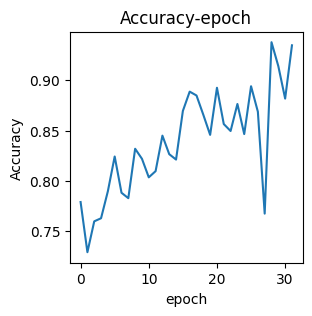

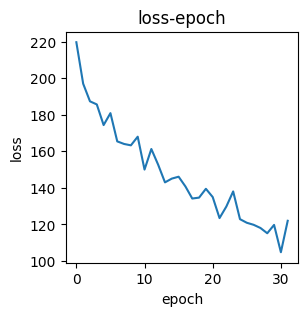

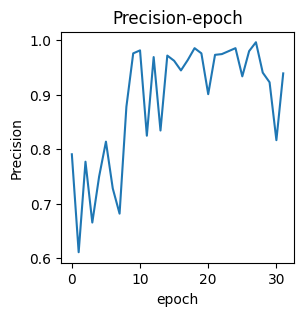

valid epoch[33/70]: 100%|██████████| 326/326 [00:06<00:00, 50.95it/s]
[epoch 33] loss: 0.370  accuracy: 0.912  Precision: 0.976  Recall: 0.881  F1: 0.925759  Sensitivity: 0.881  Specificity: 0.963  Threat: 0.862


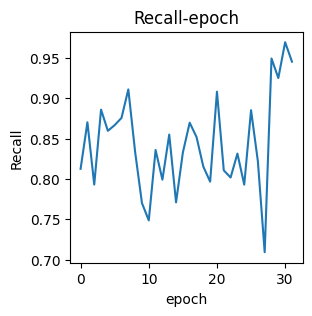

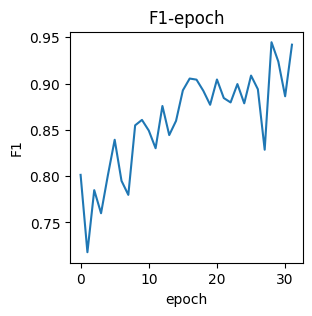

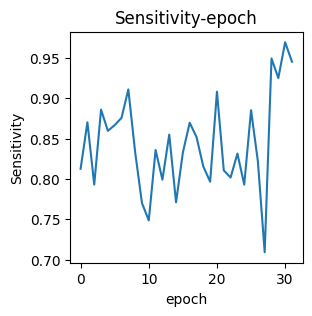

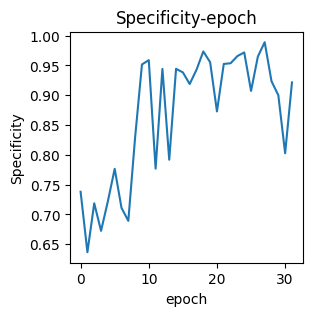

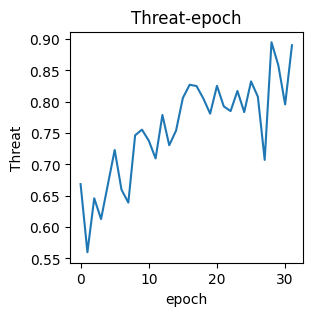

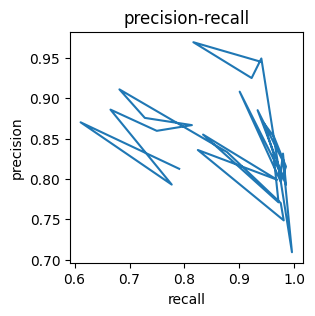

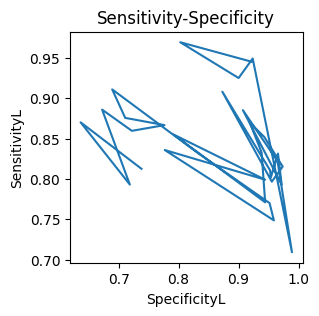

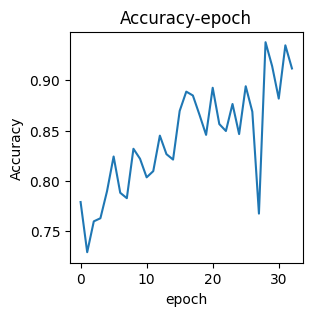

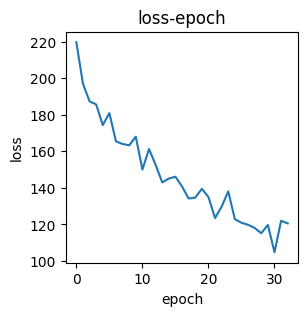

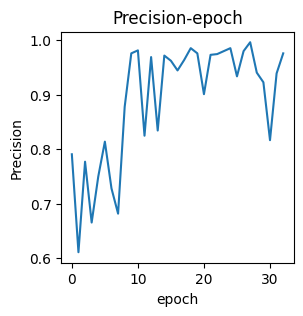

valid epoch[34/70]: 100%|██████████| 326/326 [00:06<00:00, 49.59it/s]
[epoch 34] loss: 0.363  accuracy: 0.912  Precision: 0.973  Recall: 0.883  F1: 0.925566  Sensitivity: 0.883  Specificity: 0.959  Threat: 0.861


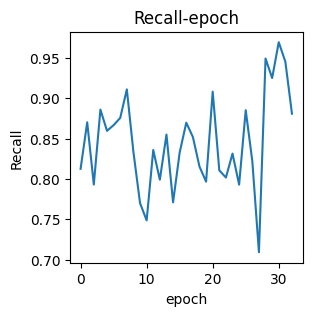

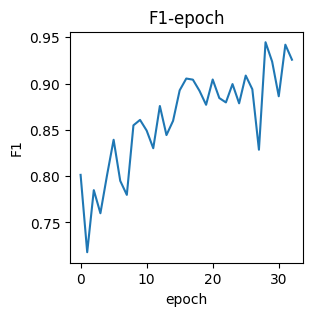

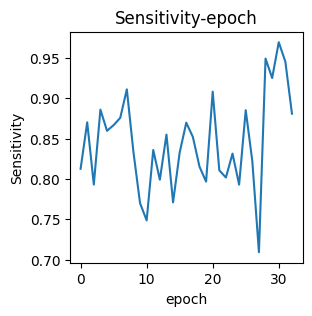

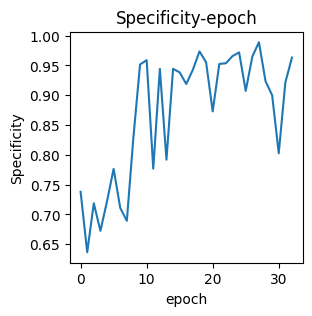

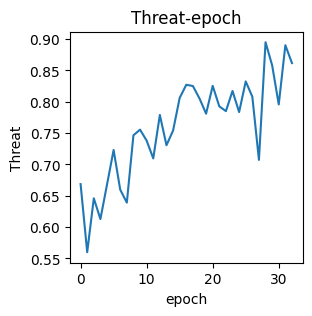

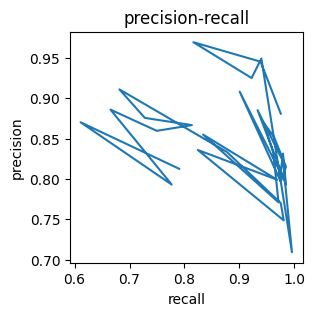

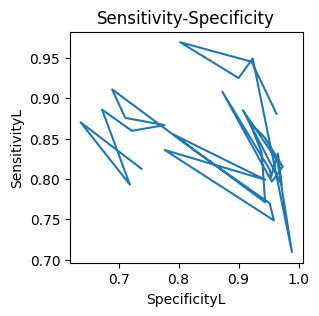

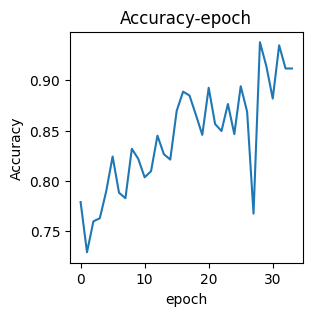

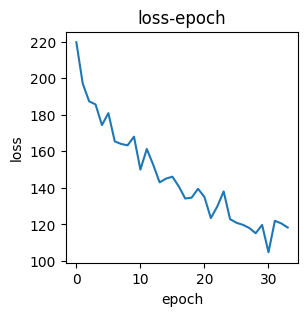

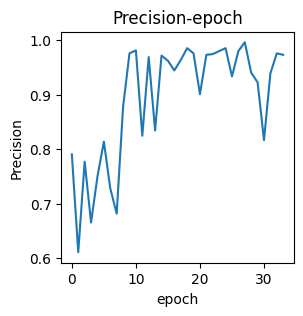

valid epoch[35/70]: 100%|██████████| 326/326 [00:06<00:00, 50.94it/s]
[epoch 35] loss: 0.338  accuracy: 0.919  Precision: 0.970  Recall: 0.895  F1: 0.930809  Sensitivity: 0.895  Specificity: 0.957  Threat: 0.871


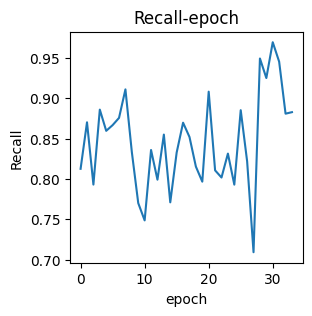

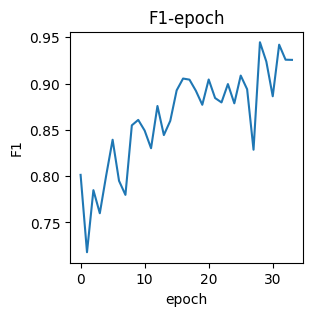

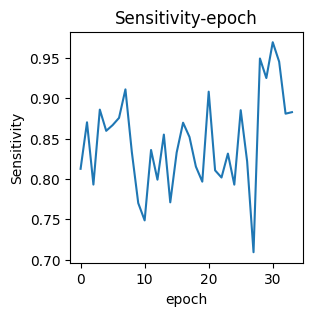

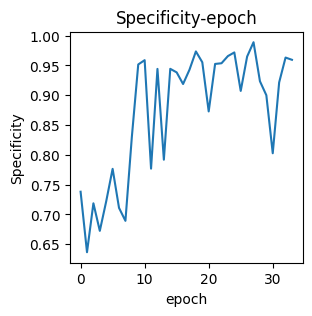

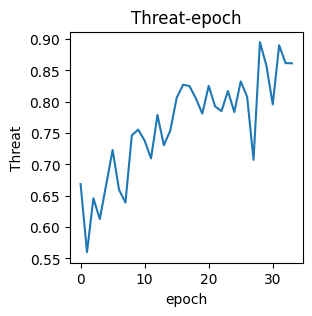

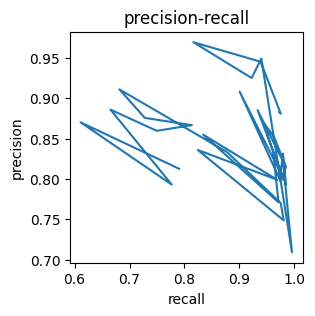

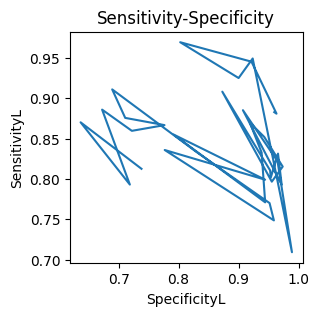

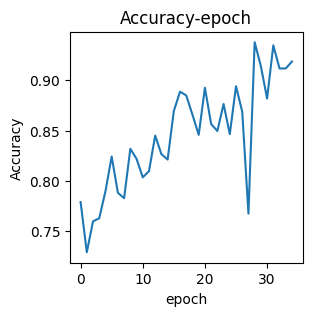

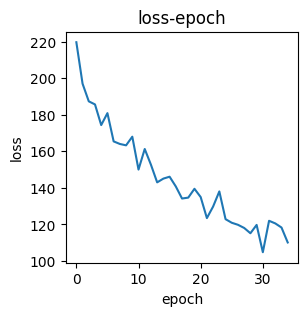

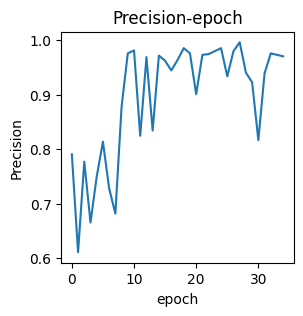

valid epoch[36/70]: 100%|██████████| 326/326 [00:06<00:00, 49.48it/s]
[epoch 36] loss: 0.355  accuracy: 0.889  Precision: 0.982  Recall: 0.846  F1: 0.909320  Sensitivity: 0.846  Specificity: 0.971  Threat: 0.834


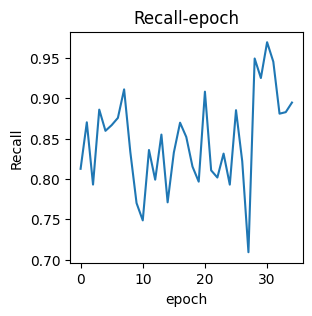

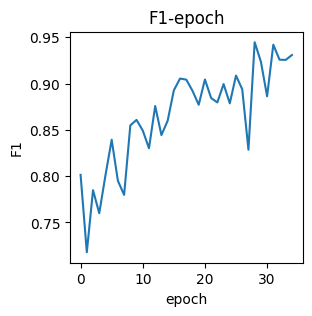

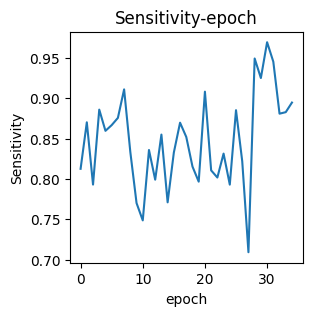

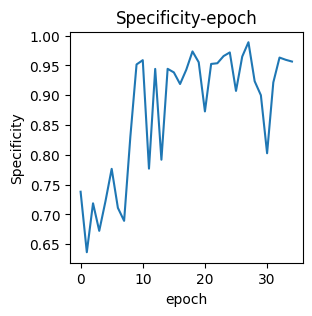

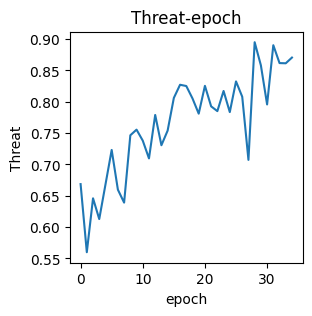

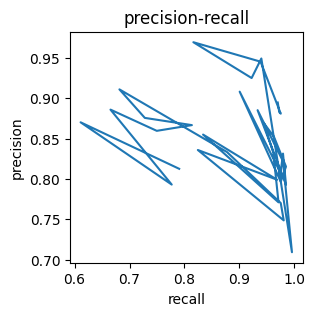

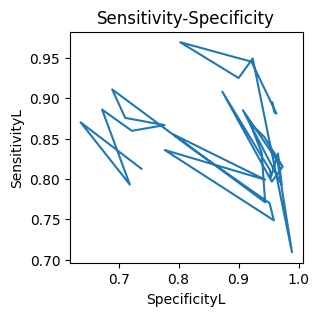

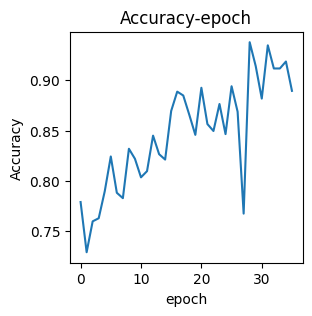

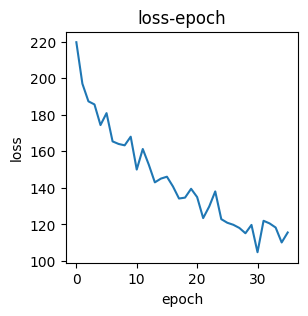

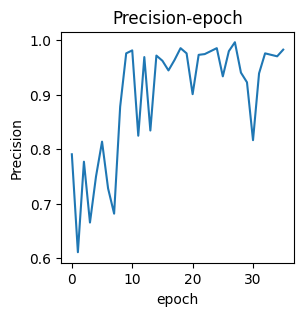

valid epoch[37/70]: 100%|██████████| 326/326 [00:06<00:00, 50.12it/s]
[epoch 37] loss: 0.302  accuracy: 0.937  Precision: 0.951  Recall: 0.938  F1: 0.944595  Sensitivity: 0.938  Specificity: 0.935  Threat: 0.895


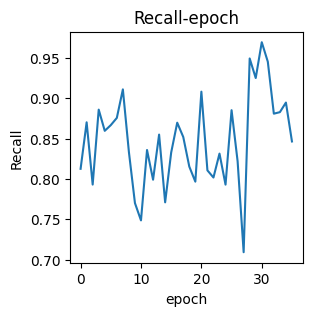

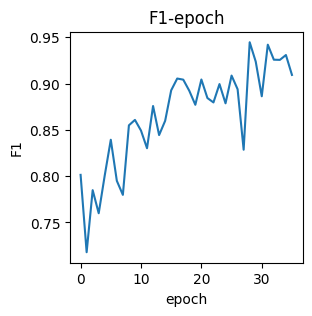

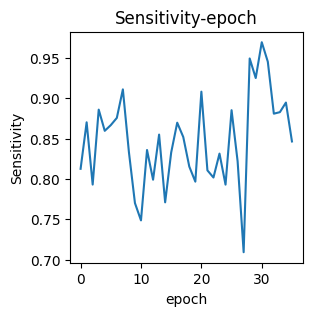

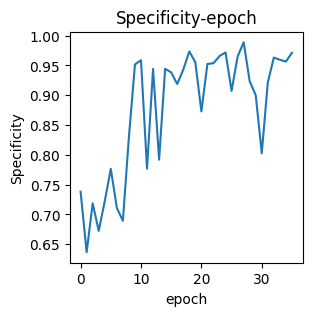

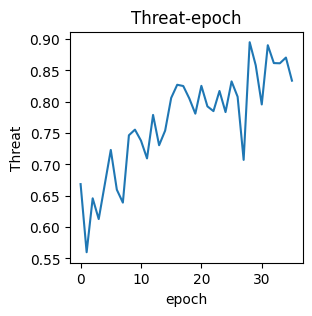

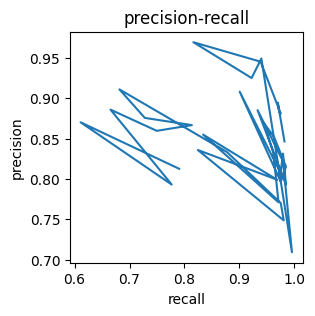

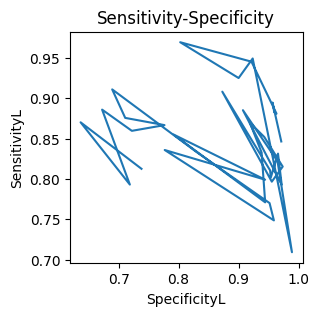

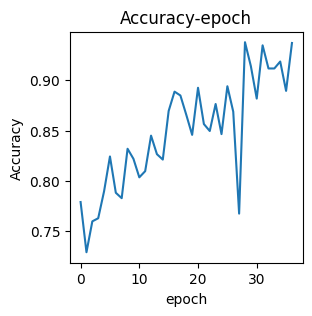

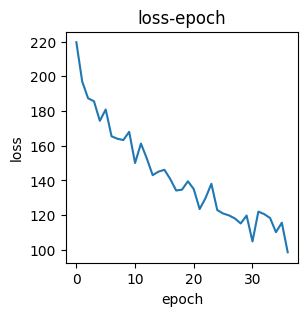

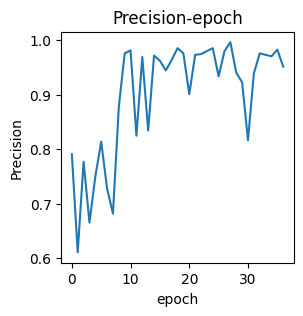

valid epoch[38/70]: 100%|██████████| 326/326 [00:06<00:00, 49.55it/s]
[epoch 38] loss: 0.334  accuracy: 0.940  Precision: 0.962  Recall: 0.934  F1: 0.947721  Sensitivity: 0.934  Specificity: 0.949  Threat: 0.901


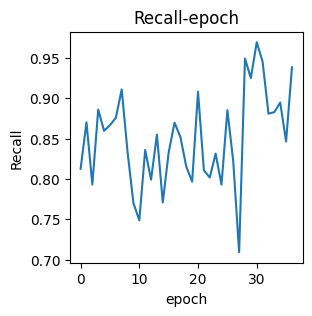

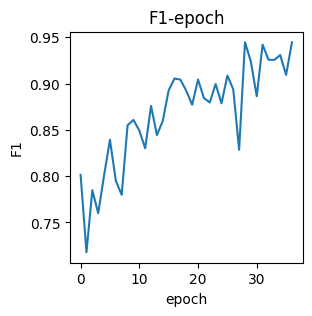

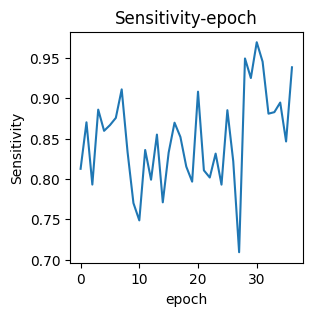

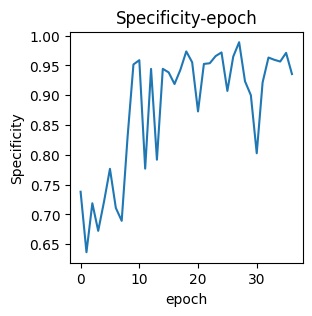

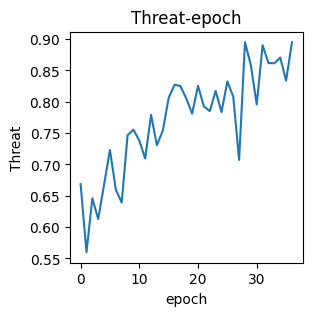

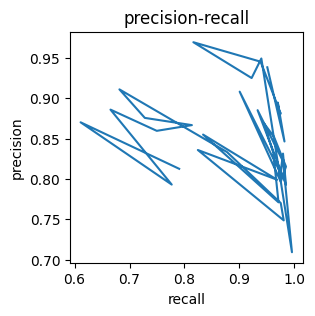

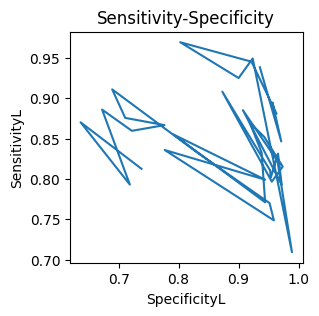

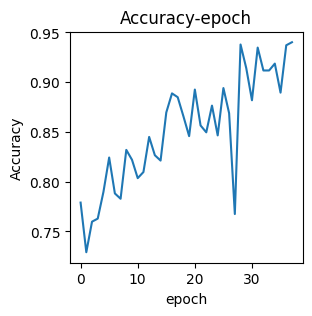

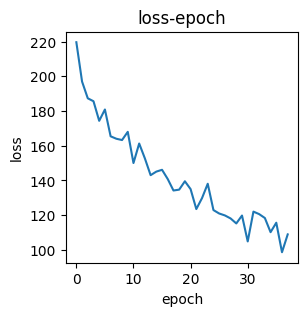

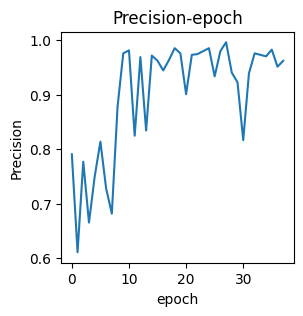

valid epoch[39/70]: 100%|██████████| 326/326 [00:06<00:00, 51.27it/s]
[epoch 39] loss: 0.306  accuracy: 0.879  Precision: 0.846  Recall: 0.933  F1: 0.887304  Sensitivity: 0.933  Specificity: 0.822  Threat: 0.797


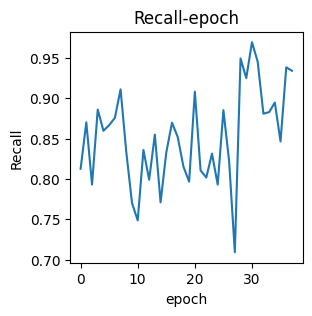

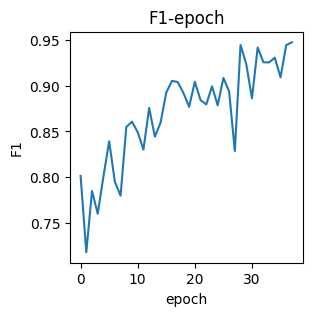

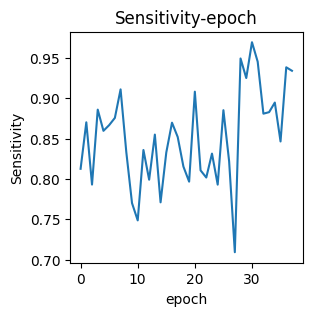

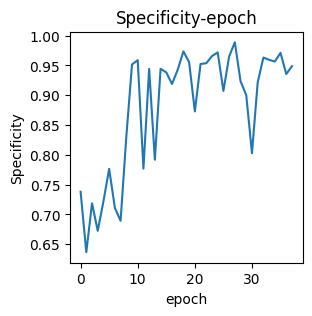

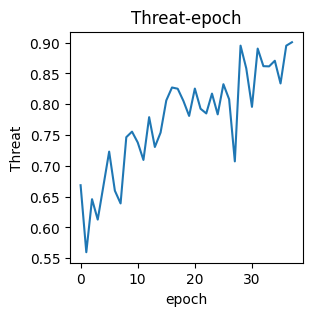

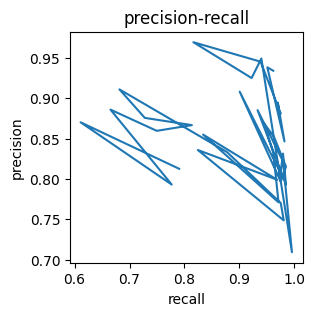

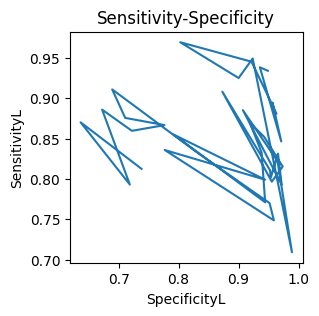

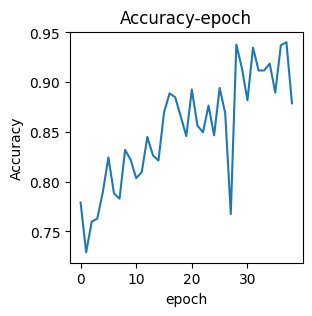

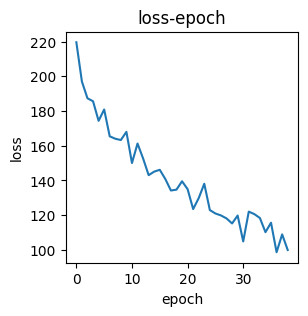

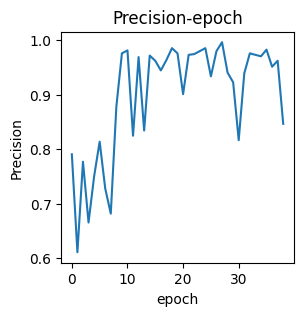

valid epoch[40/70]: 100%|██████████| 326/326 [00:06<00:00, 49.69it/s]
[epoch 40] loss: 0.300  accuracy: 0.924  Precision: 0.969  Recall: 0.904  F1: 0.934997  Sensitivity: 0.904  Specificity: 0.955  Threat: 0.878


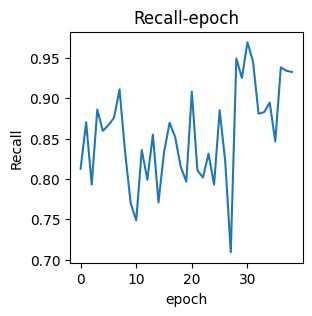

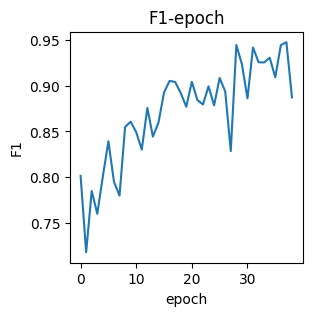

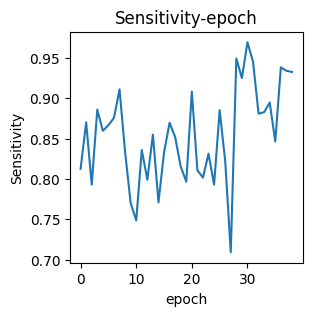

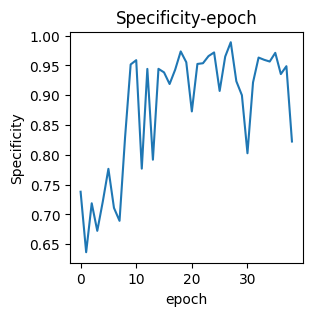

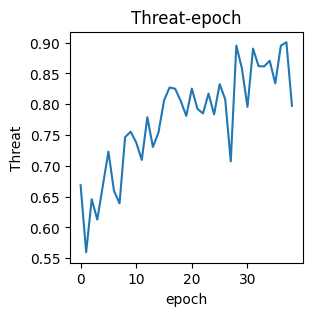

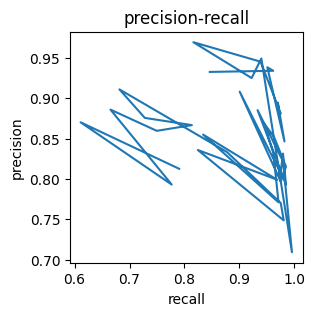

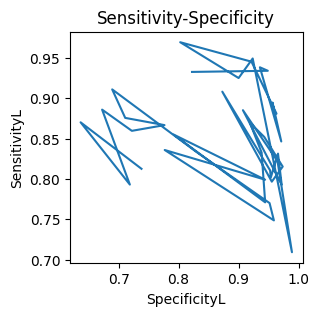

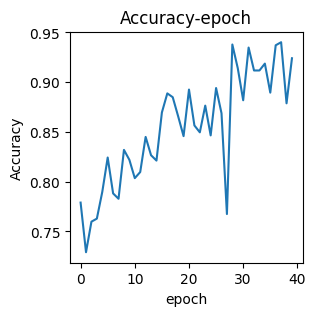

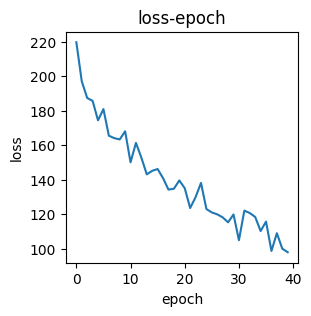

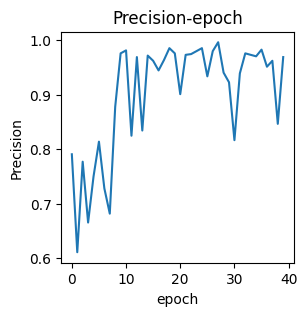

valid epoch[41/70]: 100%|██████████| 326/326 [00:06<00:00, 50.14it/s]
[epoch 41] loss: 0.313  accuracy: 0.948  Precision: 0.980  Recall: 0.931  F1: 0.954907  Sensitivity: 0.931  Specificity: 0.972  Threat: 0.914


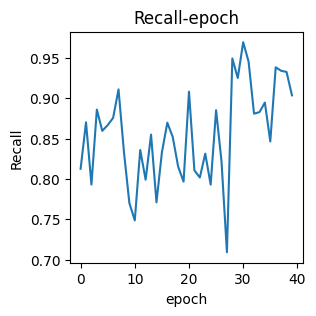

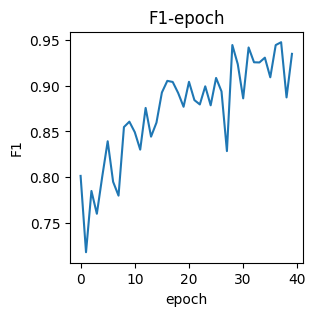

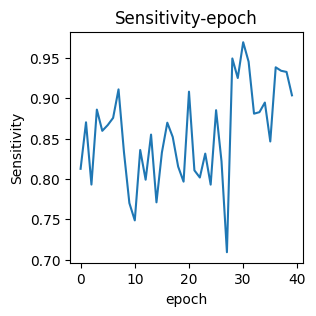

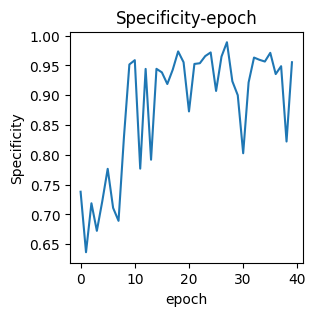

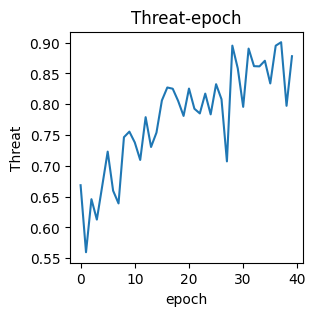

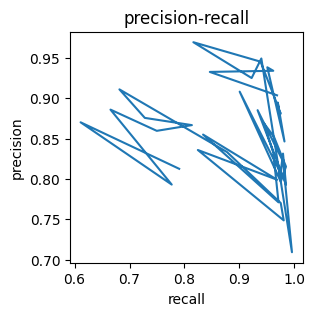

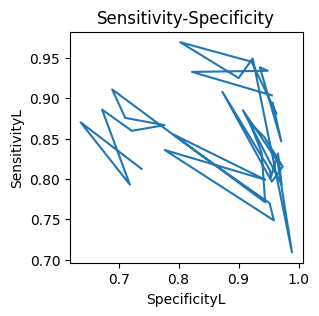

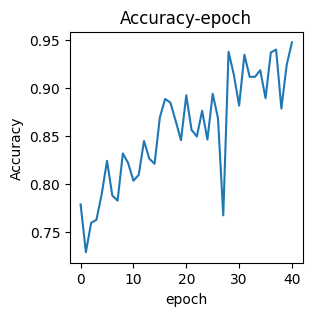

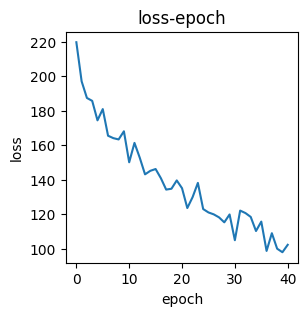

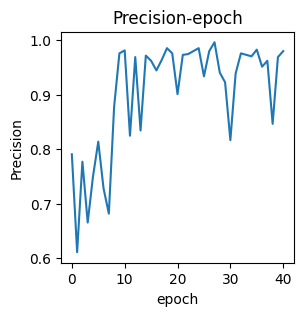

valid epoch[42/70]: 100%|██████████| 326/326 [00:06<00:00, 49.23it/s]
[epoch 42] loss: 0.300  accuracy: 0.946  Precision: 0.984  Recall: 0.925  F1: 0.953197  Sensitivity: 0.925  Specificity: 0.977  Threat: 0.911


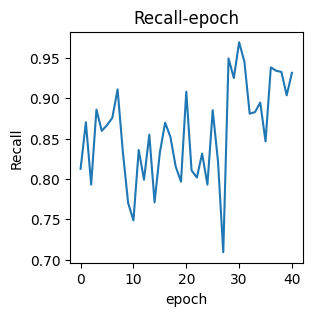

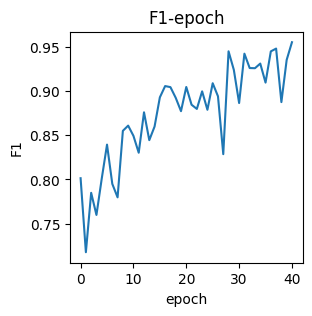

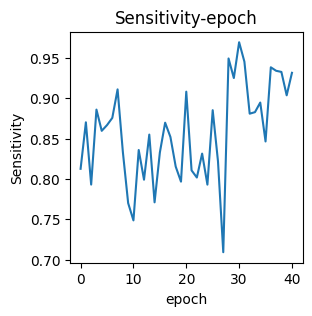

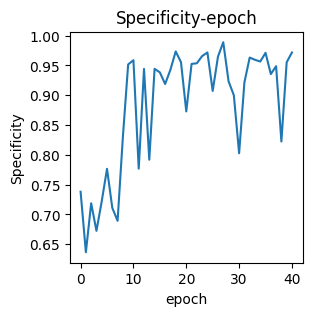

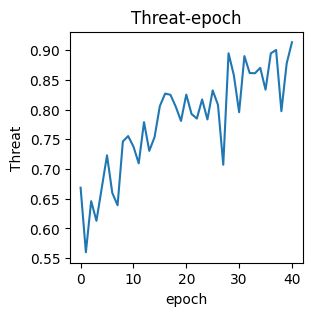

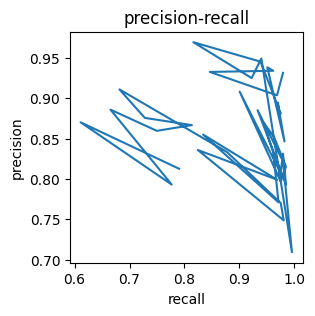

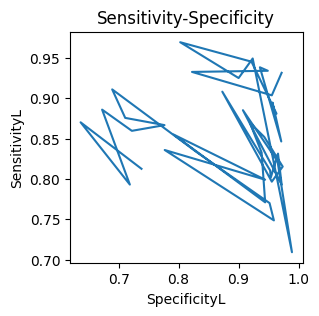

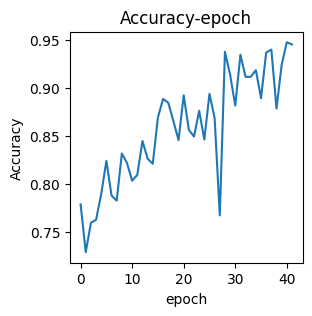

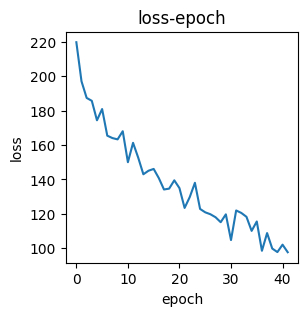

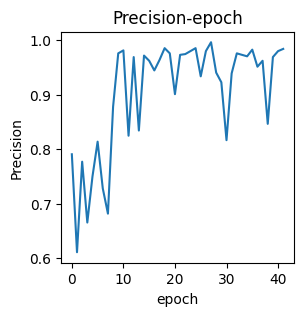

valid epoch[43/70]: 100%|██████████| 326/326 [00:06<00:00, 50.95it/s]
[epoch 43] loss: 0.295  accuracy: 0.940  Precision: 0.924  Recall: 0.969  F1: 0.945682  Sensitivity: 0.969  Specificity: 0.907  Threat: 0.897


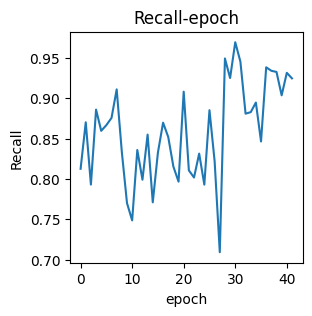

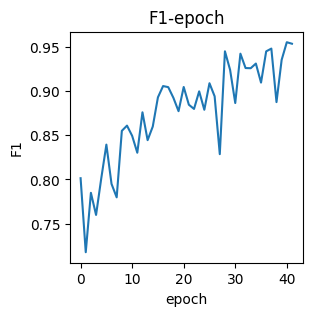

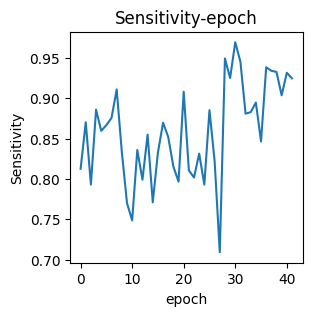

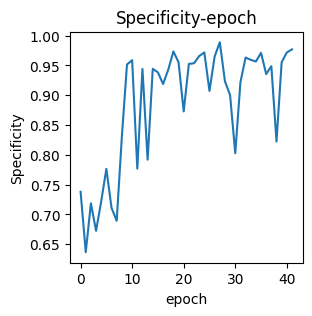

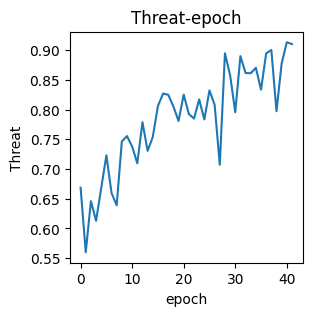

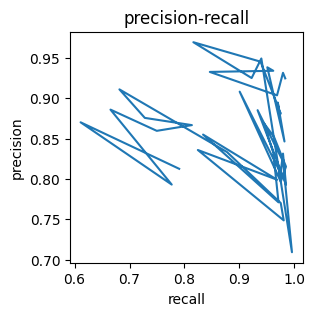

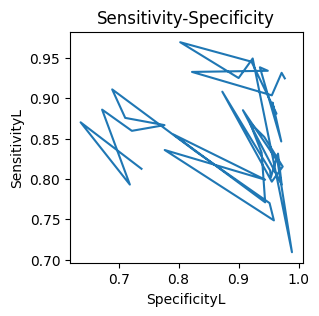

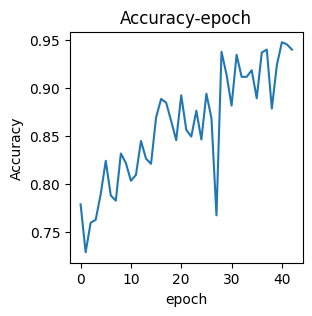

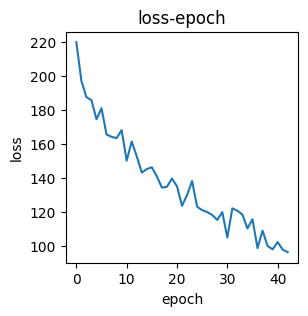

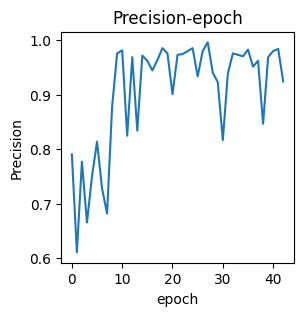

valid epoch[44/70]: 100%|██████████| 326/326 [00:06<00:00, 51.57it/s]
[epoch 44] loss: 0.278  accuracy: 0.946  Precision: 0.954  Recall: 0.950  F1: 0.951799  Sensitivity: 0.950  Specificity: 0.940  Threat: 0.908


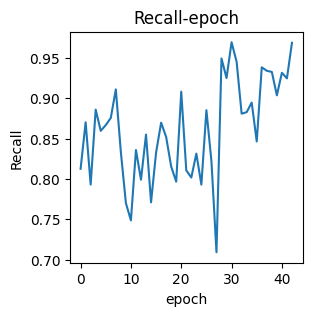

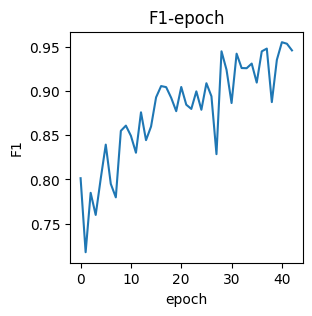

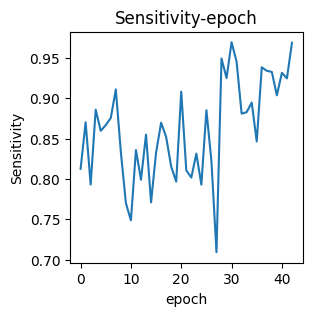

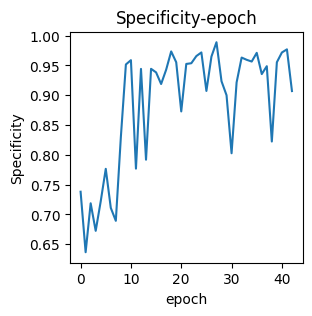

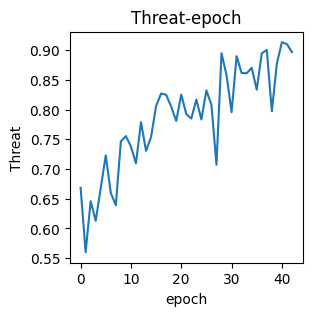

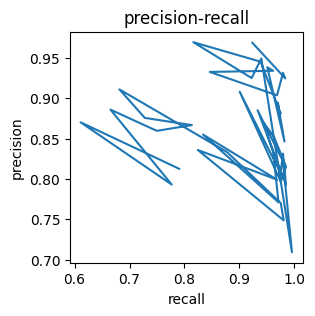

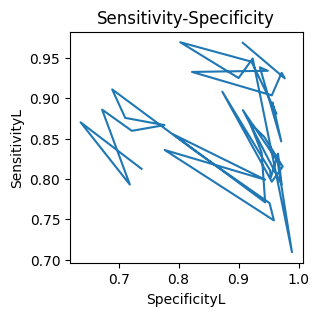

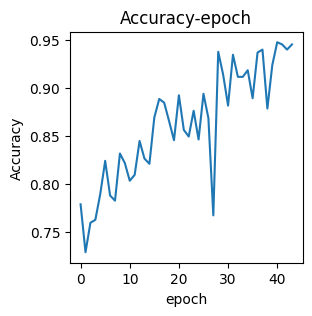

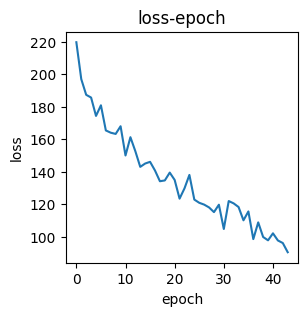

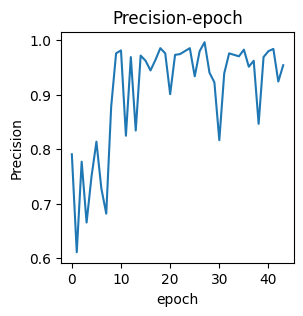

valid epoch[45/70]: 100%|██████████| 326/326 [00:06<00:00, 48.76it/s]
[epoch 45] loss: 0.293  accuracy: 0.946  Precision: 0.955  Recall: 0.949  F1: 0.951864  Sensitivity: 0.949  Specificity: 0.941  Threat: 0.908


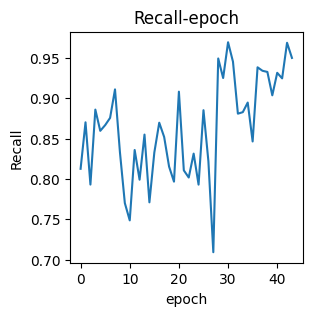

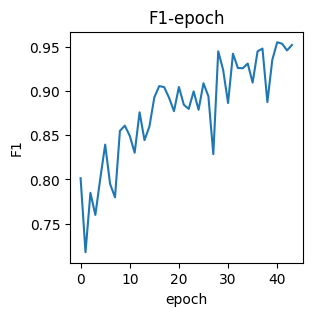

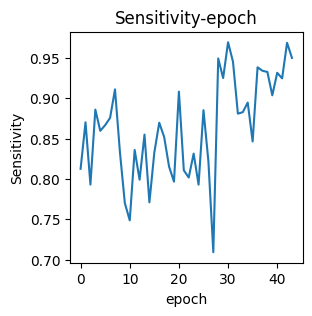

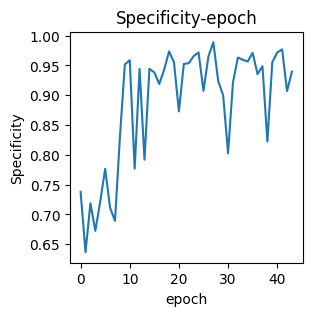

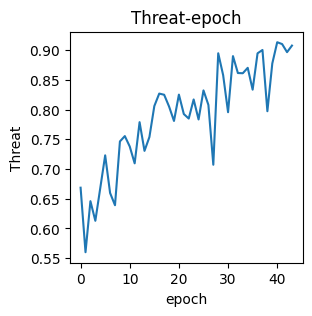

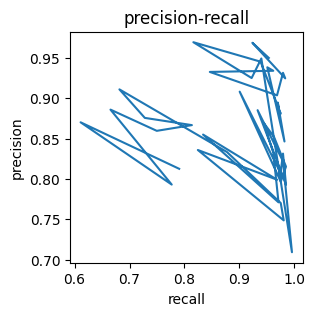

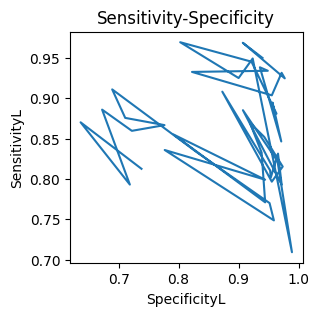

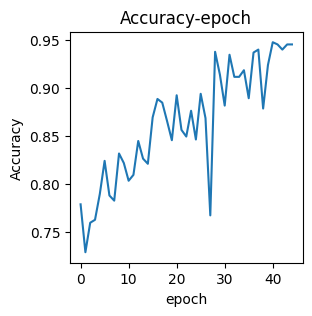

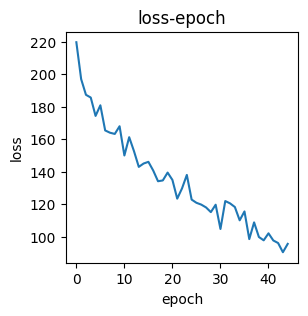

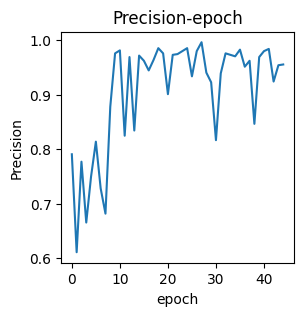

valid epoch[46/70]: 100%|██████████| 326/326 [00:06<00:00, 49.17it/s]
[epoch 46] loss: 0.278  accuracy: 0.958  Precision: 0.981  Recall: 0.946  F1: 0.963260  Sensitivity: 0.946  Specificity: 0.974  Threat: 0.929


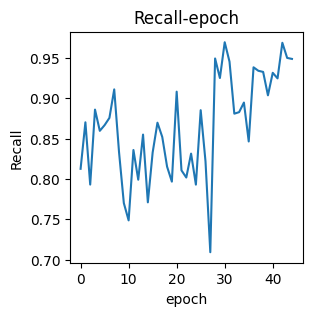

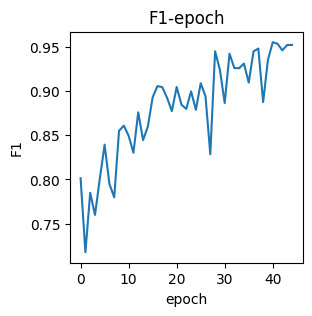

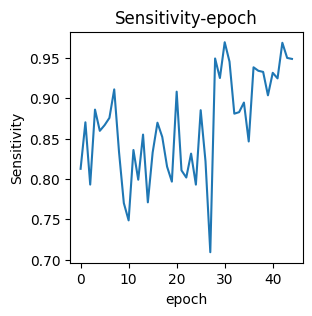

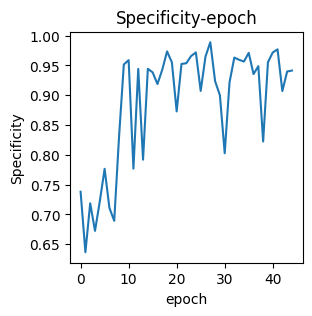

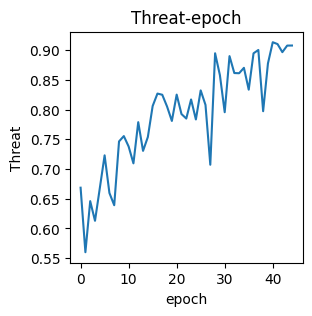

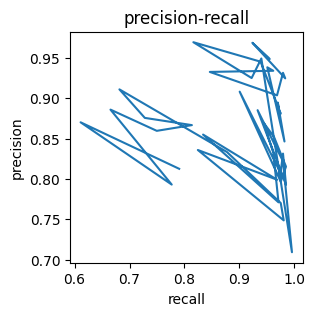

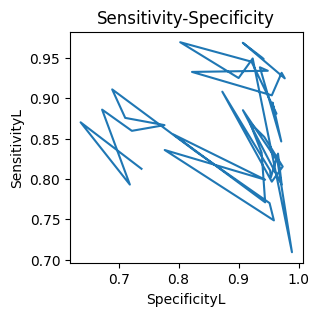

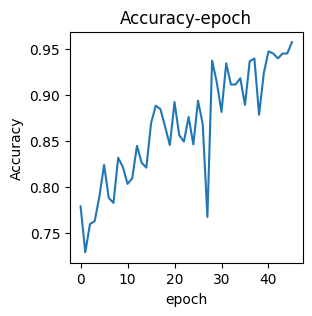

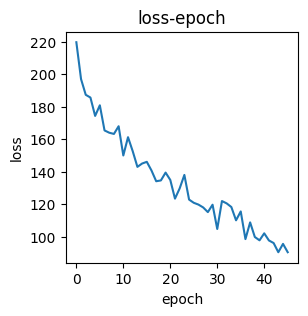

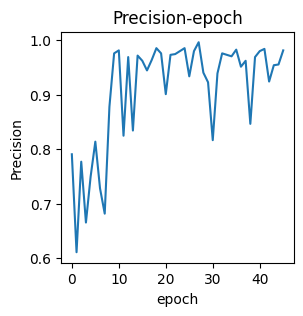

valid epoch[47/70]: 100%|██████████| 326/326 [00:06<00:00, 51.07it/s]
[epoch 47] loss: 0.294  accuracy: 0.936  Precision: 0.950  Recall: 0.937  F1: 0.943243  Sensitivity: 0.937  Specificity: 0.934  Threat: 0.893


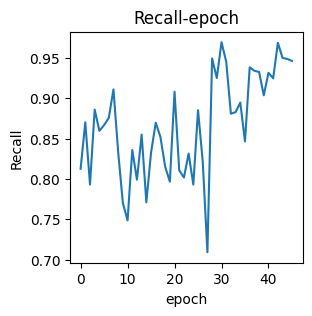

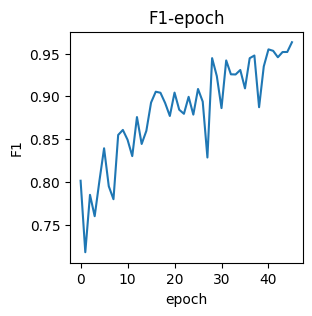

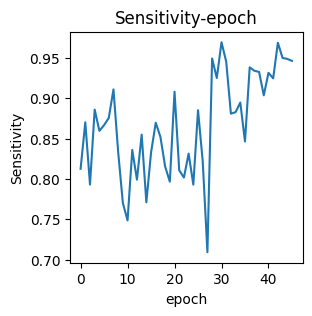

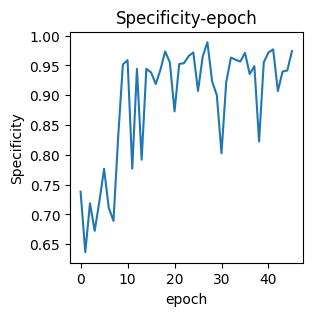

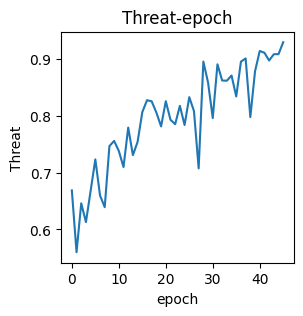

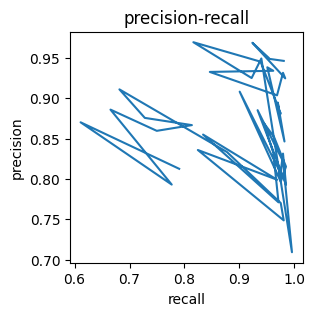

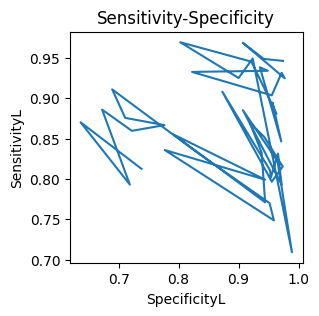

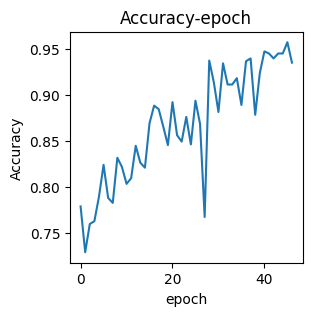

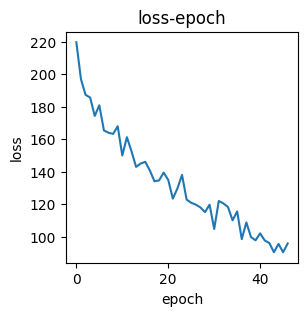

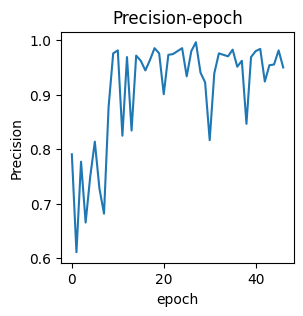

valid epoch[48/70]: 100%|██████████| 326/326 [00:06<00:00, 52.19it/s]
[epoch 48] loss: 0.261  accuracy: 0.915  Precision: 0.989  Recall: 0.876  F1: 0.929073  Sensitivity: 0.876  Specificity: 0.983  Threat: 0.868


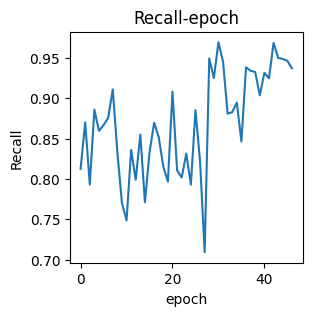

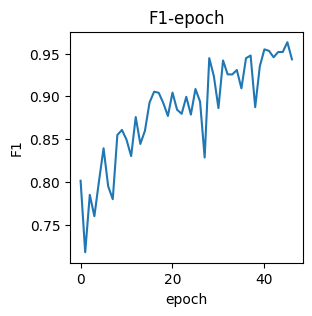

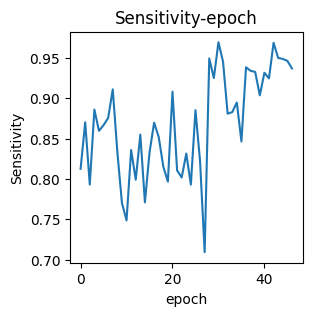

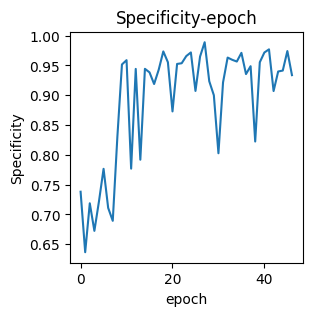

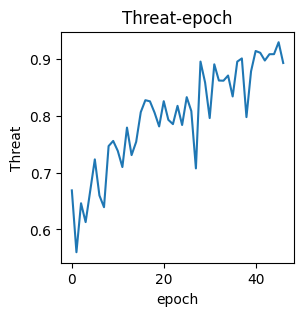

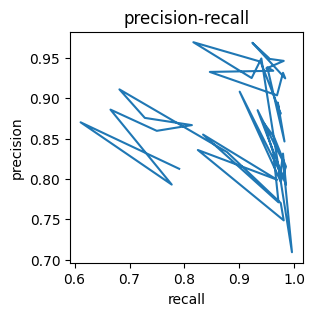

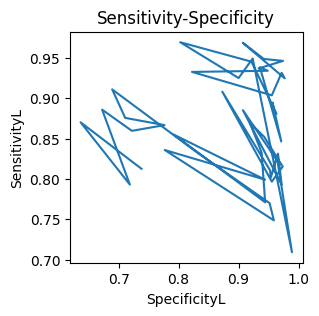

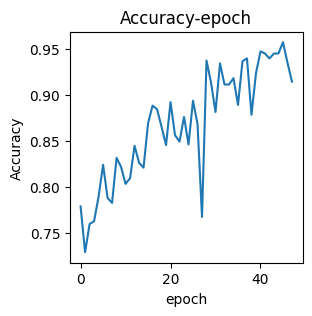

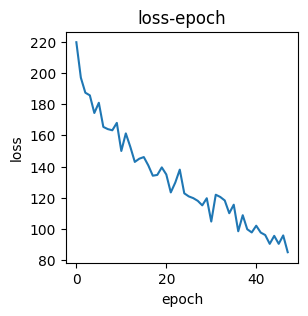

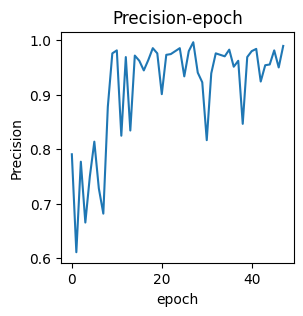

valid epoch[49/70]: 100%|██████████| 326/326 [00:06<00:00, 50.08it/s]
[epoch 49] loss: 0.279  accuracy: 0.870  Precision: 0.997  Recall: 0.814  F1: 0.896088  Sensitivity: 0.814  Specificity: 0.995  Threat: 0.812


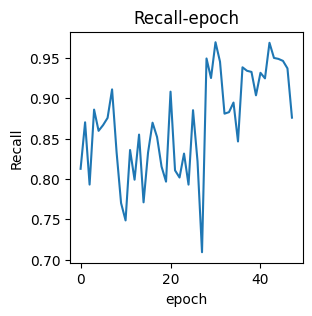

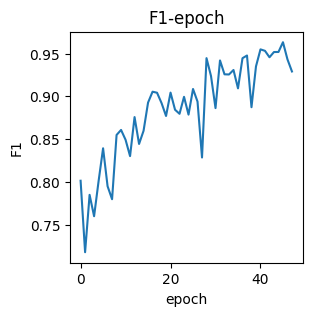

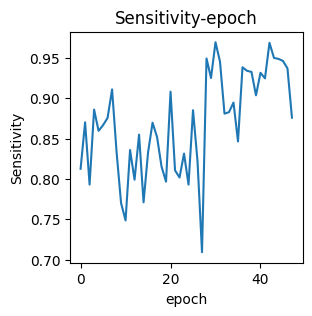

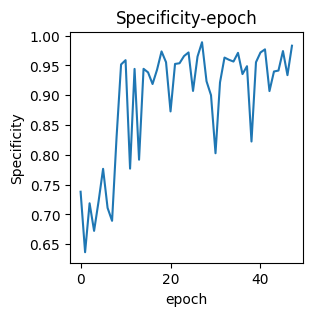

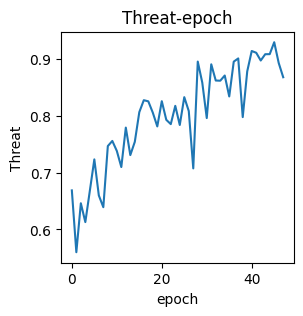

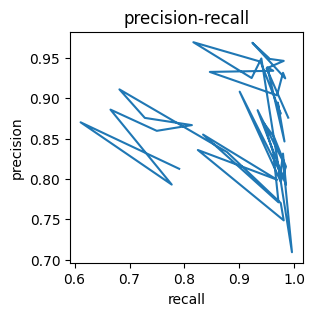

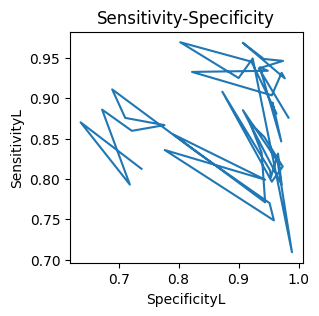

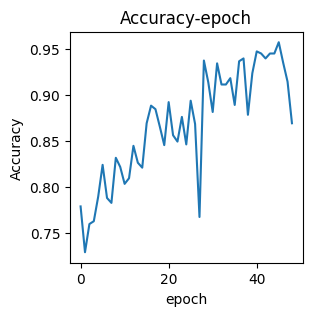

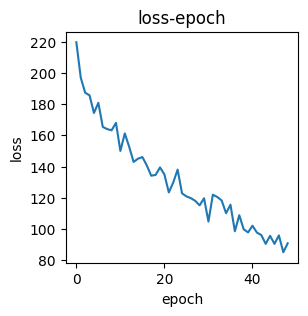

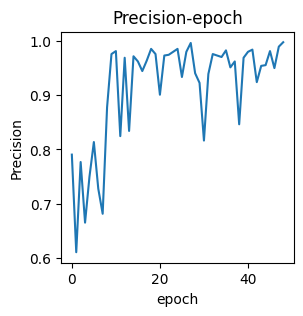

valid epoch[50/70]: 100%|██████████| 326/326 [00:06<00:00, 46.92it/s]
[epoch 50] loss: 0.273  accuracy: 0.919  Precision: 0.971  Recall: 0.895  F1: 0.931507  Sensitivity: 0.895  Specificity: 0.958  Threat: 0.872


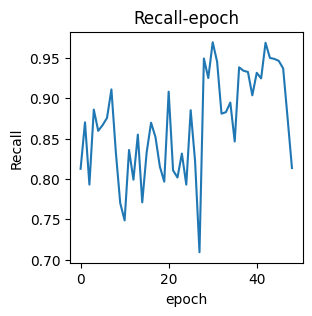

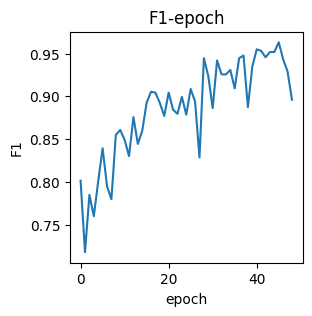

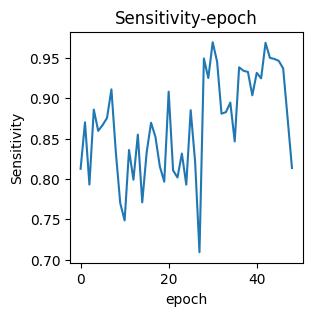

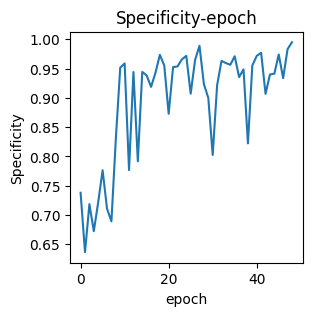

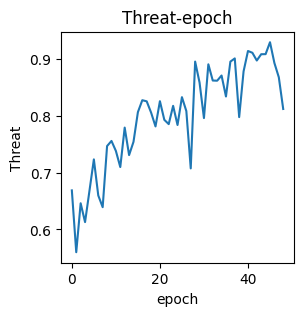

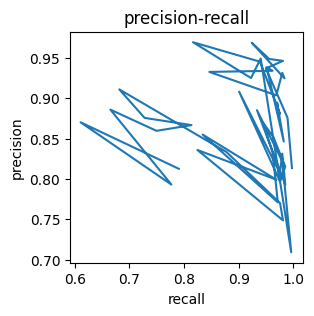

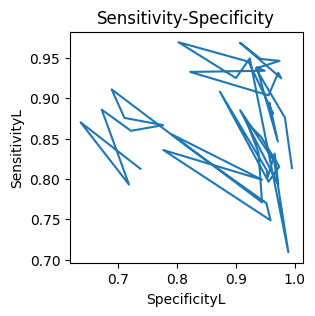

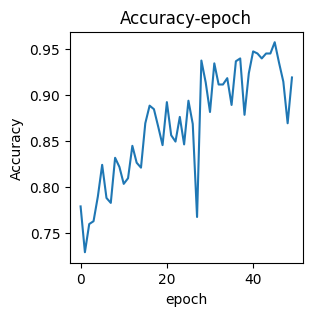

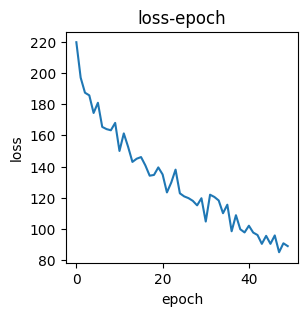

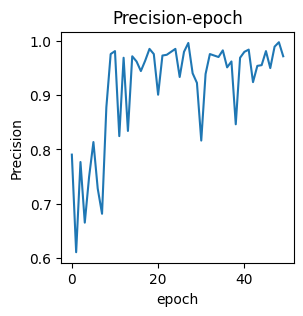

valid epoch[51/70]: 100%|██████████| 326/326 [00:06<00:00, 47.88it/s]
[epoch 51] loss: 0.266  accuracy: 0.965  Precision: 0.988  Recall: 0.952  F1: 0.969292  Sensitivity: 0.952  Specificity: 0.983  Threat: 0.940


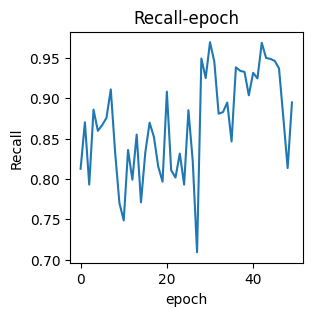

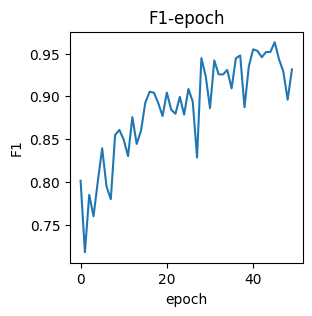

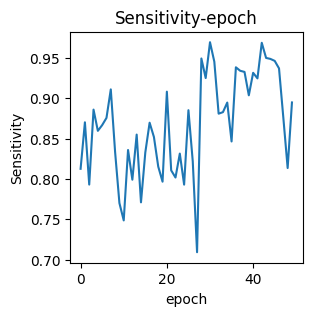

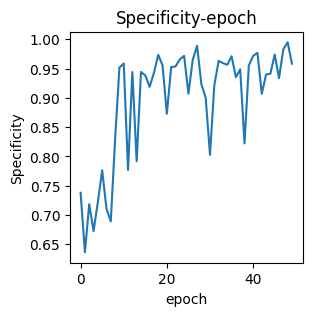

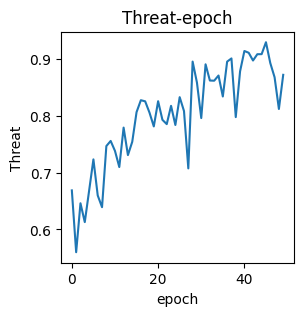

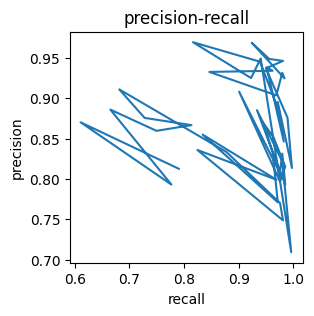

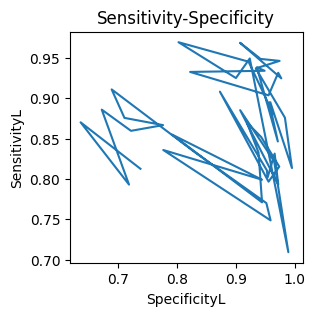

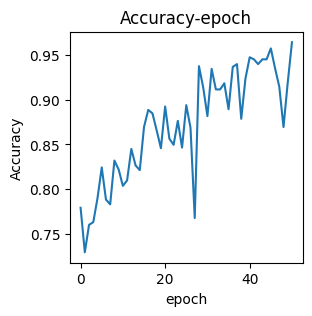

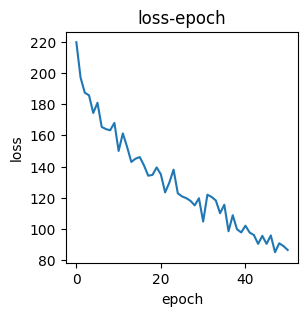

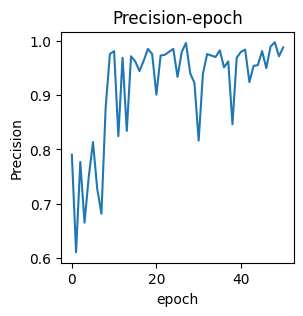

valid epoch[52/70]: 100%|██████████| 326/326 [00:06<00:00, 51.12it/s]
[epoch 52] loss: 0.261  accuracy: 0.924  Precision: 0.992  Recall: 0.887  F1: 0.936416  Sensitivity: 0.887  Specificity: 0.988  Threat: 0.880


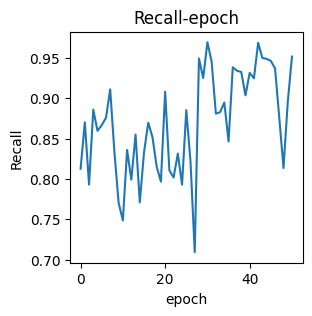

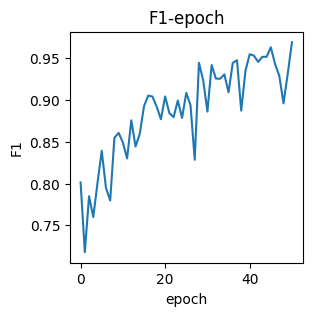

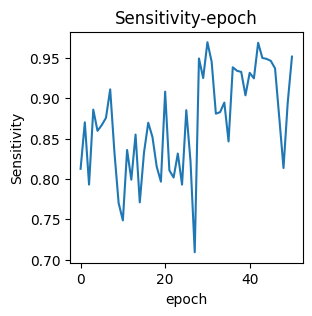

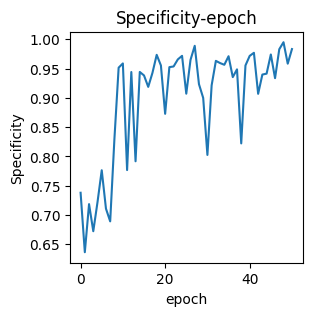

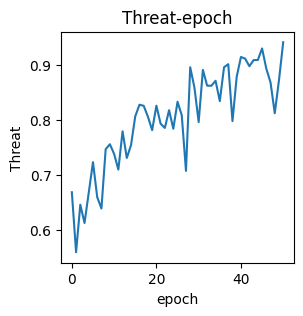

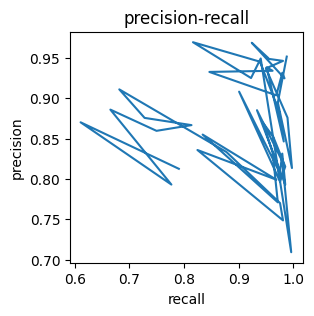

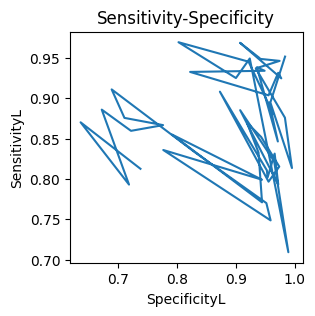

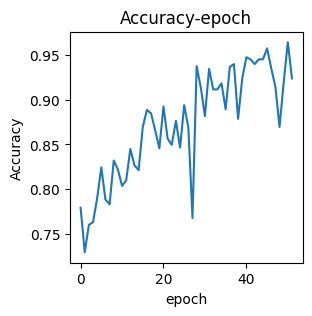

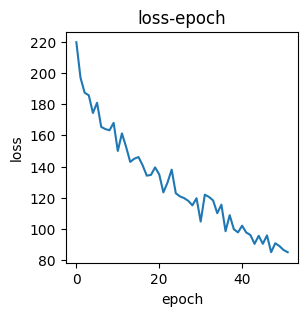

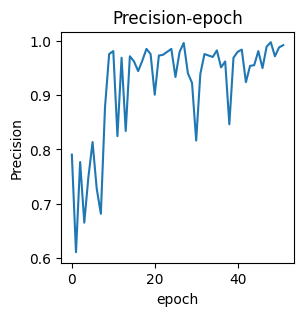

valid epoch[53/70]: 100%|██████████| 326/326 [00:06<00:00, 50.88it/s]
[epoch 53] loss: 0.295  accuracy: 0.928  Precision: 0.986  Recall: 0.896  F1: 0.939119  Sensitivity: 0.896  Specificity: 0.980  Threat: 0.885


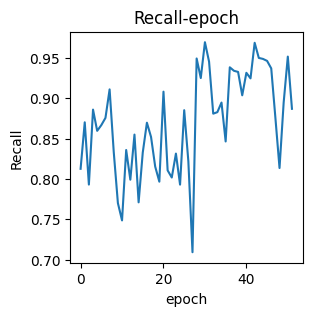

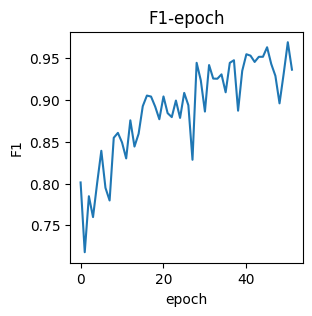

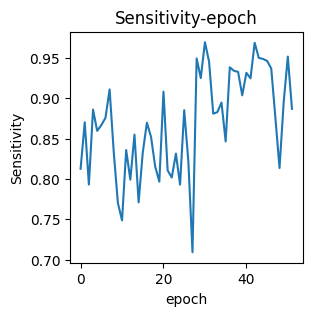

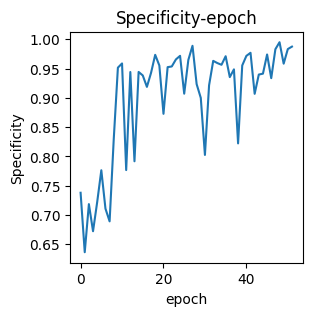

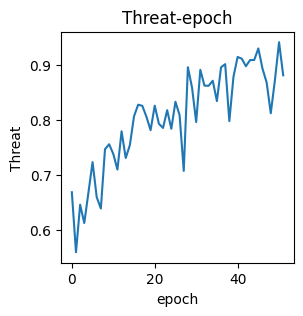

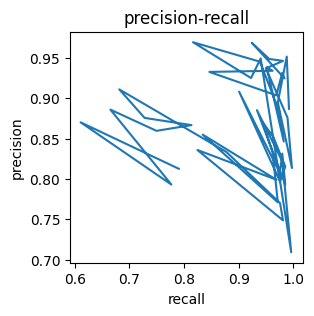

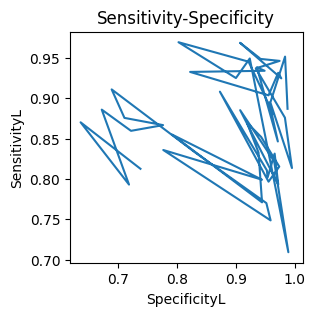

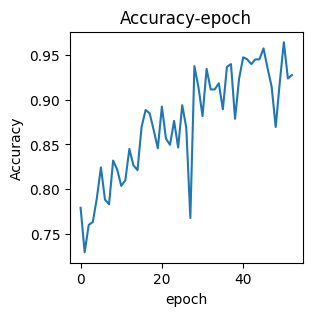

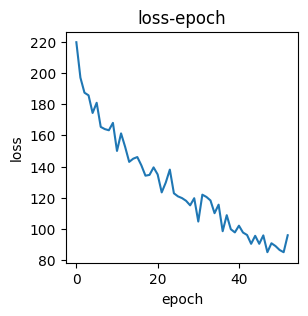

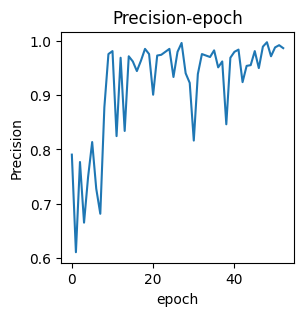

valid epoch[54/70]: 100%|██████████| 326/326 [00:06<00:00, 50.20it/s]
[epoch 54] loss: 0.233  accuracy: 0.911  Precision: 0.992  Recall: 0.869  F1: 0.926302  Sensitivity: 0.869  Specificity: 0.987  Threat: 0.863


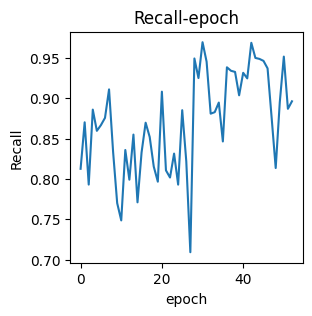

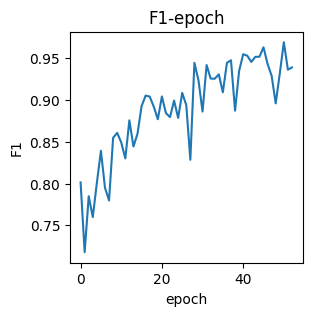

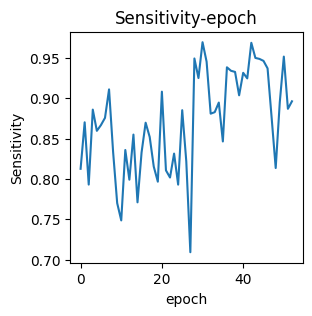

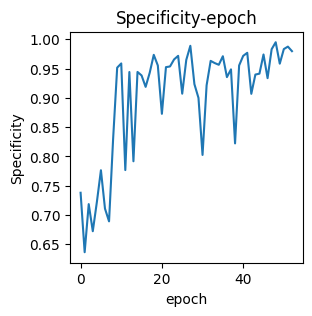

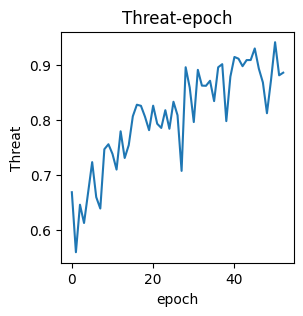

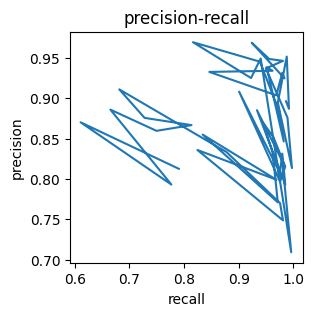

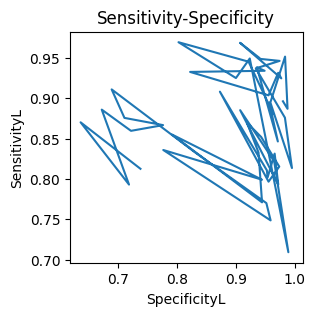

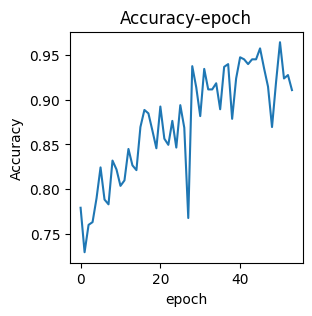

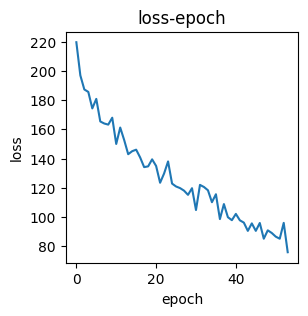

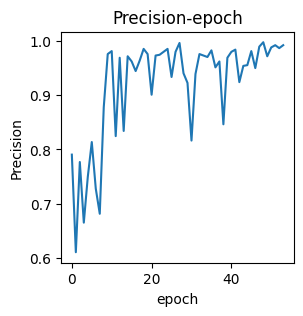

valid epoch[55/70]: 100%|██████████| 326/326 [00:06<00:00, 46.88it/s]
[epoch 55] loss: 0.242  accuracy: 0.912  Precision: 0.993  Recall: 0.869  F1: 0.926984  Sensitivity: 0.869  Specificity: 0.989  Threat: 0.864


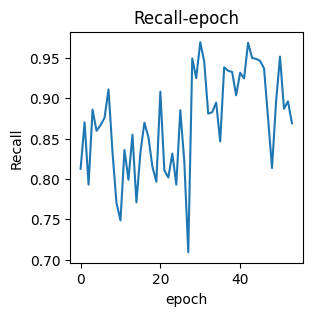

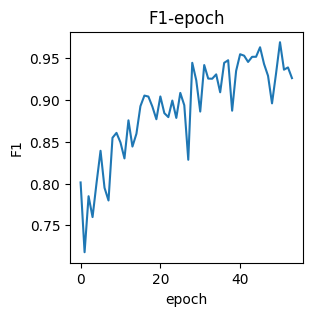

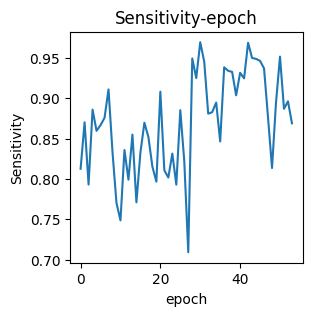

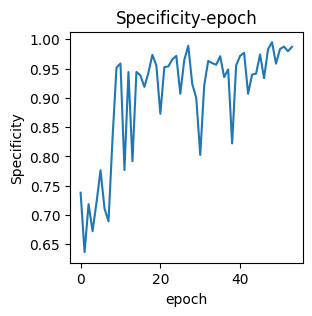

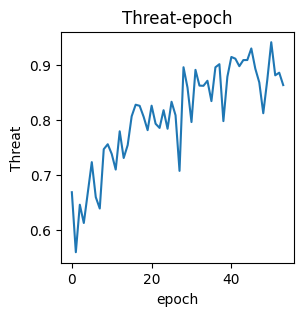

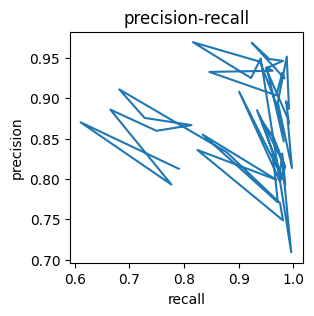

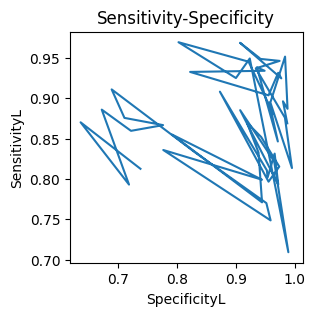

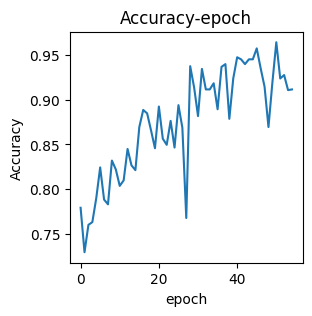

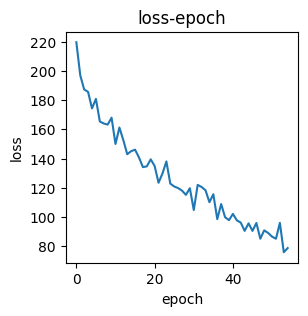

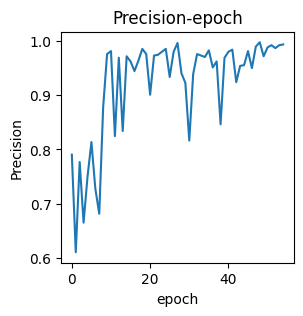

valid epoch[56/70]: 100%|██████████| 326/326 [00:06<00:00, 51.25it/s]
[epoch 56] loss: 0.270  accuracy: 0.935  Precision: 0.986  Recall: 0.906  F1: 0.944625  Sensitivity: 0.906  Specificity: 0.980  Threat: 0.895


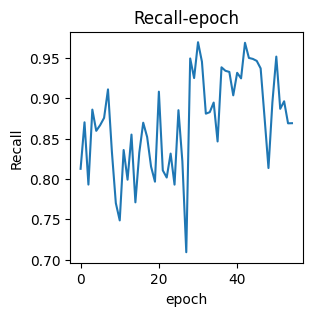

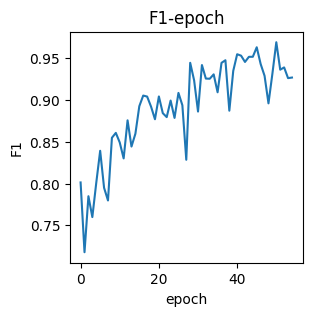

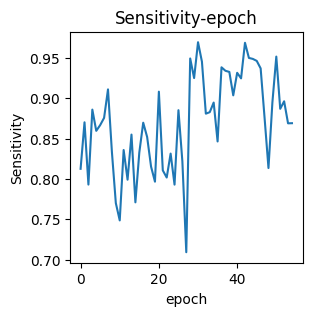

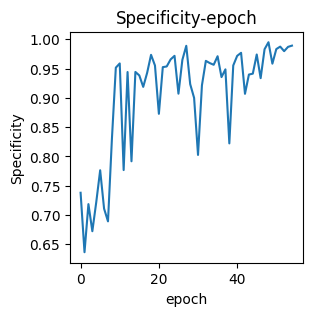

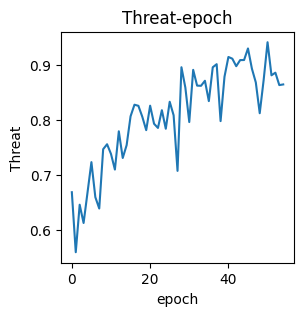

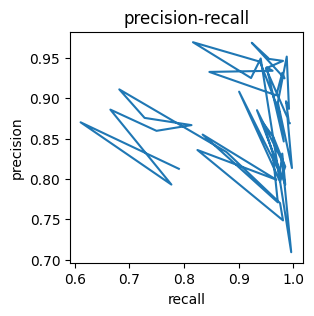

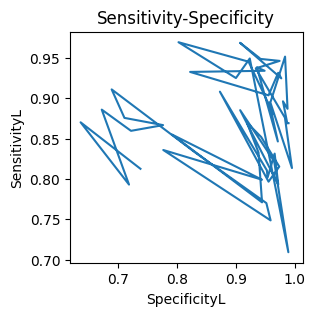

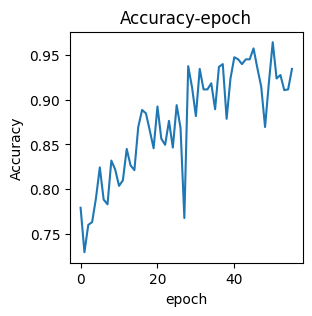

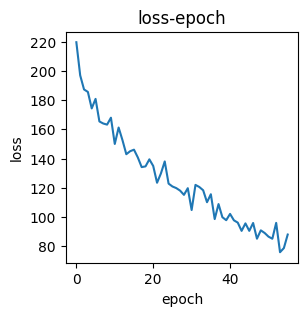

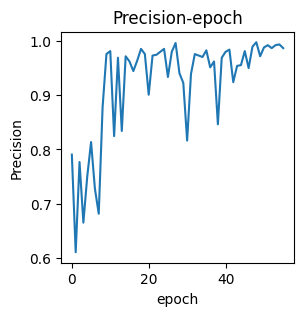

valid epoch[57/70]: 100%|██████████| 326/326 [00:06<00:00, 50.85it/s]
[epoch 57] loss: 0.220  accuracy: 0.903  Precision: 0.997  Recall: 0.855  F1: 0.920854  Sensitivity: 0.855  Specificity: 0.996  Threat: 0.853


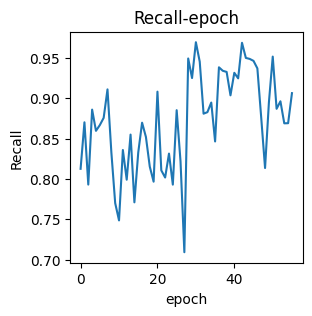

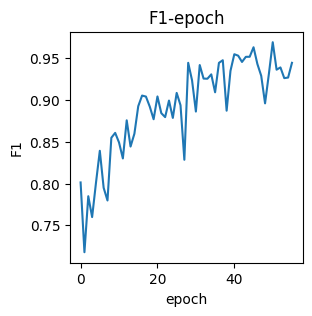

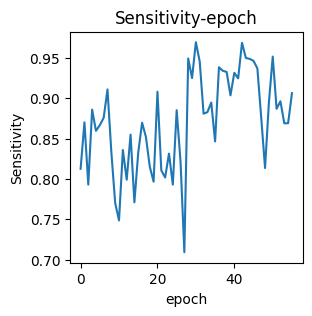

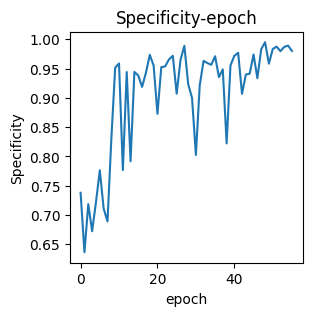

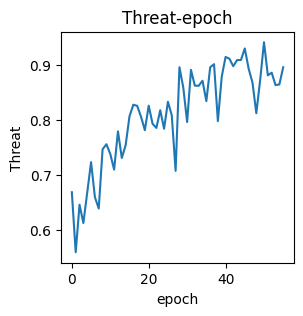

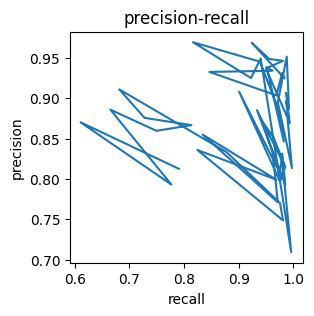

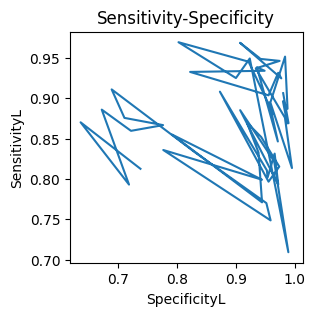

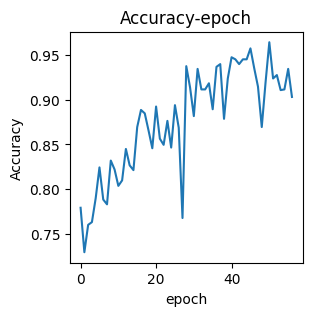

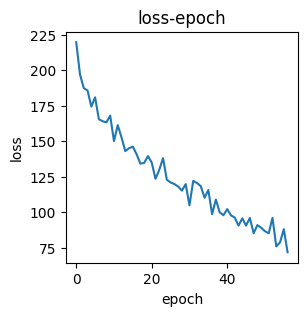

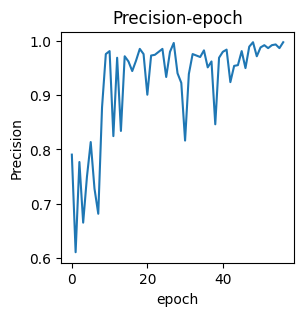

valid epoch[58/70]: 100%|██████████| 326/326 [00:06<00:00, 51.26it/s]
[epoch 58] loss: 0.227  accuracy: 0.961  Precision: 0.971  Recall: 0.960  F1: 0.965517  Sensitivity: 0.960  Specificity: 0.962  Threat: 0.933


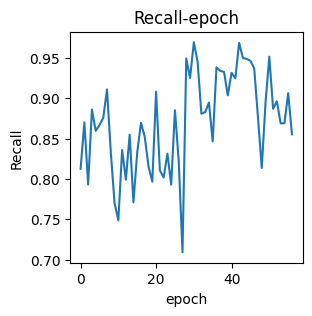

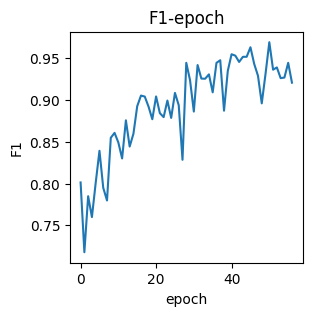

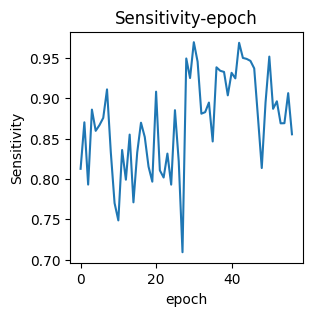

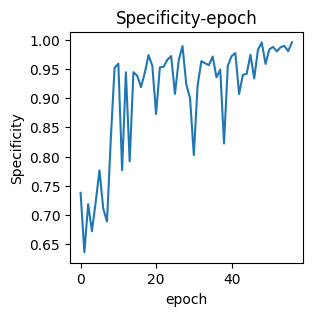

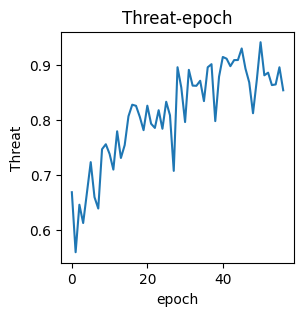

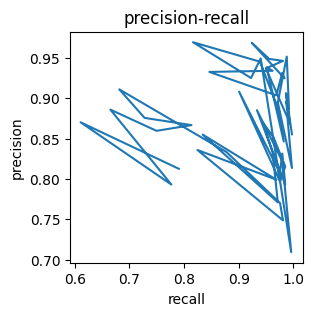

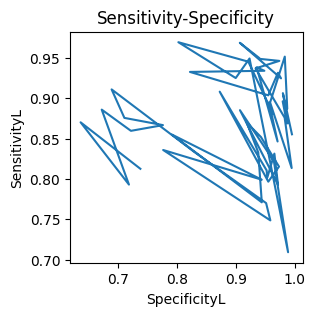

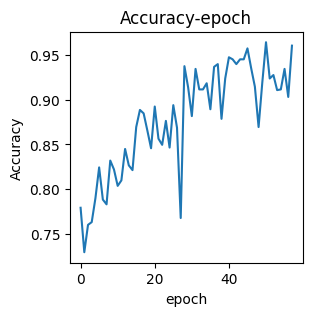

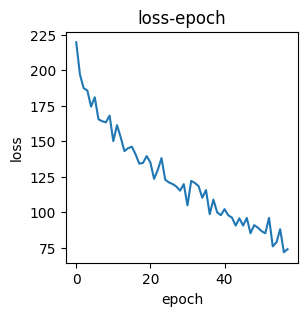

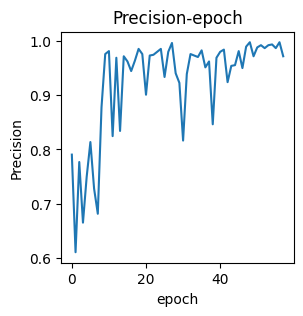

valid epoch[59/70]: 100%|██████████| 326/326 [00:06<00:00, 49.71it/s]
[epoch 59] loss: 0.227  accuracy: 0.951  Precision: 0.984  Recall: 0.933  F1: 0.957616  Sensitivity: 0.933  Specificity: 0.977  Threat: 0.919


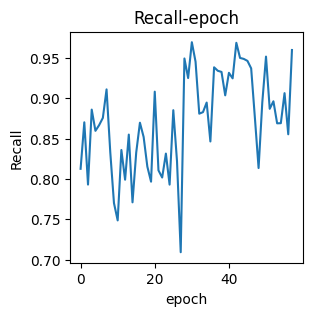

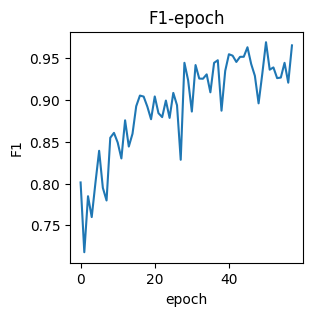

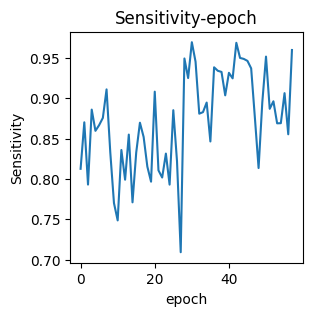

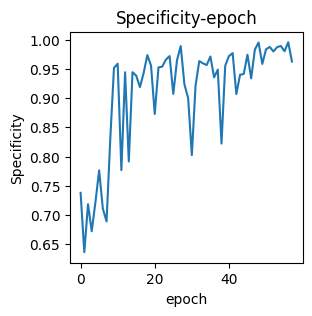

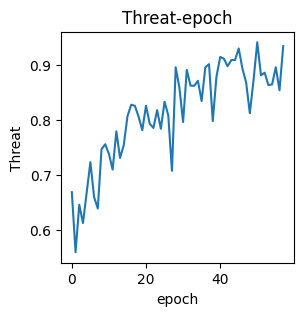

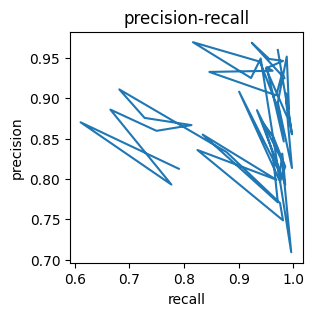

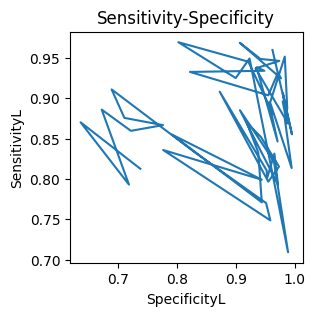

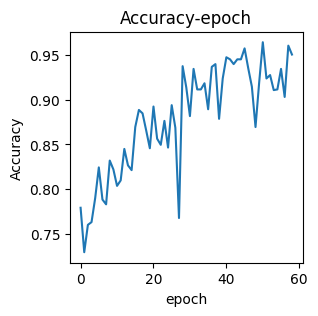

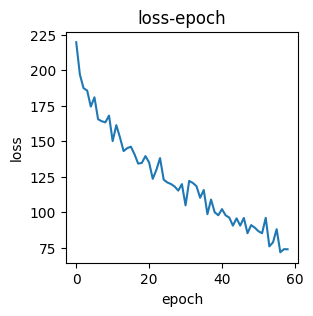

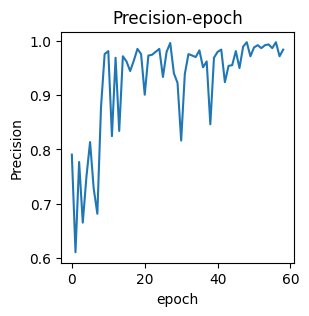

valid epoch[60/70]: 100%|██████████| 326/326 [00:06<00:00, 52.79it/s]
[epoch 60] loss: 0.237  accuracy: 0.955  Precision: 0.978  Recall: 0.944  F1: 0.960588  Sensitivity: 0.944  Specificity: 0.970  Threat: 0.924


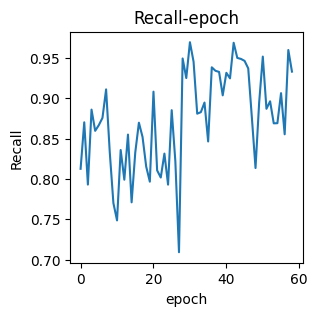

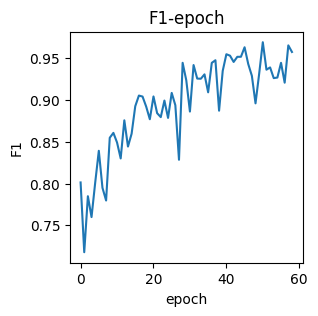

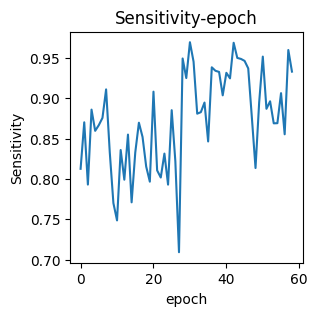

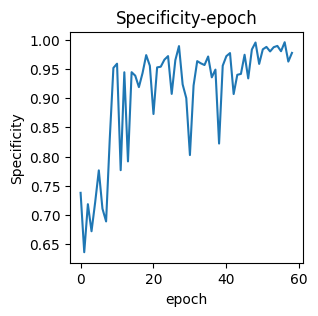

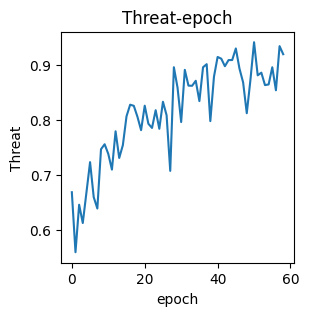

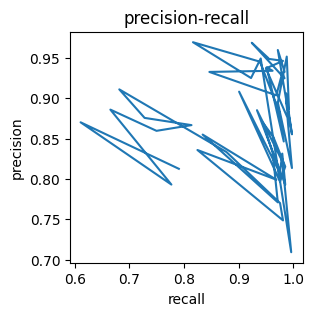

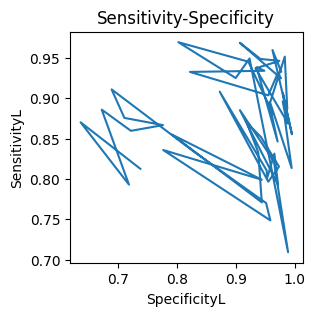

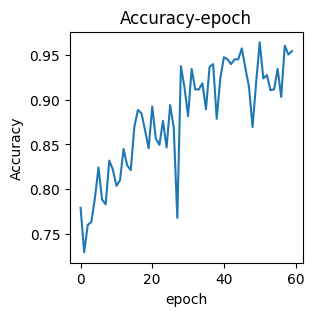

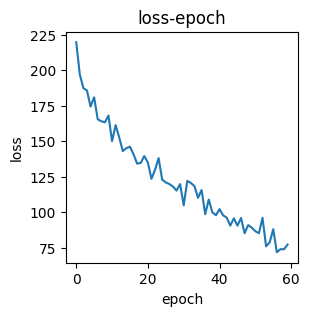

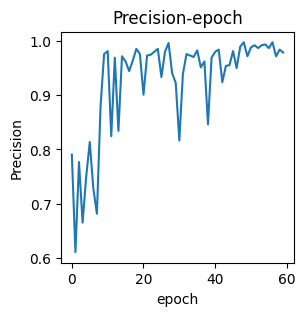

valid epoch[61/70]: 100%|██████████| 326/326 [00:06<00:00, 50.46it/s]
[epoch 61] loss: 0.245  accuracy: 0.939  Precision: 0.917  Recall: 0.973  F1: 0.943978  Sensitivity: 0.973  Specificity: 0.900  Threat: 0.894


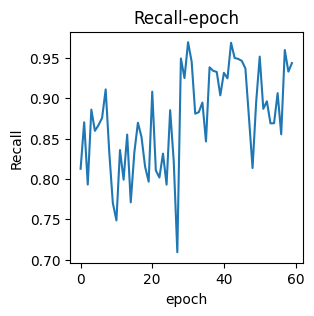

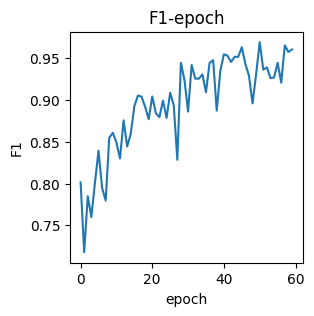

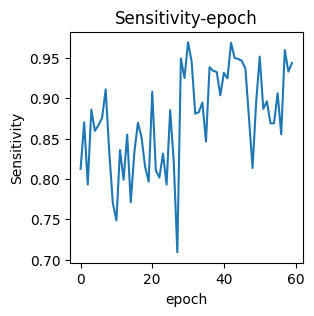

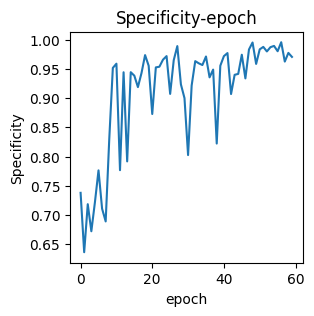

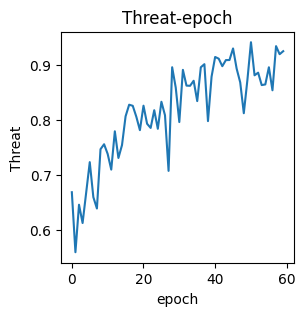

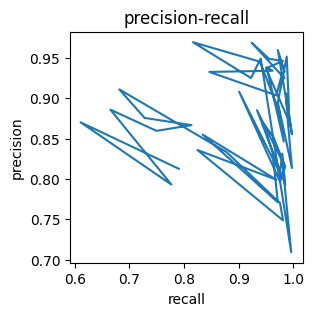

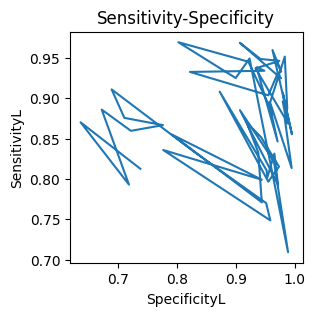

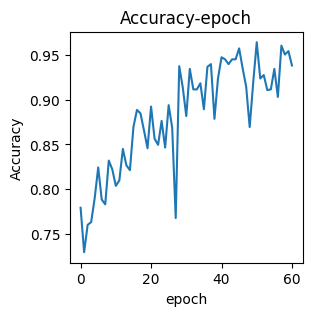

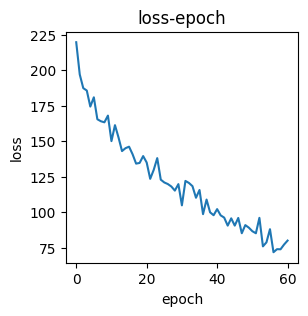

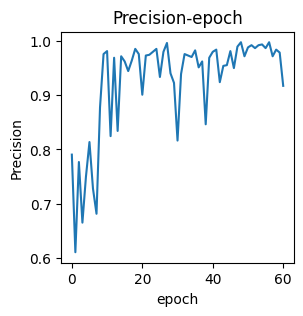

valid epoch[62/70]: 100%|██████████| 326/326 [00:06<00:00, 50.90it/s]
[epoch 62] loss: 0.240  accuracy: 0.953  Precision: 0.929  Recall: 0.987  F1: 0.957253  Sensitivity: 0.987  Specificity: 0.915  Threat: 0.918


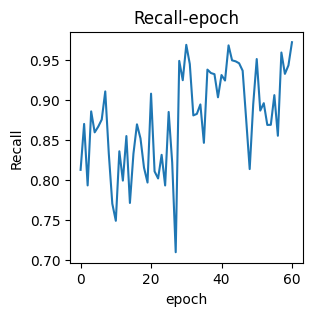

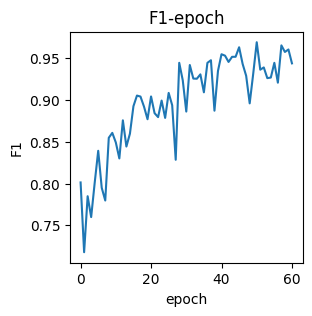

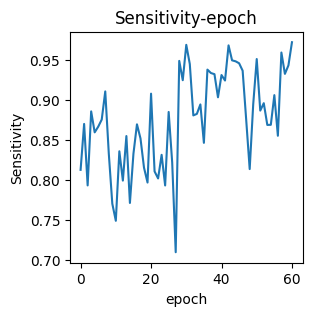

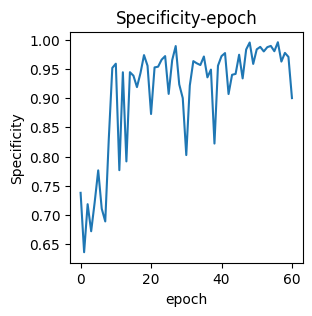

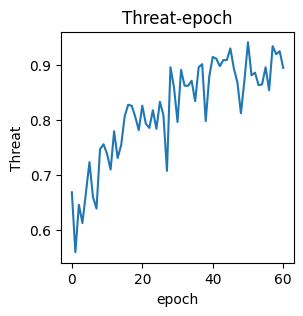

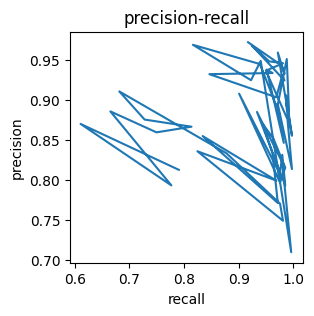

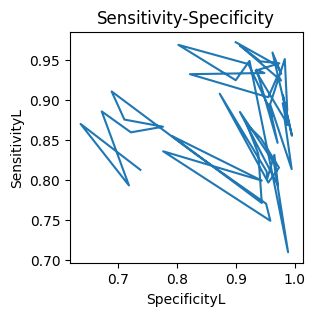

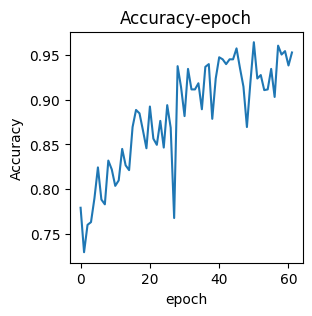

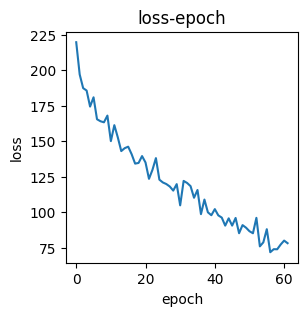

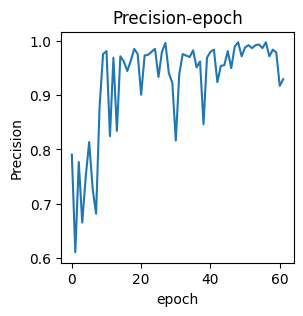

valid epoch[63/70]: 100%|██████████| 326/326 [00:06<00:00, 51.77it/s]
[epoch 63] loss: 0.223  accuracy: 0.965  Precision: 0.954  Recall: 0.985  F1: 0.968901  Sensitivity: 0.985  Specificity: 0.942  Threat: 0.940


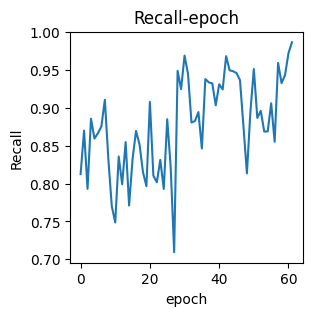

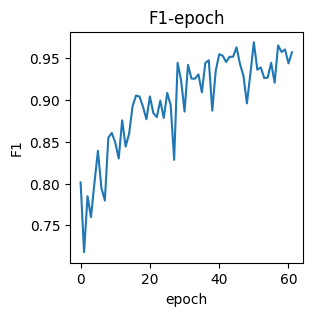

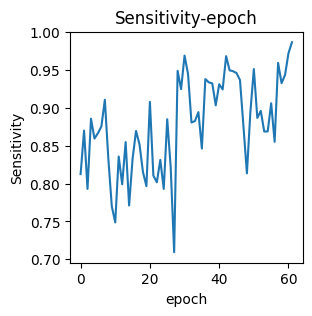

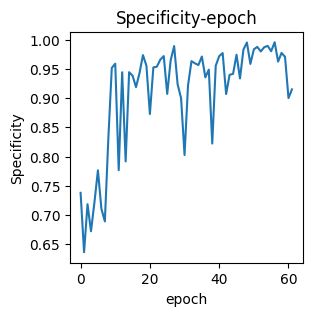

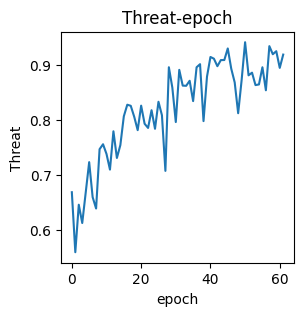

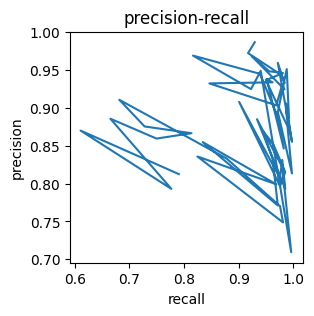

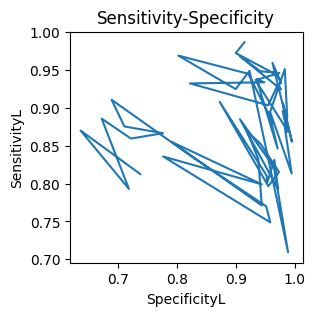

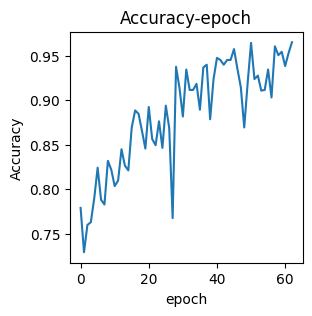

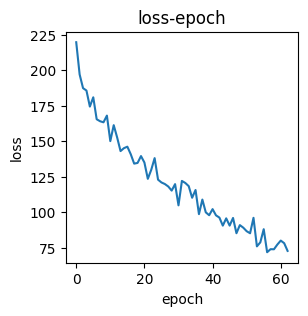

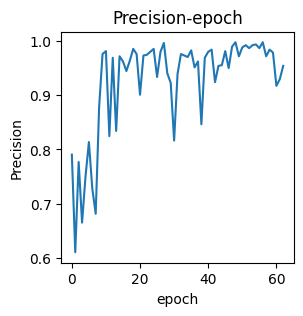

valid epoch[64/70]: 100%|██████████| 326/326 [00:06<00:00, 51.37it/s]
[epoch 64] loss: 0.280  accuracy: 0.949  Precision: 0.988  Recall: 0.926  F1: 0.955892  Sensitivity: 0.926  Specificity: 0.983  Threat: 0.916


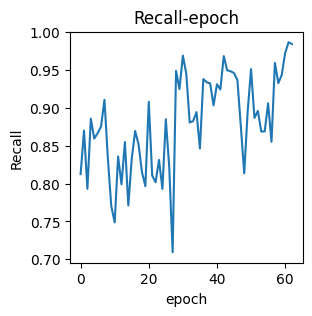

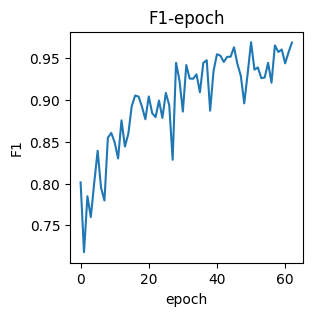

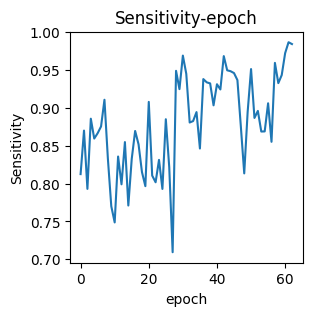

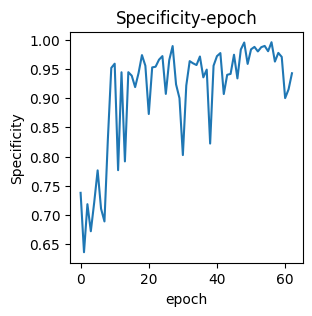

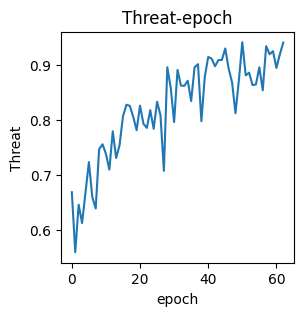

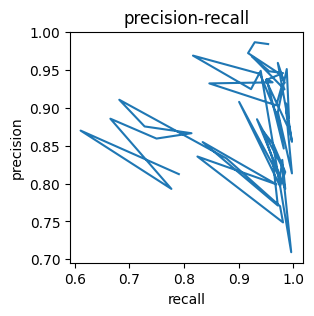

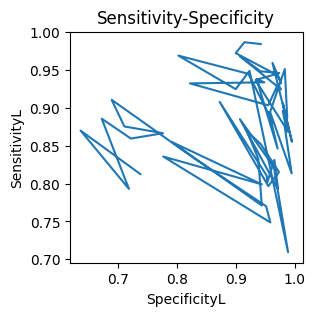

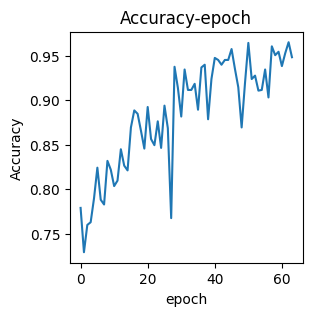

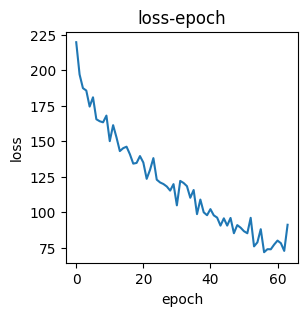

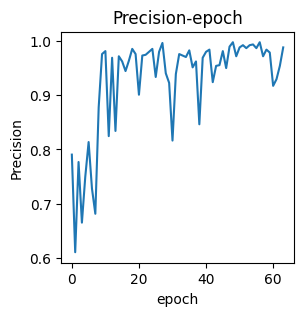

valid epoch[65/70]: 100%|██████████| 326/326 [00:06<00:00, 49.55it/s]
[epoch 65] loss: 0.221  accuracy: 0.941  Precision: 0.992  Recall: 0.911  F1: 0.949837  Sensitivity: 0.911  Specificity: 0.988  Threat: 0.904


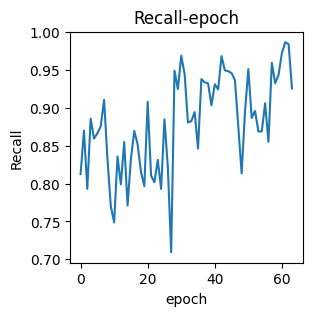

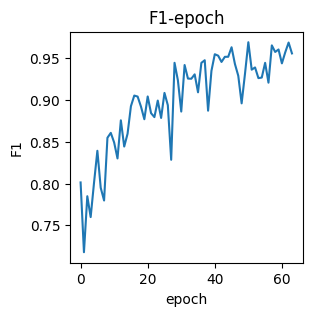

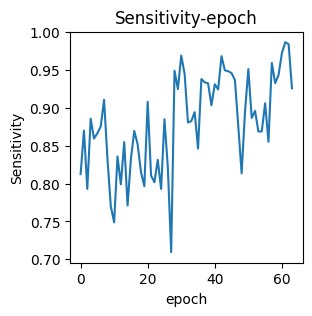

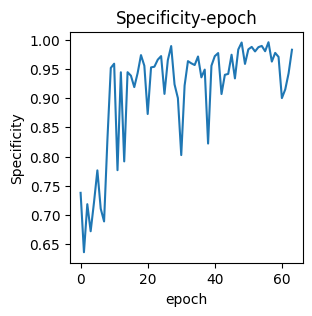

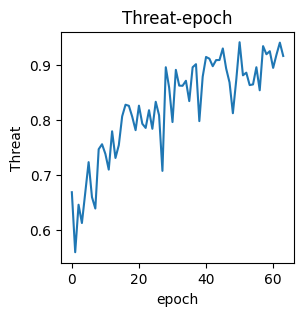

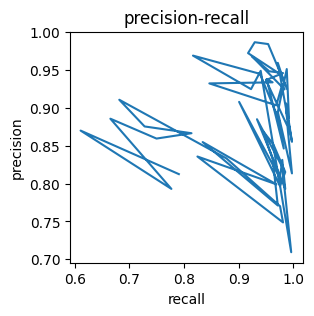

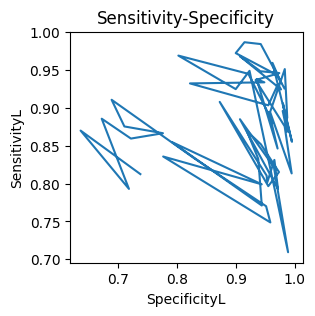

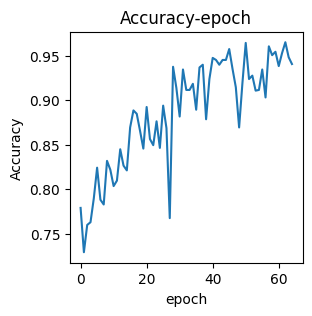

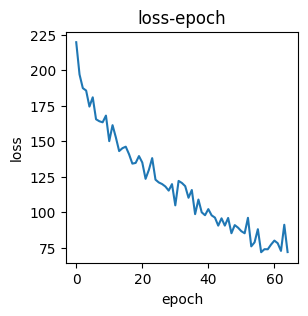

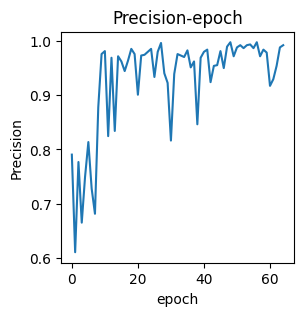

valid epoch[66/70]: 100%|██████████| 326/326 [00:06<00:00, 51.49it/s]
[epoch 66] loss: 0.248  accuracy: 0.899  Precision: 0.997  Recall: 0.849  F1: 0.917397  Sensitivity: 0.849  Specificity: 0.995  Threat: 0.847


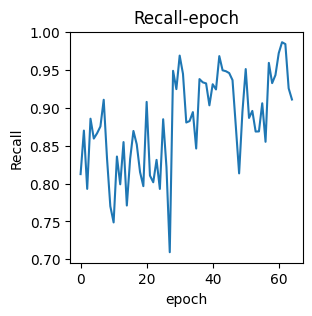

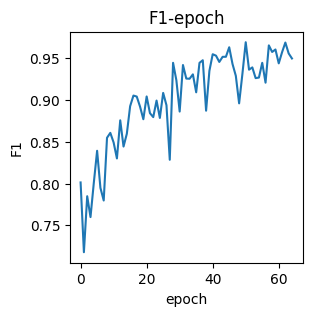

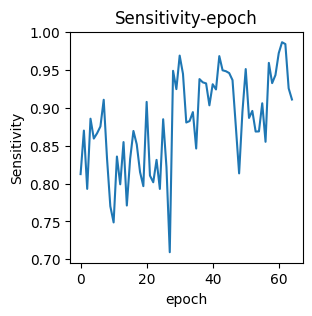

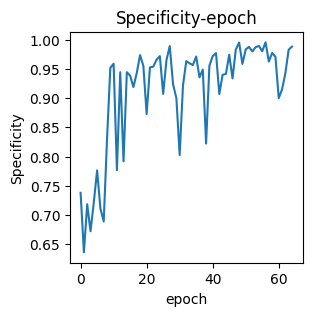

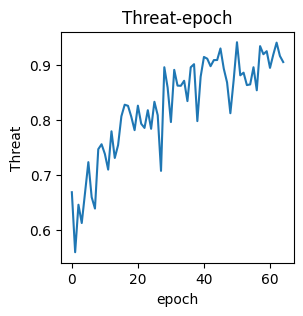

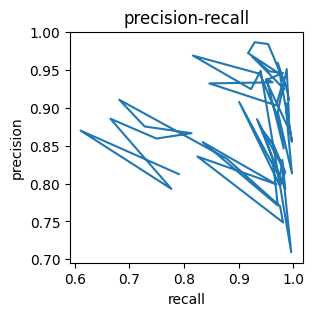

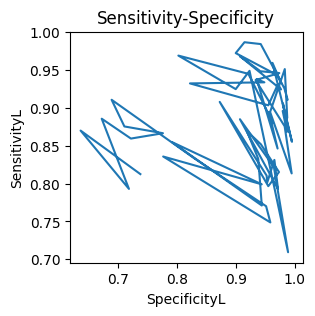

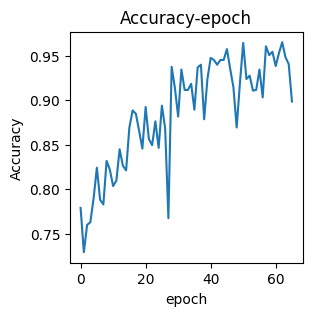

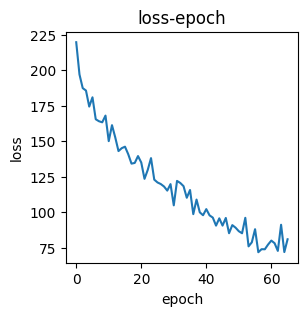

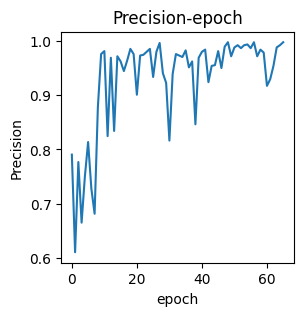

valid epoch[67/70]: 100%|██████████| 326/326 [00:06<00:00, 51.06it/s]
[epoch 67] loss: 0.230  accuracy: 0.940  Precision: 0.984  Recall: 0.916  F1: 0.948819  Sensitivity: 0.916  Specificity: 0.977  Threat: 0.903


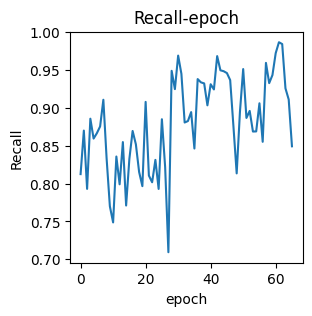

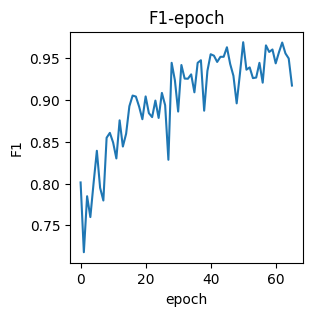

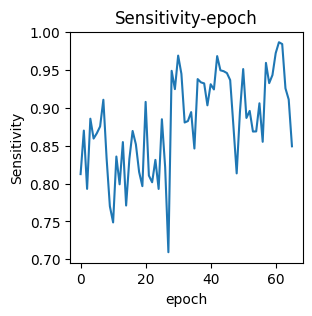

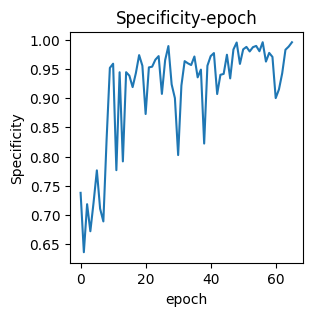

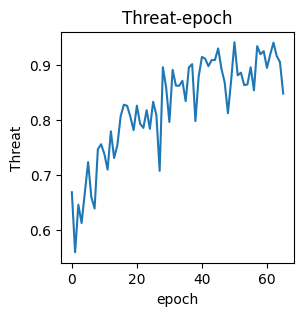

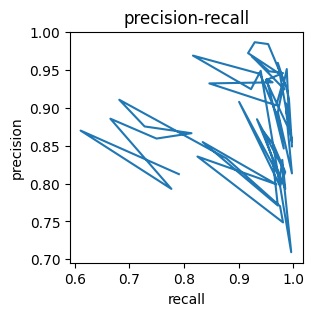

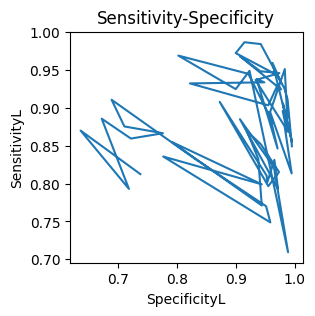

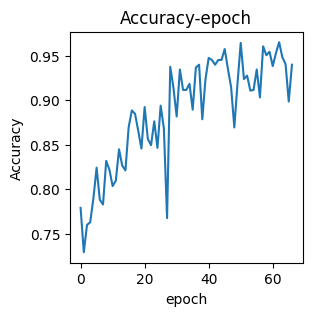

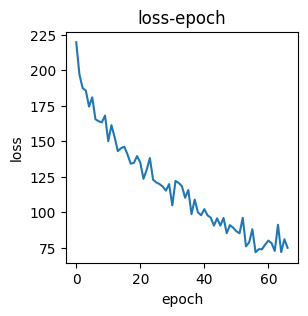

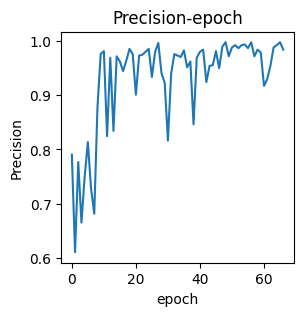

valid epoch[68/70]: 100%|██████████| 326/326 [00:06<00:00, 50.77it/s]
[epoch 68] loss: 0.212  accuracy: 0.943  Precision: 0.993  Recall: 0.914  F1: 0.951760  Sensitivity: 0.914  Specificity: 0.990  Threat: 0.908


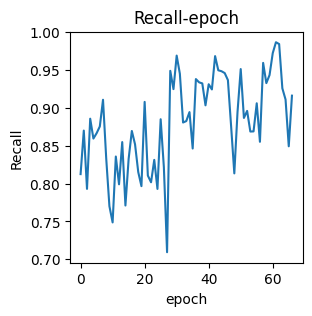

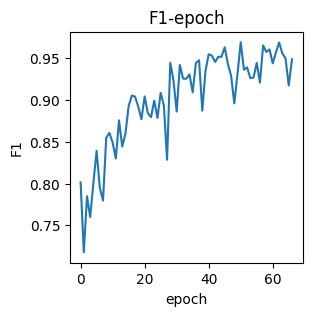

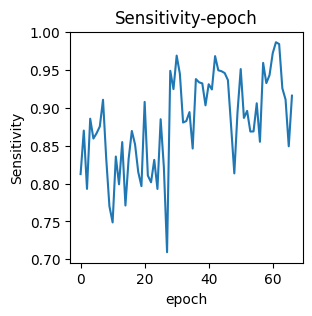

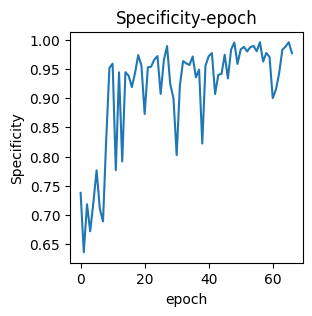

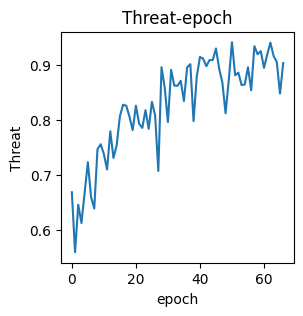

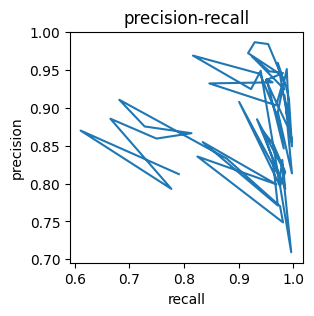

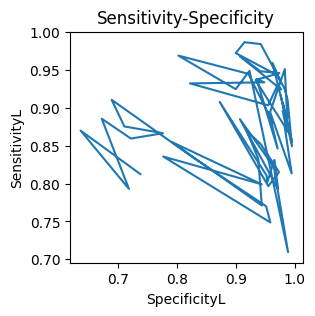

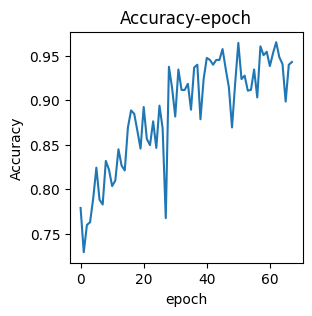

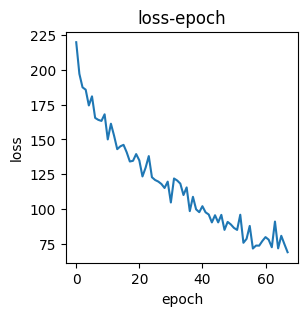

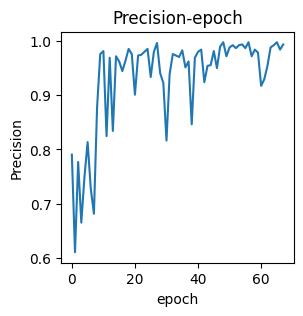

valid epoch[69/70]: 100%|██████████| 326/326 [00:06<00:00, 50.85it/s]
[epoch 69] loss: 0.208  accuracy: 0.949  Precision: 0.992  Recall: 0.924  F1: 0.956693  Sensitivity: 0.924  Specificity: 0.988  Threat: 0.917


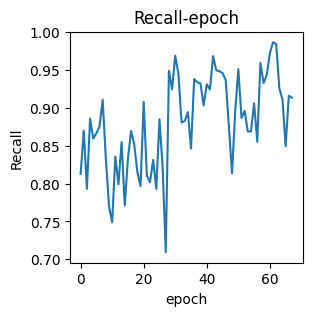

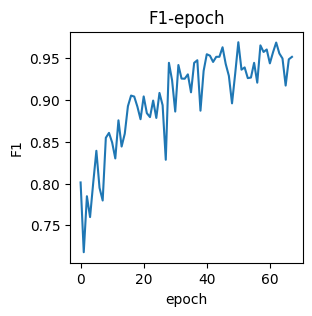

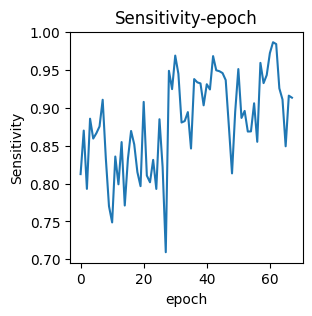

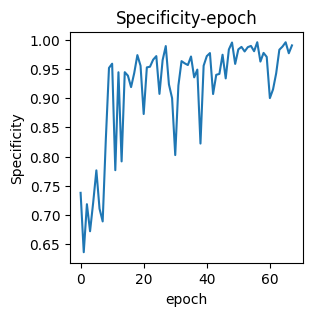

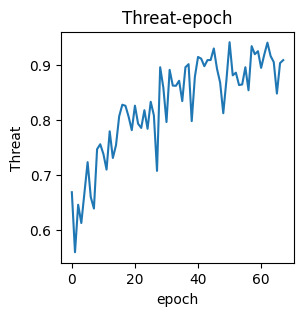

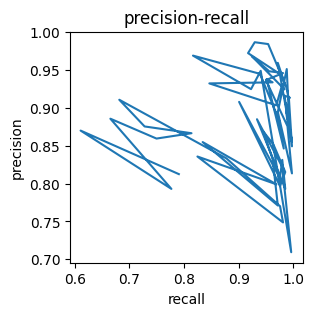

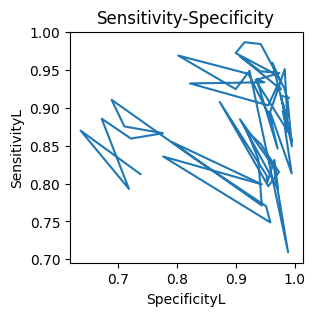

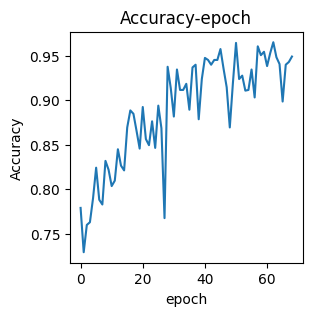

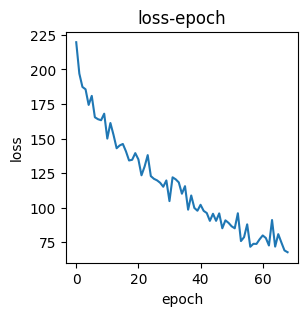

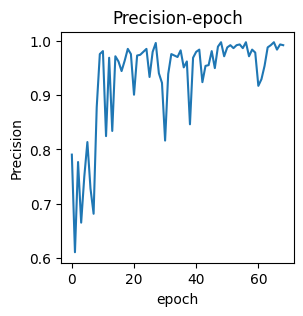

valid epoch[70/70]: 100%|██████████| 326/326 [00:06<00:00, 49.37it/s]
[epoch 70] loss: 0.214  accuracy: 0.957  Precision: 0.984  Recall: 0.943  F1: 0.962716  Sensitivity: 0.943  Specificity: 0.978  Threat: 0.928


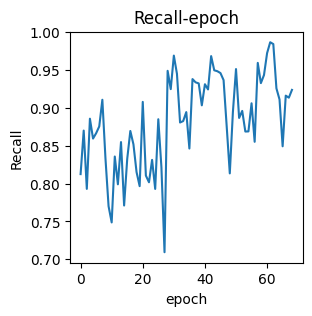

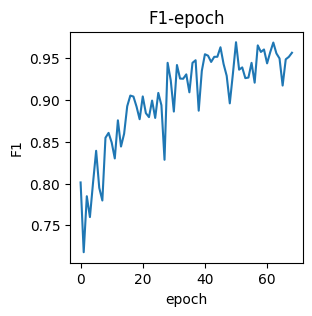

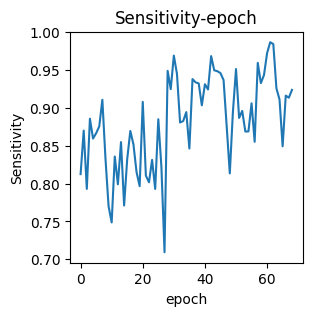

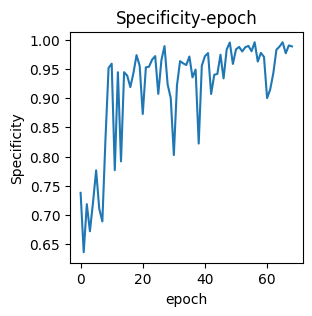

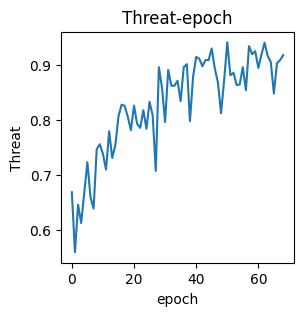

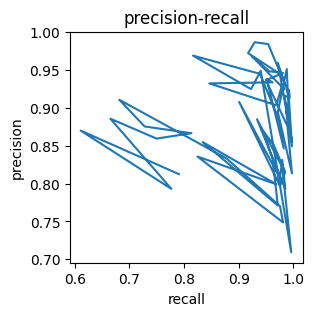

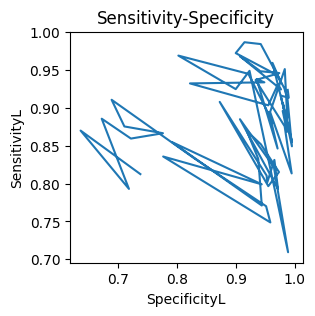

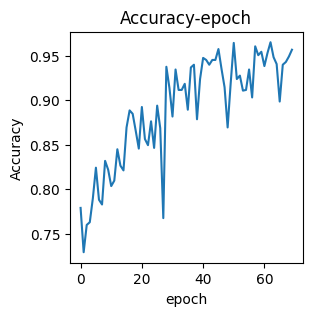

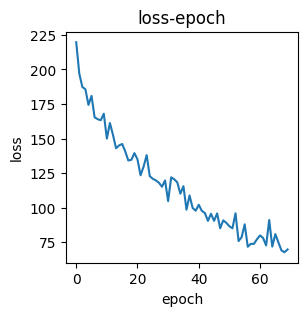

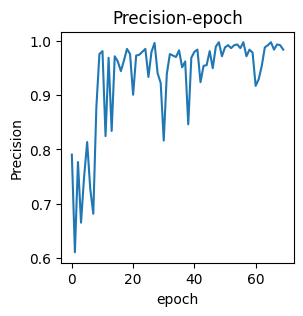

Finished Training


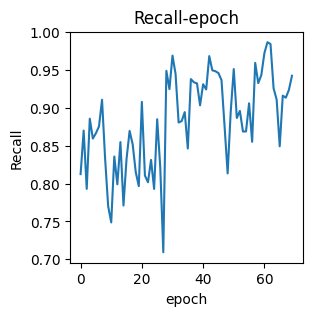

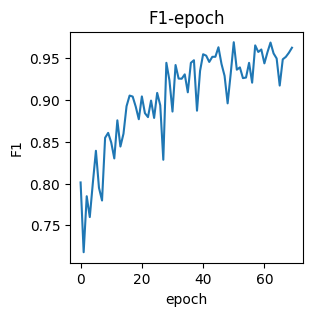

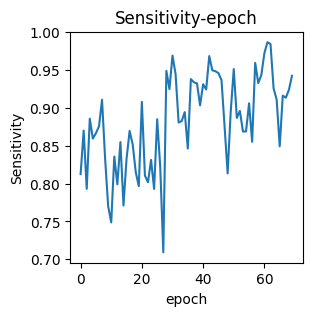

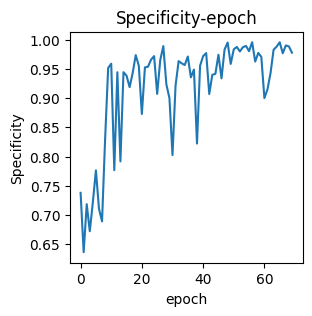

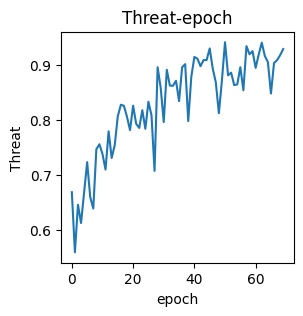

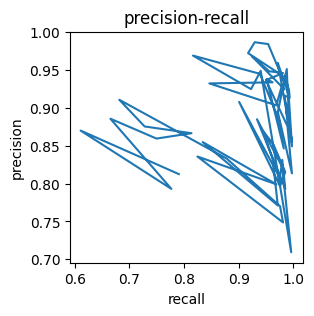

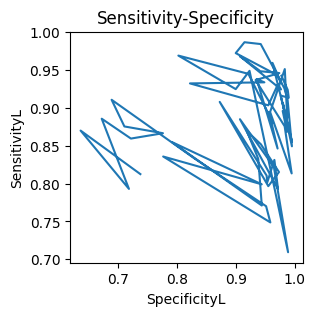

In [14]:
if __name__ == '__main__':
    main()
